In [1]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'DejaVu Sans'
import pyart

from matplotlib.dates import date2num
import matplotlib.dates as mdates
import matplotlib.patches as mpatches
from datetime import datetime
import xarray as xr
import netCDF4 as nc
import glob
import math
import subprocess
from matplotlib import colormaps
import plotly.graph_objs as go

import cartopy.crs as ccrs
import cartopy.feature as cfeature

import seaborn as sns
import csv
import pandas as pd
from scipy.optimize import curve_fit
from math import prod

import numpy as np
import matplotlib.pyplot as plt
from metpy.plots import SkewT
from metpy.units import units
from metpy.calc import dewpoint_from_relative_humidity
#from metpy.io import get_test_data

import sys, os
import requests

import warnings
warnings.simplefilter("ignore", RuntimeWarning)
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)


## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



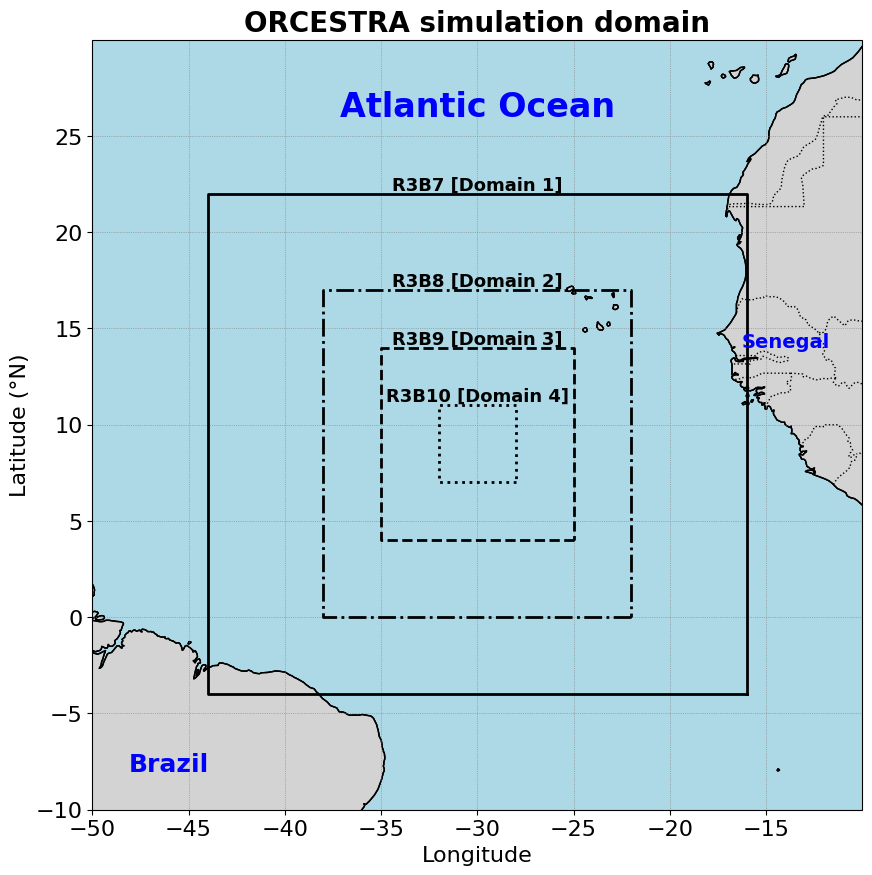

In [2]:
## ORCESTRA 3 Sept 2024 domain

lon1 = [-16., -44.];
lat1 = [-4., 22.];

lon2 = [-22., -38.];
lat2 = [-0., 17.];
#lat2 = [-0.85, 17.];

lon3 = [-25., -35.];
lat3 = [4, 14.];

lon4 = [-28., -32.];
lat4 = [7., 11.];


fig, ax = plt.subplots(figsize=(14, 10), subplot_kw={'projection': ccrs.PlateCarree()})

# Add coastlines and features for context
ax.coastlines(resolution='50m')
ax.add_feature(cfeature.BORDERS, linestyle=':')


ax.plot([lon1[0], lon1[1], lon1[1], lon1[0], lon1[0]], 
        [lat1[0], lat1[0], lat1[1], lat1[1], lat1[0]], 
        color='black', linewidth=2, linestyle='-', transform=ccrs.PlateCarree())

ax.plot([lon2[0], lon2[1], lon2[1], lon2[0], lon2[0]], 
        [lat2[0], lat2[0], lat2[1], lat2[1], lat2[0]], 
        color='black', linewidth=2, linestyle='-.', transform=ccrs.PlateCarree())

ax.plot([lon3[0], lon3[1], lon3[1], lon3[0], lon3[0]], 
        [lat3[0], lat3[0], lat3[1], lat3[1], lat3[0]], 
        color='black', linewidth=2, linestyle='--', transform=ccrs.PlateCarree())

ax.plot([lon4[0], lon4[1], lon4[1], lon4[0], lon4[0]], 
        [lat4[0], lat4[0], lat4[1], lat4[1], lat4[0]], 
        color='black', linewidth=2, linestyle=':', transform=ccrs.PlateCarree())

ax.text(-30., 22.2, "R3B7 [Domain 1]", transform=ccrs.PlateCarree(), fontsize=13, ha='center', color='k', fontweight='bold')
ax.text(-30., 17.2, "R3B8 [Domain 2]", transform=ccrs.PlateCarree(), fontsize=13, ha='center', color='k', fontweight='bold')
ax.text(-30., 14.2, "R3B9 [Domain 3]", transform=ccrs.PlateCarree(), fontsize=13, ha='center', color='k', fontweight='bold')
ax.text(-30., 11.2, "R3B10 [Domain 4]", transform=ccrs.PlateCarree(), fontsize=13, ha='center', color='k', fontweight='bold')

ax.set_xlim(-50., -10.)
ax.set_ylim(-10., 30.)
ax.set_xticks(range(-50, -10, 5))  
ax.set_yticks(range(-10, 30, 5))
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=16)
ax.set_xlabel("Longitude", fontsize=16)
ax.set_ylabel("Latitude (°N)", fontsize=16)
ax.grid(True, linestyle=':', linewidth=0.5, color='grey')
ax.set_title('ORCESTRA simulation domain', fontsize=20, fontweight='bold')

# Add oceans and continents features
ax.add_feature(cfeature.OCEAN, facecolor='lightblue')
ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='lightgray')

ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='lightgray')
ax.text(-30, 26, "Atlantic Ocean", transform=ccrs.PlateCarree(), fontsize=24, fontweight='bold', ha='center', color='blue')
ax.text(-14, 14, "Senegal", transform=ccrs.PlateCarree(), fontsize=14, fontweight='bold', ha='center', color='blue')
ax.text(-46, -8, "Brazil", transform=ccrs.PlateCarree(), fontsize=18, fontweight='bold', ha='center', color='blue')

plt.show()

In [63]:

file_path='/work/bk1415/b382718/output/orcestra/nested_run/icon_output/marine_ccn/latent_heat/sull_ds'
ds_4sip_new = xr.open_mfdataset(f'{file_path}/test_homhet/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc');
ds_4sip_old = xr.open_mfdataset(f'{file_path}/test_homhet_old/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc');


In [64]:

ds_4sip_new['w_vel'] = -1.*ds_4sip_new.omega/(9.8*ds_4sip_new.rho)
ds_4sip_new['tempc'] = ds_4sip_new.temp-273.16;
ds_4sip_new['lwc_gperm3']  = ds_4sip_new.qc*ds_4sip_new.rho*1.e3 # kgperm3 to gperm3
ds_4sip_new['tqi'] = ds_4sip_new.qi+ds_4sip_new.qs+ds_4sip_new.qg+ds_4sip_new.qh
ds_4sip_new['tq'] = ds_4sip_new.qc+ds_4sip_new.qi+ds_4sip_new.qs+ds_4sip_new.qg+ds_4sip_new.qh
ds_4sip_new['ciwc_gperm3'] = ds_4sip_new.qi*ds_4sip_new.rho*1.e3 # kgperm3 to gperm3
ds_4sip_new['tiwc_gperm3'] = (ds_4sip_new.qi+ds_4sip_new.qs+ds_4sip_new.qg+ds_4sip_new.qh)*ds_4sip_new.rho*1.e3 # kgperm3 to gperm3
ds_4sip_new['cdnc_percm3'] = ds_4sip_new.qnc*ds_4sip_new.rho*1.e-6  # perkg to percm3
ds_4sip_new['inc_perl'] = (ds_4sip_new.qni+ds_4sip_new.qns+ds_4sip_new.qng+ds_4sip_new.qnh)*ds_4sip_new.rho*1.e-3 # perkg to perl

ds_4sip_old['w_vel'] = -1.*ds_4sip_old.omega/(9.8*ds_4sip_old.rho)
ds_4sip_old['tempc'] = ds_4sip_old.temp-273.16;
ds_4sip_old['lwc_gperm3']  = ds_4sip_old.qc*ds_4sip_old.rho*1.e3 # kgperm3 to gperm3
ds_4sip_old['tqi'] = ds_4sip_old.qi+ds_4sip_old.qs+ds_4sip_old.qg+ds_4sip_old.qh
ds_4sip_old['tq'] = ds_4sip_old.qc+ds_4sip_old.qi+ds_4sip_old.qs+ds_4sip_old.qg+ds_4sip_old.qh
ds_4sip_old['ciwc_gperm3'] = ds_4sip_old.qi*ds_4sip_old.rho*1.e3 # kgperm3 to gperm3
ds_4sip_old['tiwc_gperm3'] = (ds_4sip_old.qi+ds_4sip_old.qs+ds_4sip_old.qg+ds_4sip_old.qh)*ds_4sip_old.rho*1.e3 # kgperm3 to gperm3
ds_4sip_old['cdnc_percm3'] = ds_4sip_old.qnc*ds_4sip_old.rho*1.e-6  # perkg to percm3
ds_4sip_old['inc_perl'] = (ds_4sip_old.qni+ds_4sip_old.qns+ds_4sip_old.qng+ds_4sip_old.qnh)*ds_4sip_old.rho*1.e-3 # perkg to perl


In [65]:
#ds_check

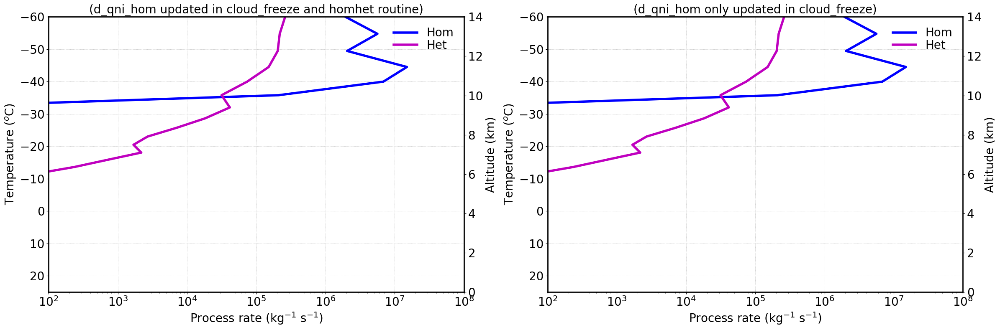

In [67]:

thres_q = 1.e-12
mean_d_qni_homhet_new = xr.where(ds_4sip_new.d_qni_homhet > thres_q, ds_4sip_new.d_qni_homhet, np.nan)
mean_d_qni_homhet_new = mean_d_qni_homhet_new.mean(dim=('time','ncells'))

mean_d_qni_hom_new = xr.where(ds_4sip_new.d_qni_hom > thres_q, ds_4sip_new.d_qni_hom, np.nan)
mean_d_qni_hom_new = mean_d_qni_hom_new.mean(dim=('time','ncells'))

mean_d_qni_het_new = xr.where(ds_4sip_new.d_qni_het > thres_q, ds_4sip_new.d_qni_het, np.nan)
mean_d_qni_het_new = mean_d_qni_het_new.mean(dim=('time','ncells'))

mean_d_qni_homhet_old = xr.where(ds_4sip_old.d_qni_homhet > thres_q, ds_4sip_old.d_qni_homhet, np.nan)
mean_d_qni_homhet_old = mean_d_qni_homhet_old.mean(dim=('time','ncells'))

mean_d_qni_hom_old = xr.where(ds_4sip_old.d_qni_hom > thres_q, ds_4sip_old.d_qni_hom, np.nan)
mean_d_qni_hom_old = mean_d_qni_hom_old.mean(dim=('time','ncells'))

mean_d_qni_het_old = xr.where(ds_4sip_old.d_qni_het > thres_q, ds_4sip_old.d_qni_het, np.nan)
mean_d_qni_het_old = mean_d_qni_het_old.mean(dim=('time','ncells'))

mean_tempc_old = ds_4sip_old.tempc.mean(dim=('time','ncells'))
mean_ht_old = ds_4sip_old.z_mc.mean(dim=('time','ncells'))

mean_tempc_new = ds_4sip_new.tempc.mean(dim=('time','ncells'))
mean_ht_new = ds_4sip_new.z_mc.mean(dim=('time','ncells'))


fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(24, 8))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
#plt1.plot(mean_d_qni_homhet_new, mean_tempc_new, 'c-', linewidth=lnwdth+3, label='Hom+het')
plt1.plot(mean_d_qni_hom_new, mean_tempc_new, 'b-', linewidth=lnwdth, label='Hom')
plt1.plot(mean_d_qni_het_new, mean_tempc_new, 'm-', linewidth=lnwdth, label='Het')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_d_qni_het_new, mean_tempc_new, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xscale('log')
plt1.set_xlim(1.e2, 1.e8)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([0, 10, 20, 30, 40])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('(d_qni_hom updated in cloud_freeze and homhet routine)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
#plt1.plot(mean_d_qni_homhet_old, mean_tempc_old, 'c-', linewidth=lnwdth+3, label='Hom+het')
plt1.plot(mean_d_qni_hom_old, mean_tempc_old, 'b-', linewidth=lnwdth, label='Hom')
plt1.plot(mean_d_qni_het_old, mean_tempc_old, 'm-', linewidth=lnwdth, label='Het')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_d_qni_het_old, mean_tempc_old, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xscale('log')
plt1.set_xlim(1.e2, 1.e8)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([0, 10, 20, 30, 40])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('(d_qni_hom only updated in cloud_freeze)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


In [2]:

file_path='/work/bk1415/b382718/output/orcestra/nested_run/icon_output/marine_ccn/latent_heat/sull_ds'
ds_4sip = xr.open_mfdataset(f'{file_path}/4sip/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc');
ds_nosip = xr.open_mfdataset(f'{file_path}/nosip/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc');
ds_norf = xr.open_mfdataset(f'{file_path}/norf/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc');
ds_nohm = xr.open_mfdataset(f'{file_path}/nohm/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc');
ds_nobr = xr.open_mfdataset(f'{file_path}/nobr/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc');
ds_nosb = xr.open_mfdataset(f'{file_path}/nosb/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc');


In [3]:

ds_nosip['w_vel'] = -1.*ds_nosip.omega/(9.8*ds_nosip.rho)
ds_nosip['tempc'] = ds_nosip.temp-273.16;
ds_nosip['lwc_gperm3']  = ds_nosip.qc*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['tqi'] = ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh
ds_nosip['tq'] = ds_nosip.qc+ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh
ds_nosip['ciwc_gperm3'] = ds_nosip.qi*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['tiwc_gperm3'] = (ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh)*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['twc_gperm3'] = (ds_nosip.qc+ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh)*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['cdnc_percm3'] = ds_nosip.qnc*ds_nosip.rho*1.e-6  # perkg to percm3
ds_nosip['inc_perl'] = (ds_nosip.qni+ds_nosip.qns+ds_nosip.qng+ds_nosip.qnh)*ds_nosip.rho*1.e-3 # perkg to perl

ds_4sip['w_vel'] = -1.*ds_4sip.omega/(9.8*ds_4sip.rho)
ds_4sip['tempc'] = ds_4sip.temp-273.16;
ds_4sip['lwc_gperm3']  = ds_4sip.qc*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['tqi'] = ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh
ds_4sip['tq'] = ds_4sip.qc+ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh
ds_4sip['ciwc_gperm3'] = ds_4sip.qi*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['tiwc_gperm3'] = (ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh)*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['twc_gperm3'] = (ds_4sip.qc+ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh)*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['cdnc_percm3'] = ds_4sip.qnc*ds_4sip.rho*1.e-6  # perkg to percm3
ds_4sip['inc_perl'] = (ds_4sip.qni+ds_4sip.qns+ds_4sip.qng+ds_4sip.qnh)*ds_4sip.rho*1.e-3 # perkg to perl

ds_norf['w_vel'] = -1.*ds_norf.omega/(9.8*ds_norf.rho)
ds_norf['tempc'] = ds_norf.temp-273.16;
ds_norf['lwc_gperm3']  = ds_norf.qc*ds_norf.rho*1.e3 # kgperm3 to gperm3
ds_norf['tqi'] = ds_norf.qi+ds_norf.qs+ds_norf.qg+ds_norf.qh
ds_norf['tq'] = ds_norf.qc+ds_norf.qi+ds_norf.qs+ds_norf.qg+ds_norf.qh
ds_norf['ciwc_gperm3'] = ds_norf.qi*ds_norf.rho*1.e3 # kgperm3 to gperm3
ds_norf['tiwc_gperm3'] = (ds_norf.qi+ds_norf.qs+ds_norf.qg+ds_norf.qh)*ds_norf.rho*1.e3 # kgperm3 to gperm3
ds_norf['twc_gperm3'] = (ds_norf.qc+ds_norf.qi+ds_norf.qs+ds_norf.qg+ds_norf.qh)*ds_norf.rho*1.e3 # kgperm3 to gperm3
ds_norf['cdnc_percm3'] = ds_norf.qnc*ds_norf.rho*1.e-6  # perkg to percm3
ds_norf['inc_perl'] = (ds_norf.qni+ds_norf.qns+ds_norf.qng+ds_norf.qnh)*ds_norf.rho*1.e-3 # perkg to perl

ds_nohm['w_vel'] = -1.*ds_nohm.omega/(9.8*ds_nohm.rho)
ds_nohm['tempc'] = ds_nohm.temp-273.16;
ds_nohm['lwc_gperm3']  = ds_nohm.qc*ds_nohm.rho*1.e3 # kgperm3 to gperm3
ds_nohm['tqi'] = ds_nohm.qi+ds_nohm.qs+ds_nohm.qg+ds_nohm.qh
ds_nohm['tq'] = ds_nohm.qc+ds_nohm.qi+ds_nohm.qs+ds_nohm.qg+ds_nohm.qh
ds_nohm['ciwc_gperm3'] = ds_nohm.qi*ds_nohm.rho*1.e3 # kgperm3 to gperm3
ds_nohm['tiwc_gperm3'] = (ds_nohm.qi+ds_nohm.qs+ds_nohm.qg+ds_nohm.qh)*ds_nohm.rho*1.e3 # kgperm3 to gperm3
ds_nohm['twc_gperm3'] = (ds_nohm.qc+ds_nohm.qi+ds_nohm.qs+ds_nohm.qg+ds_nohm.qh)*ds_nohm.rho*1.e3 # kgperm3 to gperm3
ds_nohm['cdnc_percm3'] = ds_nohm.qnc*ds_nohm.rho*1.e-6  # perkg to percm3
ds_nohm['inc_perl'] = (ds_nohm.qni+ds_nohm.qns+ds_nohm.qng+ds_nohm.qnh)*ds_nohm.rho*1.e-3 # perkg to perl

ds_nobr['w_vel'] = -1.*ds_nobr.omega/(9.8*ds_nobr.rho)
ds_nobr['tempc'] = ds_nobr.temp-273.16;
ds_nobr['lwc_gperm3']  = ds_nobr.qc*ds_nobr.rho*1.e3 # kgperm3 to gperm3
ds_nobr['tqi'] = ds_nobr.qi+ds_nobr.qs+ds_nobr.qg+ds_nobr.qh
ds_nobr['tq'] = ds_nobr.qc+ds_nobr.qi+ds_nobr.qs+ds_nobr.qg+ds_nobr.qh
ds_nobr['ciwc_gperm3'] = ds_nobr.qi*ds_nobr.rho*1.e3 # kgperm3 to gperm3
ds_nobr['tiwc_gperm3'] = (ds_nobr.qi+ds_nobr.qs+ds_nobr.qg+ds_nobr.qh)*ds_nobr.rho*1.e3 # kgperm3 to gperm3
ds_nobr['twc_gperm3'] = (ds_nobr.qc+ds_nobr.qi+ds_nobr.qs+ds_nobr.qg+ds_nobr.qh)*ds_nobr.rho*1.e3 # kgperm3 to gperm3
ds_nobr['cdnc_percm3'] = ds_nobr.qnc*ds_nobr.rho*1.e-6  # perkg to percm3
ds_nobr['inc_perl'] = (ds_nobr.qni+ds_nobr.qns+ds_nobr.qng+ds_nobr.qnh)*ds_nobr.rho*1.e-3 # perkg to perl

ds_nosb['w_vel'] = -1.*ds_nosb.omega/(9.8*ds_nosb.rho)
ds_nosb['tempc'] = ds_nosb.temp-273.16;
ds_nosb['lwc_gperm3']  = ds_nosb.qc*ds_nosb.rho*1.e3 # kgperm3 to gperm3
ds_nosb['tqi'] = ds_nosb.qi+ds_nosb.qs+ds_nosb.qg+ds_nosb.qh
ds_nosb['tq'] = ds_nosb.qc+ds_nosb.qi+ds_nosb.qs+ds_nosb.qg+ds_nosb.qh
ds_nosb['ciwc_gperm3'] = ds_nosb.qi*ds_nosb.rho*1.e3 # kgperm3 to gperm3
ds_nosb['tiwc_gperm3'] = (ds_nosb.qi+ds_nosb.qs+ds_nosb.qg+ds_nosb.qh)*ds_nosb.rho*1.e3 # kgperm3 to gperm3
ds_nosb['twc_gperm3'] = (ds_nosb.qc+ds_nosb.qi+ds_nosb.qs+ds_nosb.qg+ds_nosb.qh)*ds_nosb.rho*1.e3 # kgperm3 to gperm3
ds_nosb['cdnc_percm3'] = ds_nosb.qnc*ds_nosb.rho*1.e-6  # perkg to percm3
ds_nosb['inc_perl'] = (ds_nosb.qni+ds_nosb.qns+ds_nosb.qng+ds_nosb.qnh)*ds_nosb.rho*1.e-3 # perkg to perl


In [4]:

grid_orc = xr.open_mfdataset('/work/bk1415/b382718/output/orcestra/nested_run/icon_output/marine_ccn/latent_heat/control/orcestra_2mom_sip/domain4_DOM04.nc');


clon_deg = np.degrees(grid_orc.clon)
clat_deg = np.degrees(grid_orc.clat)

print(clon_deg.min().values); print(clon_deg.max().values);
print(clat_deg.min().values); print(clat_deg.max().values);

okla_x, okla_y = np.array([-30., 9.])
#print(okla_x), print(okla_y)
dx_deg = 2.; dy_deg = 2.0
left_bound = okla_x - dx_deg
right_bound = okla_x + dx_deg
top_bound = okla_y + dy_deg
bottom_bound = okla_y - dy_deg

print(left_bound), print(right_bound)
print(top_bound), print(bottom_bound)

-32.03759442634206
-27.96236307373933
6.967468001138239
11.031985309167817
-32.0
-28.0
11.0
7.0


(None, None)

In [5]:

window_cell = (
    (grid_orc.clat >= np.deg2rad(bottom_bound))
    & (grid_orc.clat <= np.deg2rad(top_bound))
    & (grid_orc.clon >= np.deg2rad(left_bound))
    & (grid_orc.clon <= np.deg2rad(right_bound))
).values

(window_cell_indices,) = np.where(window_cell)


# select cells matching with the area of interest (windows_cell_indices:: matching to that with the area sampled by the aircraft)
window_vertex_indices = (np.unique(grid_orc.vertex_of_cell.isel(cell=window_cell_indices).values) - 1)
print('window_vertex_indices ::',window_vertex_indices)

# select edges matching with the area of interest (corresponding to the windows_cell_indices)
window_edge_indices = (np.unique(grid_orc.edge_of_cell.isel(cell=window_cell_indices).values) - 1)
print('window_edge_indices ::',window_edge_indices)

selected_indices = xr.Dataset(
    {
        "cell": ("cell", window_cell_indices),
        "vertex": ("vertex", window_vertex_indices),
        "edge": ("edge", window_edge_indices),
    }
)

vars_to_renumber = {
    "cell": [
        "adjacent_cell_of_edge",
        "cells_of_vertex",
        "neighbor_cell_index",
    ],
    "vertex": ["vertex_of_cell", "edge_vertices", "vertices_of_vertex"],
    "edge": ["edge_of_cell", "edges_of_vertex"],
}


def reindex_grid(grid, indices, vars_to_renumber):
    new_grid = grid.load().isel(
        cell=indices.cell, vertex=indices.vertex, edge=indices.edge
    )
    for dim, idx in indices.coords.items():
        renumbering = np.full(grid.dims[dim], -2, dtype="int")
        renumbering[idx] = np.arange(len(idx))
        for name in vars_to_renumber[dim]:
            new_grid[name].data = renumbering[new_grid[name].data - 1] + 1
    return new_grid



window_vertex_indices :: [    4     7    15 ... 37370 37371 37372]
window_edge_indices :: [    63     64     65 ... 111329 111330 111331]


In [6]:

new_grid_orc = reindex_grid(grid_orc, selected_indices, vars_to_renumber)
mask=np.isin(ds_4sip['ncells'], selected_indices.cell)

ds_nosip_new = ds_nosip.sel(ncells=mask)
ds_4sip_new = ds_4sip.sel(ncells=mask)
ds_norf_new = ds_norf.sel(ncells=mask)
ds_nohm_new = ds_nohm.sel(ncells=mask)
ds_nobr_new = ds_nobr.sel(ncells=mask)
ds_nosb_new = ds_nosb.sel(ncells=mask)


In [6]:

mean_ht_nosip = 1.e-3*ds_nosip.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

mean_ht_4sip = 1.e-3*ds_4sip.z_mc.mean(dim=('time','ncells'))
mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

mean_ht_norf = 1.e-3*ds_norf.z_mc.mean(dim=('time','ncells'))
mean_tempc_norf = ds_norf.tempc.mean(dim=('time','ncells'))

mean_ht_nohm = 1.e-3*ds_nohm.z_mc.mean(dim=('time','ncells'))
mean_tempc_nohm = ds_nohm.tempc.mean(dim=('time','ncells'))

mean_ht_nobr = 1.e-3*ds_nobr.z_mc.mean(dim=('time','ncells'))
mean_tempc_nobr = ds_nobr.tempc.mean(dim=('time','ncells'))

mean_ht_nosb = 1.e-3*ds_nosb.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosb = ds_nosb.tempc.mean(dim=('time','ncells'))


In [7]:

variables = [mean_tempc_nosip, mean_tempc_4sip, mean_tempc_norf, mean_tempc_nohm, mean_tempc_nobr, mean_tempc_nosb]
numpy_variables = [var.values for var in variables]

mean_tempc_nosip = numpy_variables[0]
mean_tempc_4sip = numpy_variables[1]
mean_tempc_norf = numpy_variables[2]
mean_tempc_nohm = numpy_variables[3]
mean_tempc_nobr = numpy_variables[4]
mean_tempc_nosb = numpy_variables[5]

variables = [mean_ht_nosip, mean_ht_4sip, mean_ht_norf, mean_ht_nohm, mean_ht_nobr, mean_ht_nosb]
numpy_variables = [var.values for var in variables]

mean_ht_nosip = numpy_variables[0]
mean_ht_4sip = numpy_variables[1]
mean_ht_norf = numpy_variables[2]
mean_ht_nohm = numpy_variables[3]
mean_ht_nobr = numpy_variables[4]
mean_ht_nosb = numpy_variables[5]

# Latent heating rate

In [8]:

w_thres = 2.
# Latent heating rate with No SIP
dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
#ds_nosip['lhr_kperd'] = xr.where((ds_nosip.lhr_kperd > -10.) & (ds_nosip.lhr_kperd < 20.), ds_nosip.lhr_kperd, np.nan)
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))
ds_nosip['lhr_kperd'] = (dims1, lhr_kperd_nosip)
ds_nosip['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nosip)

# Latent heating rate with 4-SIP
dims1 = ds_4sip.tempc.dims
dims = ds_4sip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
#ds_4sip['lhr_kperd'] = (dims, lhr_kperd_4sip)
#ds_4sip['lhr_kperd'] = xr.where((ds_4sip.lhr_kperd > -10.) & (ds_4sip.lhr_kperd < 20.), ds_4sip.lhr_kperd, np.nan)
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))
ds_4sip['lhr_kperd'] = (dims1, lhr_kperd_4sip)
ds_4sip['mean_lhr_kperd'] = (dims, mean_lhr_kperd_4sip)

# Latent heating rate with No Raindrop Shattering (RF)
dims1 = ds_norf.tempc.dims
dims2 = ds_norf.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_norf.tq > 1.e-6) & (ds_norf.w_vel > w_thres), ds_norf.d_lhr, np.nan)
lhr_kpers_norf = (1./1800.) * np.gradient(ds_norf.d_lhr, axis=0) # w.r.t. time
lhr_kperd_norf = lhr_kpers_norf * 86400.
#ds_norf['lhr_kperd'] = (dims, lhr_kperd_norf)
#ds_norf['lhr_kperd'] = xr.where((ds_norf.lhr_kperd > -10.) & (ds_norf.lhr_kperd < 20.), ds_norf.lhr_kperd, np.nan)
mean_lhr_kperd_norf = np.mean(lhr_kperd_norf, axis=(0,2))
ds_norf['lhr_kperd'] = (dims1, lhr_kperd_norf)
ds_norf['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_norf)

# Latent heating rate with No Hallett-Mossop (HM)
dims1 = ds_nohm.tempc.dims
dims2 = ds_nohm.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nohm.tq > 1.e-6) & (ds_nohm.w_vel > w_thres), ds_nohm.d_lhr, np.nan)
lhr_kpers_nohm = (1./1800.) * np.gradient(ds_nohm.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nohm = lhr_kpers_nohm * 86400.
#ds_nohm['lhr_kperd'] = (dims, lhr_kperd_nohm)
#ds_nohm['lhr_kperd'] = xr.where((ds_nohm.lhr_kperd > -10.) & (ds_nohm.lhr_kperd < 20.), ds_nohm.lhr_kperd, np.nan)
mean_lhr_kperd_nohm = np.mean(lhr_kperd_nohm, axis=(0,2))
ds_nohm['lhr_kperd'] = (dims1, lhr_kperd_nohm)
ds_nohm['mean_lhr_kperd'] = (dims, mean_lhr_kperd_nohm)

# Latent heating rate with No ice-ice collision breakup (BR)
dims1 = ds_nobr.tempc.dims
dims2 = ds_nobr.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nobr.tq > 1.e-6) & (ds_nobr.w_vel > w_thres), ds_nobr.d_lhr, np.nan)
lhr_kpers_nobr = (1./1800.) * np.gradient(ds_nobr.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nobr = lhr_kpers_nobr * 86400.
#ds_nobr['lhr_kperd'] = (dims, lhr_kperd_nobr)
#ds_nobr['lhr_kperd'] = xr.where((ds_nobr.lhr_kperd > -10.) & (ds_nobr.lhr_kperd < 20.), ds_nobr.lhr_kperd, np.nan)
mean_lhr_kperd_nobr = np.mean(lhr_kperd_nobr, axis=(0,2))
ds_nobr['lhr_kperd'] = (dims1, lhr_kperd_nobr)
ds_nobr['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nobr)

# Latent heating rate with No Sublimation (SB)
dims1 = ds_nosb.tempc.dims
dims2 = ds_nosb.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nosb.tq > 1.e-6) & (ds_nosb.w_vel > w_thres), ds_nosb.d_lhr, np.nan)
lhr_kpers_nosb = (1./1800.) * np.gradient(ds_nosb.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosb = lhr_kpers_nosb * 86400.
#ds_nosb['lhr_kperd'] = (dims, lhr_kperd_nosb)
#ds_nosb['lhr_kperd'] = xr.where((ds_nosb.lhr_kperd > -10.) & (ds_nosb.lhr_kperd < 20.), ds_nosb.lhr_kperd, np.nan)
mean_lhr_kperd_nosb = np.mean(lhr_kperd_nosb, axis=(0,2))
ds_nosb['lhr_kperd'] = (dims1, lhr_kperd_nosb)
ds_nosb['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nosb)

# Change in lhr w.r.t. control
del_lhr_kperd_norf = mean_lhr_kperd_4sip-mean_lhr_kperd_norf
del_lhr_kperd_nohm = mean_lhr_kperd_4sip-mean_lhr_kperd_nohm
del_lhr_kperd_nobr = mean_lhr_kperd_4sip-mean_lhr_kperd_nobr
del_lhr_kperd_nosb = mean_lhr_kperd_4sip-mean_lhr_kperd_nosb
del_lhr_kperd_nosip = mean_lhr_kperd_4sip-mean_lhr_kperd_nosip


In [ ]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_lhr_kperd_nosip, mean_lhr_kperd_4sip, mean_lhr_kperd_norf, mean_lhr_kperd_nohm, 
             mean_lhr_kperd_nobr, mean_lhr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_lhr_kperd_nosip = numpy_variables[0]
mean_lhr_kperd_4sip = numpy_variables[1]
mean_lhr_kperd_norf = numpy_variables[2]
mean_lhr_kperd_nohm = numpy_variables[3]
mean_lhr_kperd_nobr = numpy_variables[4]
mean_lhr_kperd_nosb = numpy_variables[5]


In [9]:



#mean_lhr_kperd_nosip[mean_tempc_nosip < -60] = np.nan
#mean_lhr_kperd_4sip[mean_tempc_4sip < -60] = np.nan
#mean_lhr_kperd_norf[mean_tempc_norf < -60] = np.nan
#mean_lhr_kperd_nohm[mean_tempc_nohm < -60] = np.nan
#mean_lhr_kperd_nobr[mean_tempc_nobr < -60] = np.nan
#mean_lhr_kperd_nosb[mean_tempc_nosb < -60] = np.nan

del_lhr_kperd_norf = mean_lhr_kperd_4sip-mean_lhr_kperd_norf
del_lhr_kperd_nohm = mean_lhr_kperd_4sip-mean_lhr_kperd_nohm
del_lhr_kperd_nobr = mean_lhr_kperd_4sip-mean_lhr_kperd_nobr
del_lhr_kperd_nosb = mean_lhr_kperd_4sip-mean_lhr_kperd_nosb
del_lhr_kperd_nosip = mean_lhr_kperd_4sip-mean_lhr_kperd_nosip

per_del_lhr_kperd_norf = 100*(del_lhr_kperd_norf)/mean_lhr_kperd_4sip
per_del_lhr_kperd_nohm = 100*(del_lhr_kperd_nohm)/mean_lhr_kperd_4sip
per_del_lhr_kperd_nobr = 100*(del_lhr_kperd_nobr)/mean_lhr_kperd_4sip
per_del_lhr_kperd_nosb = 100*(del_lhr_kperd_nosb)/mean_lhr_kperd_4sip
per_del_lhr_kperd_nosip = 100*(del_lhr_kperd_nosip)/mean_lhr_kperd_4sip


#per_del_lhr_kperd_nosip[(mean_tempc_nosip < -50) & (np.abs(per_del_lhr_kperd_nosip) > 50)] = np.nan
#per_del_lhr_kperd_norf[(mean_tempc_norf < -50) & (np.abs(per_del_lhr_kperd_norf) > 50)] = np.nan
#per_del_lhr_kperd_nohm[(mean_tempc_nohm < -50) & (np.abs(per_del_lhr_kperd_nohm) > 50)] = np.nan
#per_del_lhr_kperd_nobr[(mean_tempc_nobr < -50) & (np.abs(per_del_lhr_kperd_nobr) > 50)] = np.nan
#per_del_lhr_kperd_nosip[(mean_tempc_nosb < -50) & (np.abs(per_del_lhr_kperd_nosip) > 50)] = np.nan


In [10]:
print(mean_tempc_4sip)
print(mean_ht_4sip)

[-64.11463    -71.0595     -79.17266    -76.77152    -72.620636
 -68.711105   -64.192184   -58.8995     -53.580677   -48.532993
 -43.778416   -39.382874   -35.339413   -31.642221   -28.245401
 -25.187431   -22.452347   -19.996225   -17.65675    -15.365664
 -13.184917   -11.161037    -9.274622    -7.5398364   -5.9204917
  -4.3918433   -2.9827352   -1.66251     -0.40766516   0.74917555
   1.9210182    3.1262739    4.341495     5.5112567    6.62047
   7.685756     8.7003975    9.67859     10.628353    11.552832
  12.435058    13.263919    14.050942    14.816273    15.542435
  16.222034    16.879282    17.523832    18.146746    18.75318
  19.331327    19.88926     20.413582    20.91575     21.390892
  21.853464    22.300392    22.751839    23.197172    23.640087
  24.088024    24.53992     24.98477     25.388887    25.748495  ]
[2.07009220e+01 1.87076283e+01 1.74598427e+01 1.64322166e+01
 1.55380936e+01 1.47380772e+01 1.40097885e+01 1.33389053e+01
 1.27155104e+01 1.21323986e+01 1.15841084e

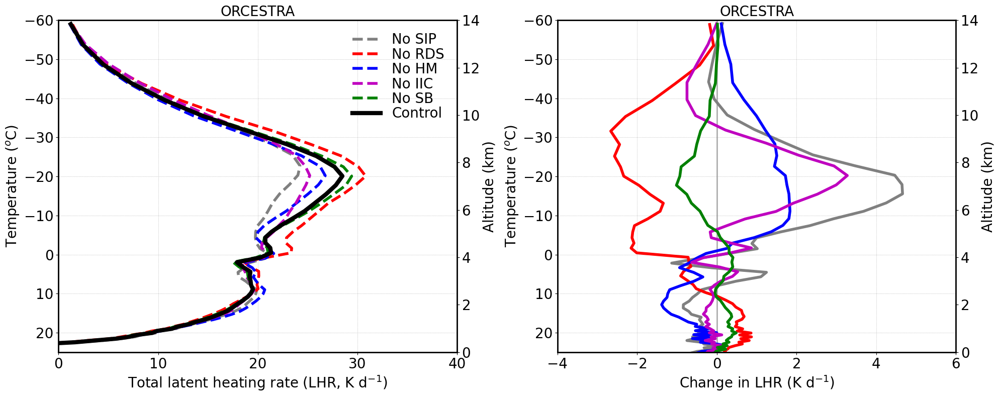

In [16]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_lhr_kperd_norf, mean_tempc_norf, 'r--', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_lhr_kperd_nohm, mean_tempc_nohm, 'b--', linewidth=lnwdth, label='No HM')
plt1.plot(mean_lhr_kperd_nobr, mean_tempc_nobr, 'm--', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt1.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='Control')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0, 40)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([0, 10, 20, 30, 40])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating rate (LHR, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(del_lhr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(del_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(del_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(del_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(del_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(del_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-4., 6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-4, -2, 0, 2, 4, 6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')

plt1.set_xlabel('Change in LHR (K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


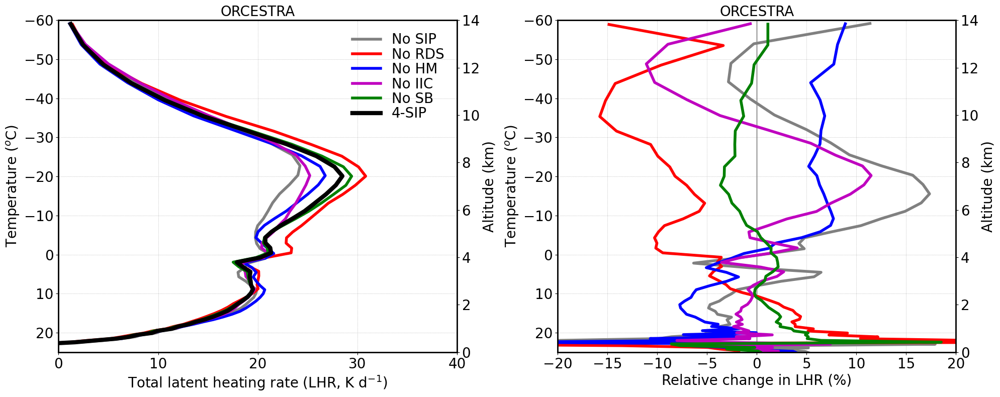

In [39]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0., 40)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([0, 10, 20, 30, 40])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating rate (LHR, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_lhr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-20., 20)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')

plt1.set_xlabel('Relative change in LHR (%)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


In [ ]:
plt.plot(mean_tempc_nosip, ds_nosip.height, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.grid()
plt.xlim(-70,30);
plt.xticks([-70, -60, -50, -40, -30, -20, -10, 0, 10, 20, 30]);
plt.ylim(10, 30)

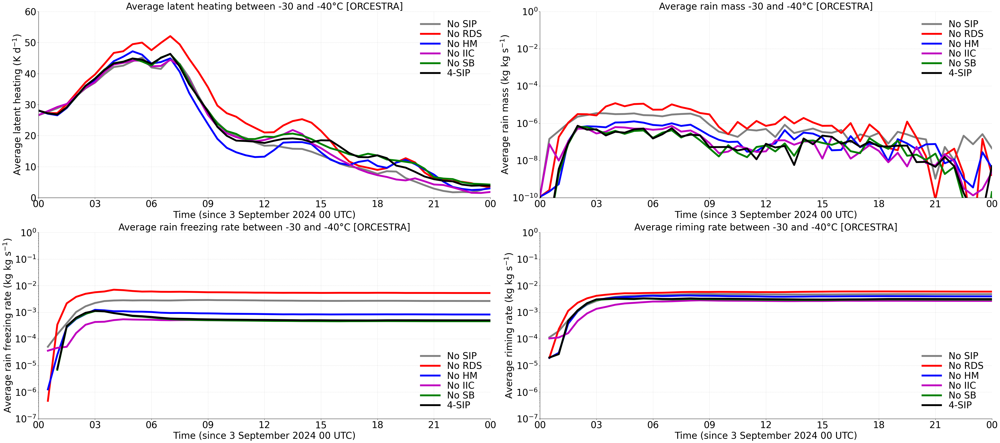

In [23]:

thres_q = 1.e-8;

## Latent heating
mean_lhr_min35_nosip = ds_nosip.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_lhr_min35_4sip = ds_4sip.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_norf = ds_norf.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_nohm = ds_nohm.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_nobr = ds_nobr.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_nosb = ds_nosb.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))

## Rain mass
mean_qr_min35_nosip = ds_nosip.qr.sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_qr_min35_4sip = ds_4sip.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_norf = ds_norf.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_nohm = ds_nohm.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_nobr = ds_nobr.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_nosb = ds_nosb.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))

## Riming rate
mean_dq_tot_rime_min35_4sip = xr.where(ds_4sip.d_qx_riming > thres_q, ds_4sip.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nosip = xr.where(ds_nosip.d_qx_riming > thres_q, ds_nosip.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_norf = xr.where(ds_norf.d_qx_riming > thres_q, ds_norf.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nohm = xr.where(ds_nohm.d_qx_riming > thres_q, ds_nohm.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nobr = xr.where(ds_nobr.d_qx_riming > thres_q, ds_nobr.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nosb = xr.where(ds_nosb.d_qx_riming > thres_q, ds_nosb.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

## Rain freezing rate
sum_dq = ds_4sip.d_qr_rf+ds_4sip.d_qs_rf+ds_4sip.d_qg_rf+ds_4sip.d_qh_rf
mean_dq_rainfreez_min35_4sip = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nosip.d_qr_rf+ds_nosip.d_qs_rf+ds_nosip.d_qg_rf+ds_nosip.d_qh_rf
mean_dq_rainfreez_min35_nosip = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_norf.d_qr_rf+ds_norf.d_qs_rf+ds_norf.d_qg_rf+ds_norf.d_qh_rf
mean_dq_rainfreez_min35_norf = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nohm.d_qr_rf+ds_nohm.d_qs_rf+ds_nohm.d_qg_rf+ds_nohm.d_qh_rf
mean_dq_rainfreez_min35_nohm = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nobr.d_qr_rf+ds_nobr.d_qs_rf+ds_nobr.d_qg_rf+ds_nobr.d_qh_rf
mean_dq_rainfreez_min35_nobr = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nosb.d_qr_rf+ds_nosb.d_qs_rf+ds_nosb.d_qg_rf+ds_nosb.d_qh_rf
mean_dq_rainfreez_min35_nosb = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))


plt.figure(figsize=(45, 20))

lnwdth=6
fontsize=30

plt.subplot(2,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_lhr_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_lhr_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_lhr_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_lhr_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_lhr_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_lhr_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0,60)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average latent heating (K d$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average latent heating between -30 and -40°C [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)


plt.subplot(2,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_qr_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_qr_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_qr_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_qr_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_qr_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_qr_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.yscale('log')
plt.xlim(start_date, end_date)
plt.ylim(1.e-10,1.e0)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average rain mass (kg kg s$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average rain mass -30 and -40°C [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)


plt.subplot(2,2,3)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_dq_rainfreez_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_dq_rainfreez_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_dq_rainfreez_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_dq_rainfreez_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_dq_rainfreez_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_dq_rainfreez_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.yscale('log')
plt.xlim(start_date, end_date)
plt.ylim(1.e-7,1.e0)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average rain freezing rate (kg kg s$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average rain freezing rate between -30 and -40°C [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)




plt.subplot(2,2,4)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_dq_tot_rime_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_dq_tot_rime_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_dq_tot_rime_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_dq_tot_rime_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_dq_tot_rime_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_dq_tot_rime_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.yscale('log')
plt.xlim(start_date, end_date)
plt.ylim(1.e-7,1.e0)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average riming rate (kg kg s$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average riming rate between -30 and -40°C [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

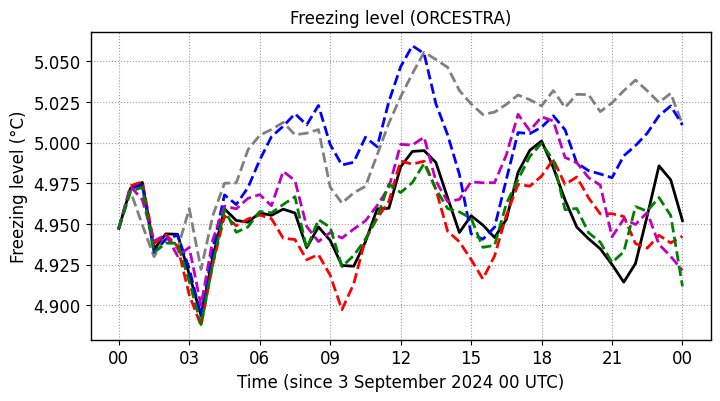

In [13]:

mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.2) & (ds_4sip.tempc < -38.)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.2) & (ds_nosip.tempc < -38.)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_norf.tempc > -0.2) & (ds_norf.tempc < 0.)
mean_freez_lev_norf = 1.e-3*(ds_norf.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_norf.tempc > -38.2) & (ds_norf.tempc < -38.)
mean_hom_lev_norf = 1.e-3*(ds_norf.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nohm.tempc > -0.2) & (ds_nohm.tempc < 0.)
mean_freez_lev_nohm = 1.e-3*(ds_nohm.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nohm.tempc > -38.2) & (ds_nohm.tempc < -38.)
mean_hom_lev_nohm = 1.e-3*(ds_nohm.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nobr.tempc > -0.2) & (ds_nobr.tempc < 0.)
mean_freez_lev_nobr = 1.e-3*(ds_nobr.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nobr.tempc > -38.2) & (ds_nobr.tempc < -38.)
mean_hom_lev_nobr = 1.e-3*(ds_nobr.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosb.tempc > -0.2) & (ds_nosb.tempc < 0.)
mean_freez_lev_nosb = 1.e-3*(ds_nosb.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosb.tempc > -38.2) & (ds_nosb.tempc < -38.)
mean_hom_lev_nosb = 1.e-3*(ds_nosb.z_mc.where(mask)).mean(dim=('height','ncells'))

fnt=12;
ln=2;
plt.figure(figsize=(8,4))
plt.style.use('default')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'k-', linewidth=ln, label='Control')
plt.plot(ds_nosip.time, mean_freez_lev_nosip, '--', color='grey', linewidth=ln, label='No SIP')
plt.plot(ds_norf.time, mean_freez_lev_norf, 'r--', linewidth=ln, label='No RDS')
plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln, label='No HM')
plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'm--', linewidth=ln, label='No IIC')
plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'g--', linewidth=ln, label='No SB')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
#plt.ylim(3.6, 4.4)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Freezing level (°C)', fontsize=fnt)
plt.title('Freezing level (ORCESTRA)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

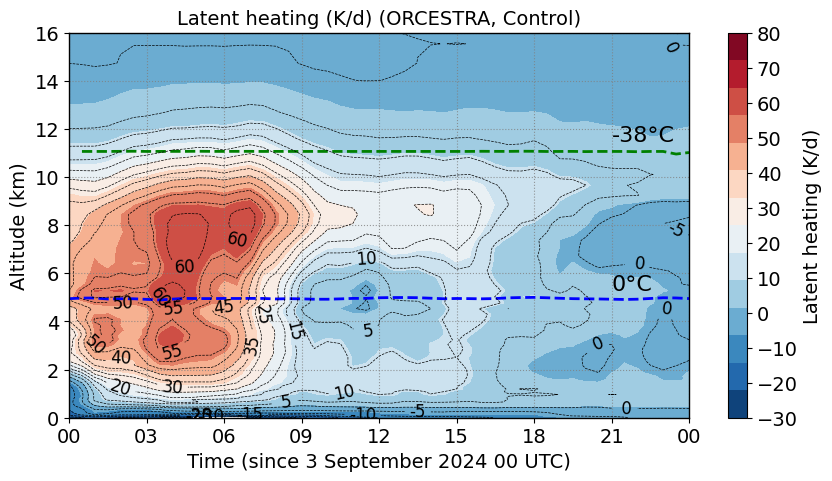

In [26]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'b--', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'g--', linewidth=ln)

plt.text(ds_4sip.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

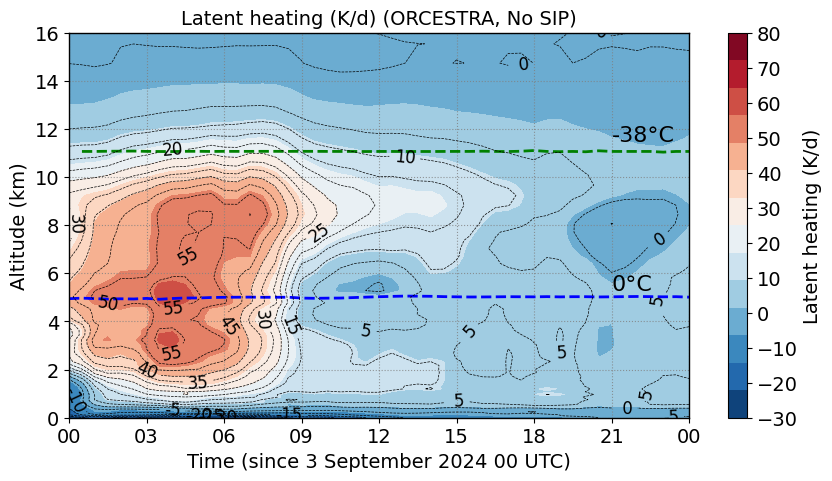

In [25]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'b--', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, 'g--', linewidth=ln)

plt.text(ds_nosip.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

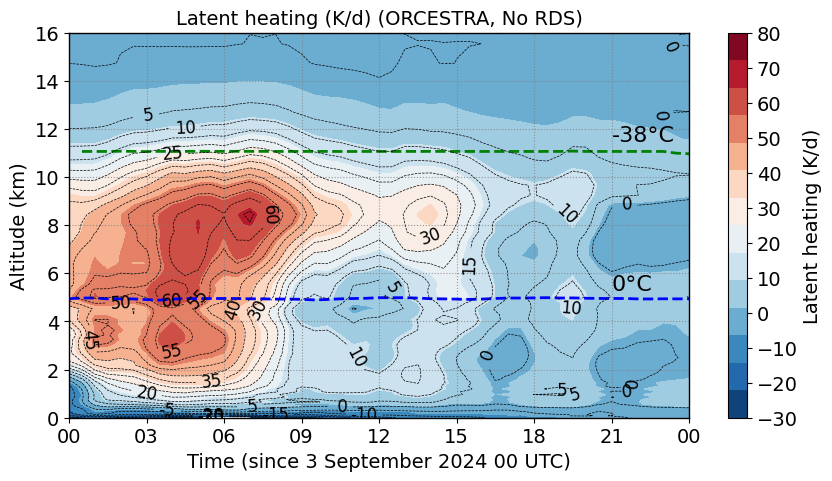

In [27]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_norf.time, mean_ht_norf, ds_norf.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_norf.time, mean_freez_lev_norf, 'b--', linewidth=ln)
plt.plot(ds_norf.time, mean_hom_lev_norf, 'g--', linewidth=ln)

plt.text(ds_norf.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_norf.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, No RDS)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_norf.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

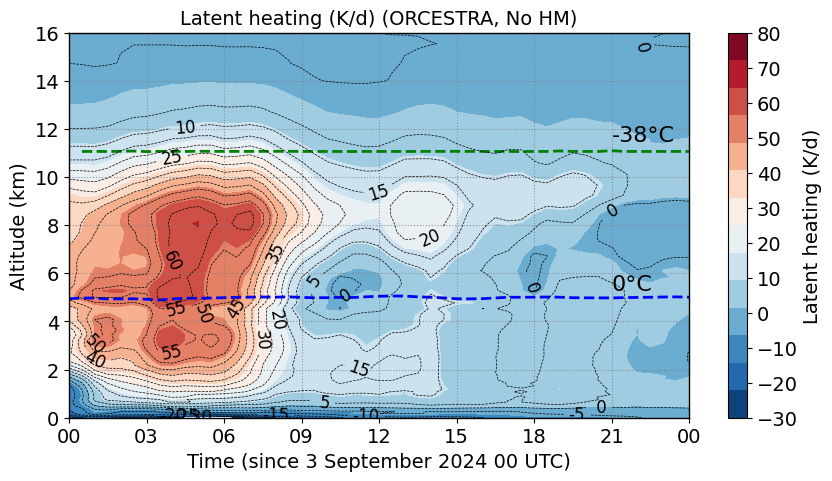

In [28]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nohm.time, mean_ht_nohm, ds_nohm.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln)
plt.plot(ds_nohm.time, mean_hom_lev_nohm, 'g--', linewidth=ln)

plt.text(ds_nohm.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nohm.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, No HM)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_nohm.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

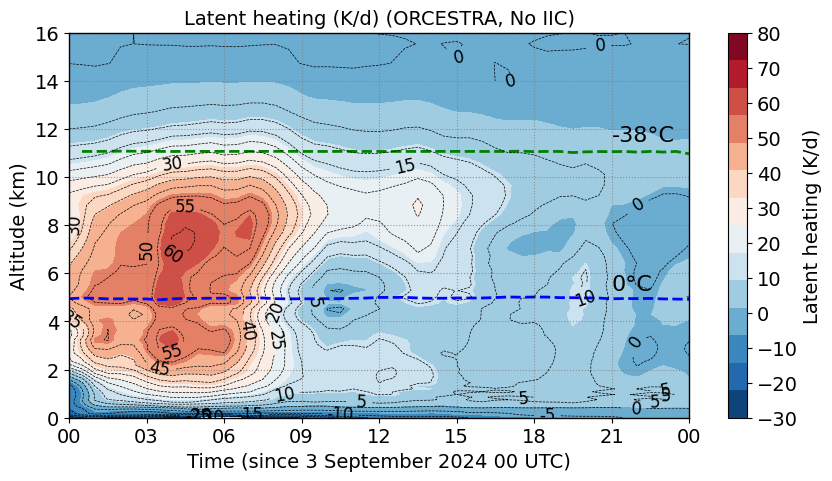

In [29]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nobr.time, mean_ht_nobr, ds_nobr.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'b--', linewidth=ln)
plt.plot(ds_nobr.time, mean_hom_lev_nobr, 'g--', linewidth=ln)

plt.text(ds_nobr.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nobr.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, No IIC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_nobr.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

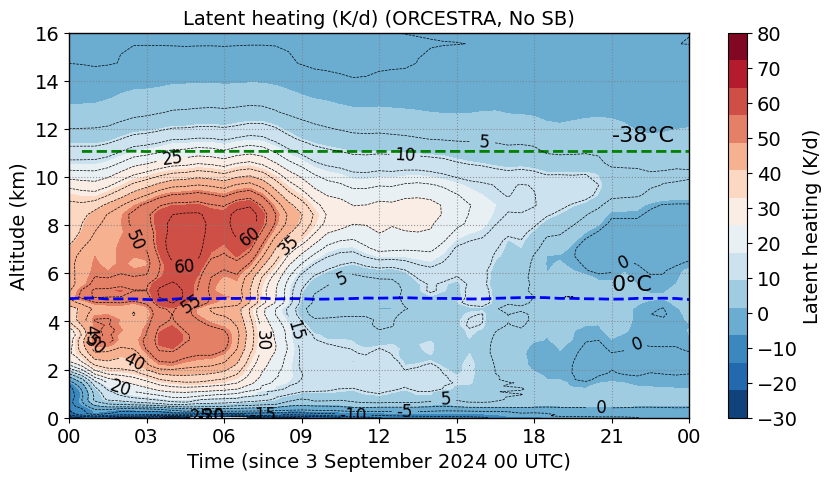

In [30]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosb.time, mean_ht_nosb, ds_nosb.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'b--', linewidth=ln)
plt.plot(ds_nosb.time, mean_hom_lev_nosb, 'g--', linewidth=ln)

plt.text(ds_nosb.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosb.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, No SB)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_nosb.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

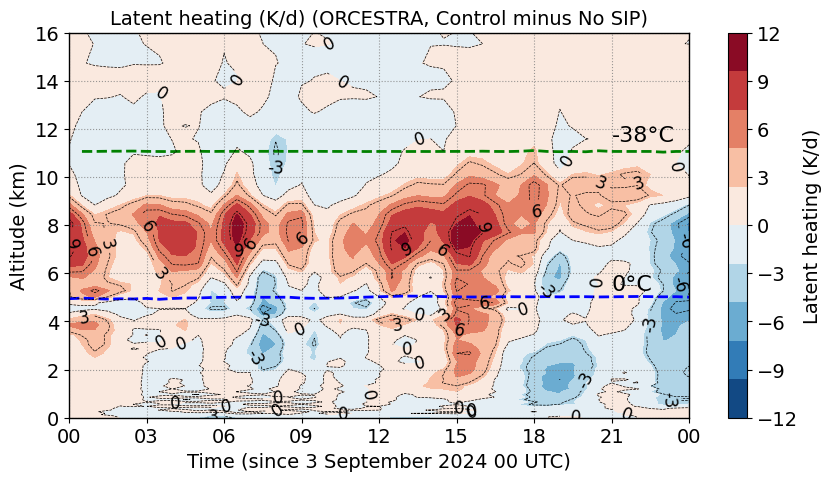

In [63]:
fnt=14;
ln=2;
lev = np.linspace(-12, 12, 11)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-12, -9, -6, -3, 0, 3, 6, 9, 12])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'b--', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, 'g--', linewidth=ln)

plt.text(ds_nosip.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-12, 12.5, 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosip.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

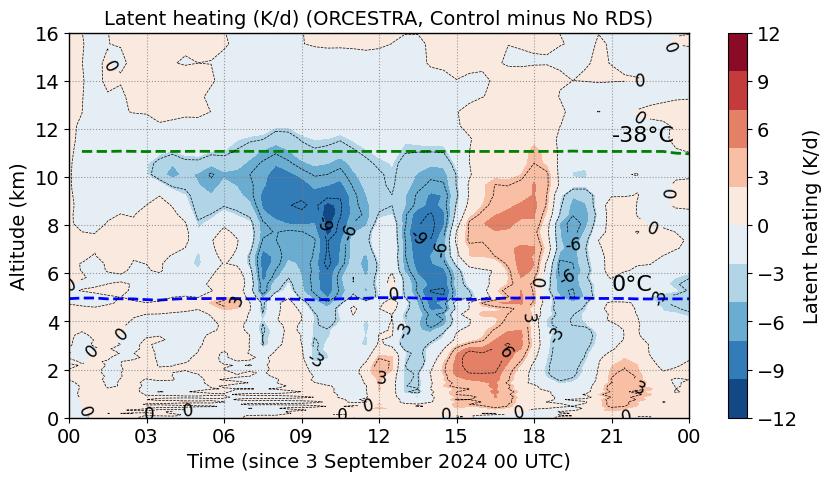

In [64]:
fnt=14;
ln=2;
lev = np.linspace(-12, 12, 11)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_norf.time, mean_ht_norf, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_norf.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-12, -9, -6, -3, 0, 3, 6, 9, 12])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_norf.time, mean_freez_lev_norf, 'b--', linewidth=ln)
plt.plot(ds_norf.time, mean_hom_lev_norf, 'g--', linewidth=ln)

plt.text(ds_norf.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_norf.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No RDS)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-12, 12.5, 3)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_norf.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

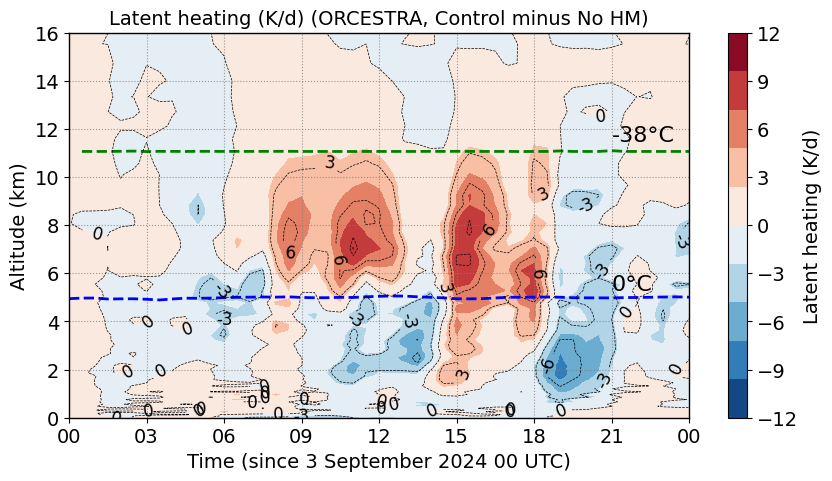

In [60]:
fnt=14;
ln=2;
lev = np.linspace(-12, 12, 11)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nohm.time, mean_ht_nohm, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nohm.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-12, -9, -6, -3, 0, 3, 6, 9, 12])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln)
plt.plot(ds_nohm.time, mean_hom_lev_nohm, 'g--', linewidth=ln)

plt.text(ds_nohm.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nohm.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No HM)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-12, 12.5, 3)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nohm.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

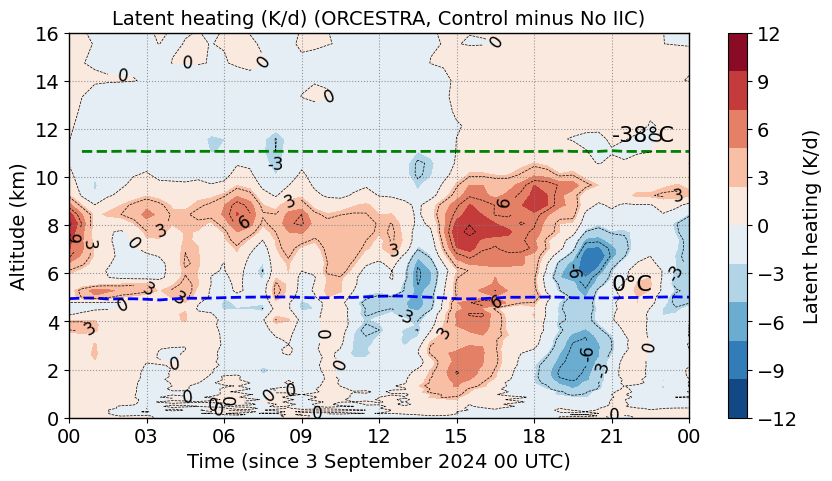

In [61]:
fnt=14;
ln=2;
lev = np.linspace(-12, 12, 11)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nobr.time, mean_ht_nobr, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nobr.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-12, -9, -6, -3, 0, 3, 6, 9, 12])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln)
plt.plot(ds_nohm.time, mean_hom_lev_nohm, 'g--', linewidth=ln)

plt.text(ds_nohm.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nohm.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No IIC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-12, 12.5, 3)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nobr.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

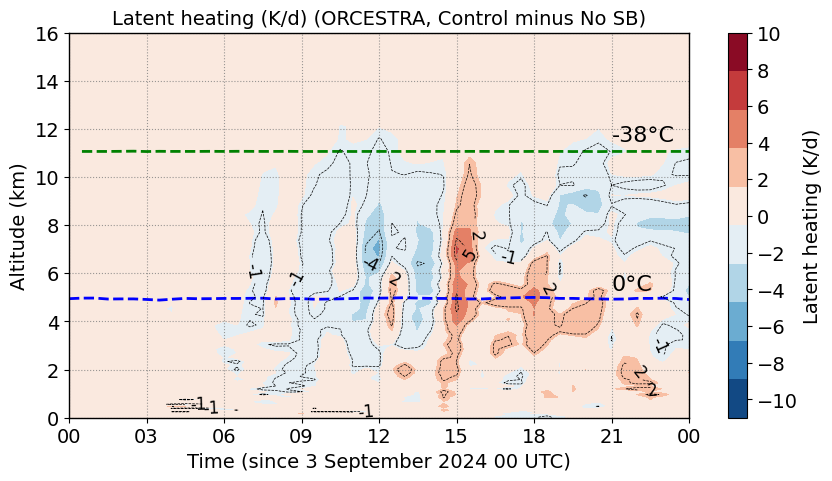

In [62]:
fnt=14;
ln=2;
lev = np.linspace(-11, 10, 11)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosb.time, mean_ht_nosb, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosb.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'b--', linewidth=ln)
plt.plot(ds_nosb.time, mean_hom_lev_nosb, 'g--', linewidth=ln)

plt.text(ds_nosb.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosb.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No SB)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-10, 10.5, 3)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosb.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

## Cloud top height

In [10]:
thres_q = 1.e-3
cld_mask = ds_4sip.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_4sip.z_mc.where(cld_mask)
mean_cld_top_ht_4sip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = (ds_nosip.twc_gperm3 > thres_q) & (ds_nosip.w_vel > 0.);
mean_cld_top_ht = ds_nosip.z_mc.where(cld_mask)
mean_cld_top_ht_nosip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_norf.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_norf.z_mc.where(cld_mask)
mean_cld_top_ht_norf = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_nohm.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_nohm.z_mc.where(cld_mask)
mean_cld_top_ht_nohm = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_nobr.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_nobr.z_mc.where(cld_mask)
mean_cld_top_ht_nobr = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_nosb.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_nosb.z_mc.where(cld_mask)
mean_cld_top_ht_nosb = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

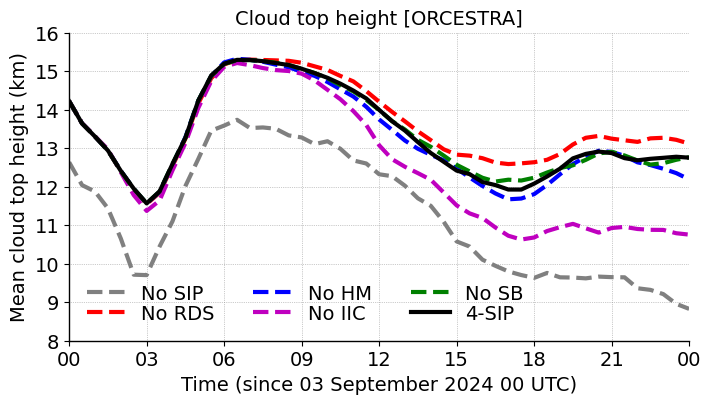

In [8]:




plt.figure(figsize=(8, 4))
plt.style.use('default')

lnwdth=3
fontsize=14

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, 1.e-3*mean_cld_top_ht_norf, 'r--', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, 1.e-3*mean_cld_top_ht_nohm, 'b--', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, 1.e-3*mean_cld_top_ht_nobr, 'm--', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, 1.e-3*mean_cld_top_ht_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(8,16)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Mean cloud top height (km)', fontsize=fontsize)#, fontweight='bold')
plt.title('Cloud top height [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)
plt.show()


## TOA Radiative Fluxes
#### Calculating CRE
##### SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
##### LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)
##### Net CRE = SW_CRE + LW_CRE

In [8]:

#### SIP 
toa_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=0).mean('ncells') 

toa_sw_cre_4sip = (toa_sw_dn_4sip-toa_sw_up_4sip) - (toa_sw_dn_clr_4sip-toa_sw_up_clr_4sip)
toa_lw_cre_4sip = (toa_sw_dn_4sip-toa_lw_up_4sip) - (toa_sw_dn_clr_4sip-toa_lw_up_clr_4sip)
toa_net_cre_4sip = toa_sw_cre_4sip+toa_lw_cre_4sip

ds_4sip['toa_sw_cre'] = toa_sw_cre_4sip
ds_4sip['toa_lw_cre'] = toa_lw_cre_4sip
ds_4sip['toa_net_cre'] = toa_net_cre_4sip


#### No SIP 
toa_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=0).mean('ncells') #ds_nosip.swflx_up[:,0,:]
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=0).mean('ncells') #ds_nosip.swflx_up_clr[:,0,:]
toa_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_up[:,0,:]
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=0).mean('ncells') #ds_nosip.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=0).mean('ncells') #ds_nosip.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_dn_clr[:,0,:]

toa_sw_cre_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_lw_cre_nosip = (toa_sw_dn_nosip-toa_lw_up_nosip) - (toa_sw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_net_cre_nosip = toa_sw_cre_nosip+toa_lw_cre_nosip

ds_nosip['toa_sw_cre'] = toa_sw_cre_nosip
ds_nosip['toa_lw_cre'] = toa_lw_cre_nosip
ds_nosip['toa_net_cre'] = toa_net_cre_nosip
ds_nosip['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_nosip
ds_nosip['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_nosip
ds_nosip['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_nosip

#### No RF 
toa_sw_up_norf = ds_norf.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_norf = ds_norf.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_norf = ds_norf.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_norf = ds_norf.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_norf = ds_norf.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_norf = ds_norf.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_norf = ds_norf.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_norf = ds_norf.lwflx_dn_clr.isel(height_2=0).mean('ncells')

toa_sw_cre_norf = (toa_sw_dn_norf-toa_sw_up_norf) - (toa_sw_dn_clr_norf-toa_sw_up_clr_norf)
toa_lw_cre_norf = (toa_sw_dn_norf-toa_lw_up_norf) - (toa_sw_dn_clr_norf-toa_lw_up_clr_norf)
toa_net_cre_norf = toa_sw_cre_norf+toa_lw_cre_norf

ds_norf['toa_sw_cre'] = toa_sw_cre_norf
ds_norf['toa_lw_cre'] = toa_lw_cre_norf
ds_norf['toa_net_cre'] = toa_net_cre_norf
ds_norf['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_norf
ds_norf['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_norf
ds_norf['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_norf

#### No HM 
toa_sw_up_nohm = ds_nohm.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_nohm = ds_nohm.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_nohm = ds_nohm.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_nohm = ds_nohm.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_nohm = ds_nohm.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_nohm = ds_nohm.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_nohm = ds_nohm.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_nohm = ds_nohm.lwflx_dn_clr.isel(height_2=0).mean('ncells')

toa_sw_cre_nohm = (toa_sw_dn_nohm-toa_sw_up_nohm) - (toa_sw_dn_clr_nohm-toa_sw_up_clr_nohm)
toa_lw_cre_nohm = (toa_sw_dn_nohm-toa_lw_up_nohm) - (toa_sw_dn_clr_nohm-toa_lw_up_clr_nohm)
toa_net_cre_nohm = toa_sw_cre_nohm+toa_lw_cre_nohm

ds_nohm['toa_sw_cre'] = toa_sw_cre_nohm
ds_nohm['toa_lw_cre'] = toa_lw_cre_nohm
ds_nohm['toa_net_cre'] = toa_net_cre_nohm
ds_nohm['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_nohm
ds_nohm['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_nohm
ds_nohm['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_nohm

#### No IIC 
toa_sw_up_nobr = ds_nobr.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_nobr = ds_nobr.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_nobr = ds_nobr.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_nobr = ds_nobr.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_nobr = ds_nobr.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_nobr = ds_nobr.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_nobr = ds_nobr.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_nobr = ds_nobr.lwflx_dn_clr.isel(height_2=0).mean('ncells')

toa_sw_cre_nobr = (toa_sw_dn_nobr-toa_sw_up_nobr) - (toa_sw_dn_clr_nobr-toa_sw_up_clr_nobr)
toa_lw_cre_nobr = (toa_sw_dn_nobr-toa_lw_up_nobr) - (toa_sw_dn_clr_nobr-toa_lw_up_clr_nobr)
toa_net_cre_nobr = toa_sw_cre_nobr+toa_lw_cre_nobr

ds_nobr['toa_sw_cre'] = toa_sw_cre_nobr
ds_nobr['toa_lw_cre'] = toa_lw_cre_nobr
ds_nobr['toa_net_cre'] = toa_net_cre_nobr
ds_nobr['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_nobr
ds_nobr['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_nobr
ds_nobr['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_nobr

#### No SB 
toa_sw_up_nosb = ds_nosb.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_nosb = ds_nosb.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_nosb = ds_nosb.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_nosb = ds_nosb.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_nosb = ds_nosb.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_nosb = ds_nosb.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_nosb = ds_nosb.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_nosb = ds_nosb.lwflx_dn_clr.isel(height_2=0).mean('ncells')

toa_sw_cre_nosb = (toa_sw_dn_nosb-toa_sw_up_nosb) - (toa_sw_dn_clr_nosb-toa_sw_up_clr_nosb)
toa_lw_cre_nosb = (toa_sw_dn_nosb-toa_lw_up_nosb) - (toa_sw_dn_clr_nosb-toa_lw_up_clr_nosb)
toa_net_cre_nosb = toa_sw_cre_nosb+toa_lw_cre_nosb

ds_nosb['toa_sw_cre'] = toa_sw_cre_nosb
ds_nosb['toa_lw_cre'] = toa_lw_cre_nosb
ds_nosb['toa_net_cre'] = toa_net_cre_nosb
ds_nosb['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_nosb
ds_nosb['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_nosb
ds_nosb['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_nosb


#### Change in CRE w.r.t. 4-SIP (control run)
del_toa_sw_cre_nosip = toa_sw_cre_4sip-toa_sw_cre_nosip
del_toa_sw_cre_norf = toa_sw_cre_4sip-toa_sw_cre_norf
del_toa_sw_cre_nohm = toa_sw_cre_4sip-toa_sw_cre_nohm 
del_toa_sw_cre_nobr = toa_sw_cre_4sip-toa_sw_cre_nobr 
del_toa_sw_cre_nosb = toa_sw_cre_4sip-toa_sw_cre_nosb 

del_toa_lw_cre_nosip = toa_lw_cre_4sip-toa_lw_cre_nosip
del_toa_lw_cre_norf = toa_lw_cre_4sip-toa_lw_cre_norf
del_toa_lw_cre_nohm = toa_lw_cre_4sip-toa_lw_cre_nohm 
del_toa_lw_cre_nobr = toa_lw_cre_4sip-toa_lw_cre_nobr 
del_toa_lw_cre_nosb = toa_lw_cre_4sip-toa_lw_cre_nosb 

del_toa_net_cre_nosip = toa_net_cre_4sip-toa_net_cre_nosip 
del_toa_net_cre_norf = toa_net_cre_4sip-toa_net_cre_norf 
del_toa_net_cre_nohm = toa_net_cre_4sip-toa_net_cre_nohm  
del_toa_net_cre_nobr = toa_net_cre_4sip-toa_net_cre_nobr 
del_toa_net_cre_nosb = toa_net_cre_4sip-toa_net_cre_nosb 

per_del_toa_sw_cre_nosip = 100*(del_toa_sw_cre_nosip)/np.abs(toa_sw_cre_4sip)
per_del_toa_sw_cre_norf = 100*(del_toa_sw_cre_norf)/np.abs(toa_sw_cre_4sip)
per_del_toa_sw_cre_nohm = 100*(del_toa_sw_cre_nohm)/np.abs(toa_sw_cre_4sip)
per_del_toa_sw_cre_nobr = 100*(del_toa_sw_cre_nobr)/np.abs(toa_sw_cre_4sip)
per_del_toa_sw_cre_nosb = 100*(del_toa_sw_cre_nosb)/np.abs(toa_sw_cre_4sip)

per_del_toa_sw_cre_nosip = per_del_toa_sw_cre_nosip.fillna(0)
per_del_toa_sw_cre_norf = per_del_toa_sw_cre_norf.fillna(0)
per_del_toa_sw_cre_nohm = per_del_toa_sw_cre_nohm.fillna(0)
per_del_toa_sw_cre_nobr = per_del_toa_sw_cre_nobr.fillna(0)
per_del_toa_sw_cre_nosb = per_del_toa_sw_cre_nosb.fillna(0)

per_del_toa_lw_cre_nosip = 100*(del_toa_lw_cre_nosip)/np.abs(toa_lw_cre_4sip)
per_del_toa_lw_cre_norf = 100*(del_toa_lw_cre_norf)/np.abs(toa_lw_cre_4sip)
per_del_toa_lw_cre_nohm = 100*(del_toa_lw_cre_nohm)/np.abs(toa_lw_cre_4sip)
per_del_toa_lw_cre_nobr = 100*(del_toa_lw_cre_nobr)/np.abs(toa_lw_cre_4sip)
per_del_toa_lw_cre_nosb = 100*(del_toa_lw_cre_nosb)/np.abs(toa_lw_cre_4sip)

per_del_toa_net_cre_nosip = 100*(del_toa_net_cre_nosip)/np.abs(toa_net_cre_4sip)
per_del_toa_net_cre_norf = 100*(del_toa_net_cre_norf)/np.abs(toa_net_cre_4sip)
per_del_toa_net_cre_nohm = 100*(del_toa_net_cre_nohm)/np.abs(toa_net_cre_4sip)
per_del_toa_net_cre_nobr = 100*(del_toa_net_cre_nobr)/np.abs(toa_net_cre_4sip)
per_del_toa_net_cre_nosb = 100*(del_toa_net_cre_nosb)/np.abs(toa_net_cre_4sip)


## Box plot of TOA radiative fluxes

In [9]:

## 4 SIP
min_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.min().values; max_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.max().values
mean_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.mean().values

min_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.min().values; max_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.max().values
mean_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.mean().values

min_toa_net_cre_4sip = ds_4sip.toa_net_cre.min().values; max_toa_net_cre_4sip = ds_4sip.toa_net_cre.max().values
mean_toa_net_cre_4sip = ds_4sip.toa_net_cre.mean().values


## No SIP
min_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.min().values; max_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.max().values
mean_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.mean().values

min_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.min().values; max_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.max().values
mean_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.mean().values

min_toa_net_cre_nosip = ds_nosip.toa_net_cre.min().values; max_toa_net_cre_nosip = ds_nosip.toa_net_cre.max().values
mean_toa_net_cre_nosip = ds_nosip.toa_net_cre.mean().values

del_min_toa_lw_cre_nosip = min_toa_lw_cre_4sip-min_toa_lw_cre_nosip; del_max_toa_lw_cre_nosip = max_toa_lw_cre_4sip-max_toa_lw_cre_nosip;
del_mean_toa_lw_cre_nosip = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosip; 
del_min_toa_sw_cre_nosip = min_toa_sw_cre_4sip-min_toa_sw_cre_nosip; del_max_toa_sw_cre_nosip = max_toa_sw_cre_4sip-max_toa_sw_cre_nosip;
del_mean_toa_sw_cre_nosip = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosip; 
del_min_toa_net_cre_nosip = min_toa_net_cre_4sip-min_toa_net_cre_nosip; del_max_toa_net_cre_nosip = max_toa_net_cre_4sip-max_toa_net_cre_nosip;
del_mean_toa_net_cre_nosip = mean_toa_net_cre_4sip-mean_toa_net_cre_nosip; 

## No RDS
min_toa_lw_cre_norf = ds_norf.toa_lw_cre.min().values; max_toa_lw_cre_norf = ds_norf.toa_lw_cre.max().values
mean_toa_lw_cre_norf = ds_norf.toa_lw_cre.mean().values

min_toa_sw_cre_norf = ds_norf.toa_sw_cre.min().values; max_toa_sw_cre_norf = ds_norf.toa_sw_cre.max().values
mean_toa_sw_cre_norf = ds_norf.toa_sw_cre.mean().values

min_toa_net_cre_norf = ds_norf.toa_net_cre.min().values; max_toa_net_cre_norf = ds_norf.toa_net_cre.max().values
mean_toa_net_cre_norf = ds_norf.toa_net_cre.mean().values

del_min_toa_lw_cre_norf = min_toa_lw_cre_4sip-min_toa_lw_cre_norf; del_max_toa_lw_cre_norf = max_toa_lw_cre_4sip-max_toa_lw_cre_norf;
del_mean_toa_lw_cre_norf = mean_toa_lw_cre_4sip-mean_toa_lw_cre_norf; 
del_min_toa_sw_cre_norf = min_toa_sw_cre_4sip-min_toa_sw_cre_norf; del_max_toa_sw_cre_norf = max_toa_sw_cre_4sip-max_toa_sw_cre_norf;
del_mean_toa_sw_cre_norf = mean_toa_sw_cre_4sip-mean_toa_sw_cre_norf; 
del_min_toa_net_cre_norf = min_toa_net_cre_4sip-min_toa_net_cre_norf; del_max_toa_net_cre_norf = max_toa_net_cre_4sip-max_toa_net_cre_norf;
del_mean_toa_net_cre_norf = mean_toa_net_cre_4sip-mean_toa_net_cre_norf;

## No HM
min_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.min().values; max_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.max().values
mean_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.mean().values

min_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.min().values; max_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.max().values
mean_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.mean().values

min_toa_net_cre_nohm = ds_nohm.toa_net_cre.min().values; max_toa_net_cre_nohm = ds_nohm.toa_net_cre.max().values
mean_toa_net_cre_nohm = ds_nohm.toa_net_cre.mean().values

del_min_toa_lw_cre_nohm = min_toa_lw_cre_4sip-min_toa_lw_cre_nohm; del_max_toa_lw_cre_nohm = max_toa_lw_cre_4sip-max_toa_lw_cre_nohm;
del_mean_toa_lw_cre_nohm = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nohm; 
del_min_toa_sw_cre_nohm = min_toa_sw_cre_4sip-min_toa_sw_cre_nohm; del_max_toa_sw_cre_nohm = max_toa_sw_cre_4sip-max_toa_sw_cre_nohm;
del_mean_toa_sw_cre_nohm = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nohm; 
del_min_toa_net_cre_nohm = min_toa_net_cre_4sip-min_toa_net_cre_nohm; del_max_toa_net_cre_nohm = max_toa_net_cre_4sip-max_toa_net_cre_nohm;
del_mean_toa_net_cre_nohm = mean_toa_net_cre_4sip-mean_toa_net_cre_nohm;

## No BR
min_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.min().values; max_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.max().values
mean_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.mean().values

min_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.min().values; max_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.max().values
mean_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.mean().values

min_toa_net_cre_nobr = ds_nobr.toa_net_cre.min().values; max_toa_net_cre_nobr = ds_nobr.toa_net_cre.max().values
mean_toa_net_cre_nobr = ds_nobr.toa_net_cre.mean().values

del_min_toa_lw_cre_nobr = min_toa_lw_cre_4sip-min_toa_lw_cre_nobr; del_max_toa_lw_cre_nobr = max_toa_lw_cre_4sip-max_toa_lw_cre_nobr;
del_mean_toa_lw_cre_nobr = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nobr; 
del_min_toa_sw_cre_nobr = min_toa_sw_cre_4sip-min_toa_sw_cre_nobr; del_max_toa_sw_cre_nobr = max_toa_sw_cre_4sip-max_toa_sw_cre_nobr;
del_mean_toa_sw_cre_nobr = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nobr; 
del_min_toa_net_cre_nobr = min_toa_net_cre_4sip-min_toa_net_cre_nobr; del_max_toa_net_cre_nobr = max_toa_net_cre_4sip-max_toa_net_cre_nobr;
del_mean_toa_net_cre_nobr = mean_toa_net_cre_4sip-mean_toa_net_cre_nobr;

## No SB
min_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.min().values; max_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.max().values
mean_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.mean().values

min_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.min().values; max_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.max().values
mean_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.mean().values

min_toa_net_cre_nosb = ds_nosb.toa_net_cre.min().values; max_toa_net_cre_nosb = ds_nosb.toa_net_cre.max().values
mean_toa_net_cre_nosb = ds_nosb.toa_net_cre.mean().values

del_min_toa_lw_cre_nosb = min_toa_lw_cre_4sip-min_toa_lw_cre_nosb; del_max_toa_lw_cre_nosb = max_toa_lw_cre_4sip-max_toa_lw_cre_nosb;
del_mean_toa_lw_cre_nosb = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosb; 
del_min_toa_sw_cre_nosb = min_toa_sw_cre_4sip-min_toa_sw_cre_nosb; del_max_toa_sw_cre_nosb = max_toa_sw_cre_4sip-max_toa_sw_cre_nosb;
del_mean_toa_sw_cre_nosb = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosb; 
del_min_toa_net_cre_nosb = min_toa_net_cre_4sip-min_toa_net_cre_nosb; del_max_toa_net_cre_nosb = max_toa_net_cre_4sip-max_toa_net_cre_nosb;
del_mean_toa_net_cre_nosb = mean_toa_net_cre_4sip-mean_toa_net_cre_nosb;


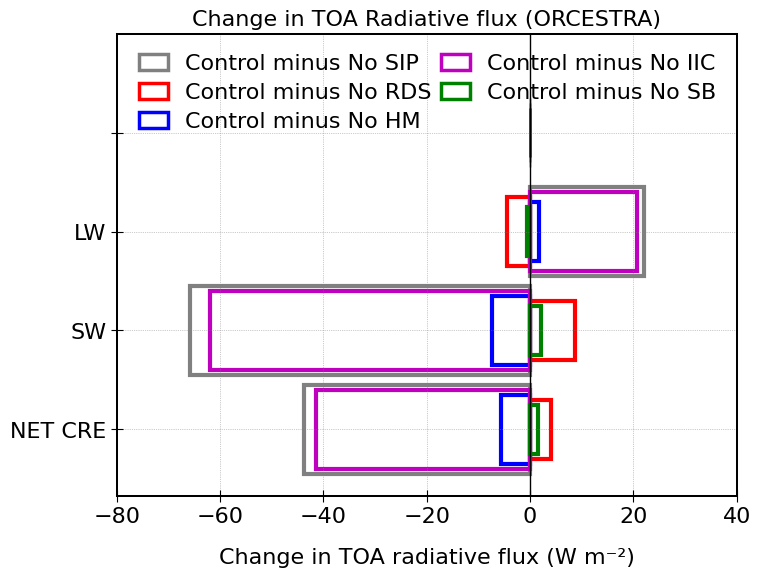

In [20]:
import matplotlib.pyplot as plt
import numpy as np

fnt = 16.0
ln=3;
x = np.array([1, 2, 3, 4])
#w1, w2, w3, w4, w5 = 0.9, 0.6, 0.7, 0.6, 0.5
w1, w2, w3, w4, w5 = 0.9, 0.8, 0.7, 0.6, 0.5

# Data for bars (assuming they are defined elsewhere in your code)
# Q_glc_lif_acm, Q_mix_lif_acm, Q_ice_lif_acm, etc.

#plt.figure('AIE CLOUDS', figsize=(12, 12))

# Plotting
#plt.figure('AIE CLOUDS')
plt.figure(figsize=(8,6))
plt.style.use('default')

plt.gca().tick_params(axis='both', which='major', labelsize=fnt)
plt.gca().tick_params(axis='both', which='minor', labelsize=fnt)
plt.gca().tick_params(axis='both', direction='inout')
plt.gca().tick_params(axis='both', length=8)


plt.barh(x[0], 0., height=w3, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w4, color='b', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='m', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='c', edgecolor='black')

# Total CLOUD AIE

plt.barh(x[1], del_mean_toa_lw_cre_nosip, height=w1, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[1], del_mean_toa_lw_cre_norf, height=w3, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[1], del_mean_toa_lw_cre_nohm, height=w4, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[1], del_mean_toa_lw_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[1], del_mean_toa_lw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[2], del_mean_toa_sw_cre_nosip, height=w1, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[2], del_mean_toa_sw_cre_norf, height=w4, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[2], del_mean_toa_sw_cre_nohm, height=w3, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[2], del_mean_toa_sw_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[2], del_mean_toa_sw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[3], del_mean_toa_net_cre_nosip, height=w1, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[3], del_mean_toa_net_cre_norf, height=w4, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[3], del_mean_toa_net_cre_nohm, height=w3, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[3], del_mean_toa_net_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[3], del_mean_toa_net_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')

plt.axvline(x=0, color='k', linewidth=ln-2, linestyle='-')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.xlim(-80.0, 40.0)
#plt.xticks([-12, -8, -4, 0, 4, 8, 12])
plt.yticks(x,['', 'LW', 'SW', 'NET CRE'], fontsize=fnt, rotation=0.)
plt.xlabel('Change in TOA radiative flux (W m⁻²)', fontsize=fnt, labelpad=15)
plt.gca().invert_yaxis()

colors = ['grey', 'r', 'b', 'm', 'g']
labels = ['Control minus No SIP', 'Control minus No RDS', 'Control minus No HM', 'Control minus No IIC', 'Control minus No SB']
hBLG = [plt.bar([0, 0], [0, 0], color=colors[i]) for i in range(len(colors))]
legend=plt.legend(hBLG, labels, loc='best', fontsize=fnt, ncol=2, frameon=False, facecolor='none', 
                  handlelength=1.3, labelspacing=0.4, columnspacing=0.4)
for patch, color in zip(legend.get_patches(), colors):
    patch.set_facecolor('none')      # Transparent fill
    patch.set_edgecolor(color)       # Colored edge
    patch.set_linewidth(ln-0.5) 
    
#plt.tight_layout(pad=-1.0)

plt.title('Change in TOA Radiative flux (ORCESTRA)', fontsize=fnt)
#plt.grid(False)
plt.gca().spines['top'].set_linewidth(1.45)
plt.gca().spines['right'].set_linewidth(1.45)
plt.gca().spines['bottom'].set_linewidth(1.45)
plt.gca().spines['left'].set_linewidth(1.45)

plt.show()


## Web plot of TOA radiative fluxes

In [8]:
import xarray as xr
import numpy as np
import pandas as pd

# List of storm datasets and a standard prefix map
storm_datasets = {
    #'Control': ds_4sip,
    'No SIP': ds_nosip,
    'No RDS': ds_norf,
    'No HM': ds_nohm,
    'No IIC': ds_nobr,
    'No SB': ds_nosb
}

def extract_features(ds, prefix):
    def safe_stat(var, func):
        return func(ds[var].values[np.isfinite(ds[var].values)])
    
    return {
        'SW$_{min}$': safe_stat(f'del_toa_sw_cre', np.min),
        'SW$_{max}$': safe_stat(f'del_toa_sw_cre', np.max),
        'SW$_{mean}$': safe_stat(f'del_toa_sw_cre', np.mean),
        'LW$_{min}$': safe_stat(f'del_toa_lw_cre', np.min),
        'LW$_{max}$': safe_stat(f'del_toa_lw_cre', np.max),
        'LW$_{mean}$': safe_stat(f'del_toa_lw_cre', np.mean),
        'NET CRE$_{min}$': safe_stat(f'del_toa_net_cre', np.min),
        'NET CRE$_{mean}$': safe_stat(f'del_toa_net_cre', np.mean)#,
        #'PEAK_SW_time': np.nanargmin(ds[f'toa_sw_cre_4sip'].values),
        #'PEAK_LW_time': np.nanargmax(ds[f'toa_lw_cre_4sip'].values)
    }

features = []
labels = []

for name, ds in storm_datasets.items():
    feats = extract_features(ds, name)
    features.append(feats)
    labels.append(name.upper())

df = pd.DataFrame(features, index=labels)


In [9]:
df

,SW$_{min}$,SW$_{max}$,SW$_{mean}$,LW$_{min}$,LW$_{max}$,LW$_{mean}$,NET CRE$_{min}$,NET CRE$_{mean}$
NO SIP,-252.759705,0.000000,-65.812500,0.000000,46.847336,22.030037,-227.401550,-43.782459
NO RDS,0.000000,48.987549,8.656152,-11.147705,0.180191,-4.526851,-11.147705,4.129301
NO HM,-46.499146,2.456192,-7.343190,-2.610046,11.167007,1.825561,-40.527649,-5.517629
NO IIC,-229.241821,0.000000,-62.000050,0.000000,42.098816,20.620346,-203.421753,-41.379704
NO SB,-3.564880,15.765015,2.193976,-4.246613,1.363846,-0.628029,-4.246613,1.565947


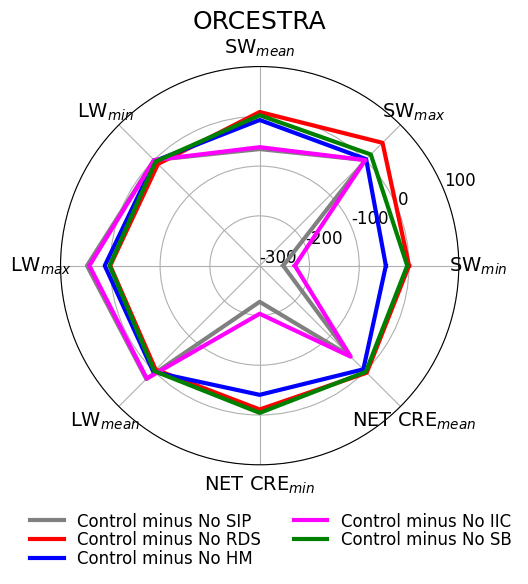

In [11]:
import matplotlib.pyplot as plt
import numpy as np
from math import pi

label_map = {
    "NO SIP": "Control minus No SIP",
    "NO RDS": "Control minus No RDS",
    "NO HM": "Control minus No HM",
    "NO IIC": "Control minus No IIC",
    "NO SB": "Control minus No SB"
}

fnt=14;
ln=3;
def multi_radar_plot(df):#, title="Storm Radiative properties"):
    labels = df.columns
    num_vars = len(labels)

    # Compute angles
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += [angles[0]]  # to close the loop

    fig, ax = plt.subplots(figsize=(8, 6), subplot_kw=dict(polar=True))
    plt.style.use('default')
    # Plot each storm
    #colors = plt.cm.tab10.colors  # 10 distinct colors
    custom_colors = {
    #"CONTROL": "black",
    "NO SIP": "grey",
    "NO RDS": "red",
    "NO HM": "blue",
    "NO IIC": "magenta",
    "NO SB": "green"
    }
    for i, (storm_name, row) in enumerate(df.iterrows()):
        values = row.values
        values = np.concatenate([values, [values[0]]])
        color = custom_colors.get(storm_name, "gray")
        #ax.plot(angles, values, label=storm_name, color=colors[i % len(colors)], linewidth=ln)
        #ax.fill(angles, values, alpha=0.0, color=colors[i % len(colors)])
        label = label_map.get(storm_name, storm_name)
        ax.plot(angles, values, label=label, color=color, linewidth=ln)
        ax.fill(angles, values, alpha=0.0, color=color)

    # Axis settings
    ax.set_xticks(angles[:-1])
    ax.tick_params(axis='y', labelsize=fnt)
    #ax.set_rgrids(fontsize=fnt)
    ax.set_xticklabels(labels, fontsize=fnt)
    ax.set_ylim(-300, 100)
    ax.set_yticks([-300, -200, -100, 0, 100])
    ax.set_yticklabels(['-300', '-200', '-100', '0', '100'], fontsize=fnt-2)
    #ax.set_ylim(200, -800)
    #ax.set_yticks([200, 0, -200, -400, -600, -800])
    #ax.set_yticklabels(['-600', '-400', '-200', '0'], fontsize=fnt)
    ax.set_title('ORCESTRA', fontsize=fnt+4)
    ax.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt-2, bbox_to_anchor=(1.17, -0.08), ncols=2, loc='best')#frameon=False, loc='best', ncols=1, fontsize=fnt, bbox_to_anchor=(1.2, 1.05))
    plt.tight_layout()
    plt.show()


multi_radar_plot(df)

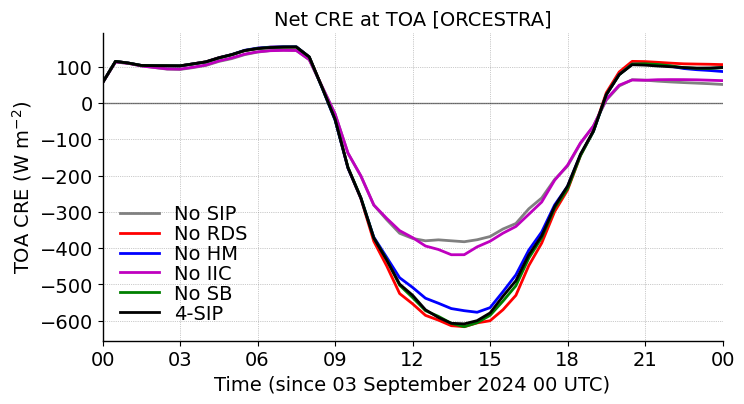

In [46]:
plt.figure(figsize=(8, 4))

lnwdth=2
fontsize=14

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_net_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
#plt.ylim(-700,200)
plt.yticks(fontsize=fontsize)
plt.ylabel('TOA CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Net CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)
plt.show()


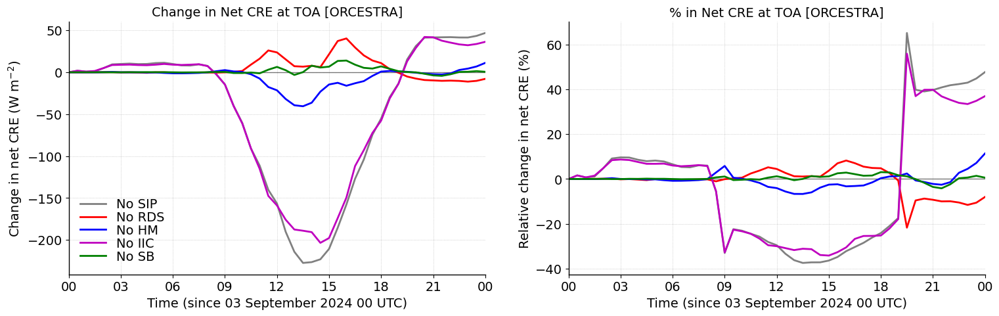

In [47]:
plt.figure(figsize=(18, 5))

lnwdth=2
fontsize=14

plt.subplot(1,2,1)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-50,200)
#plt.yticks([-50, 0, 50, 100, 150, 200], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in net CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in Net CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)


plt.subplot(1,2,2)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-20,30)
#plt.yticks([-20, -10, 0, 10, 20, 30], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Relative change in net CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% in Net CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.show()


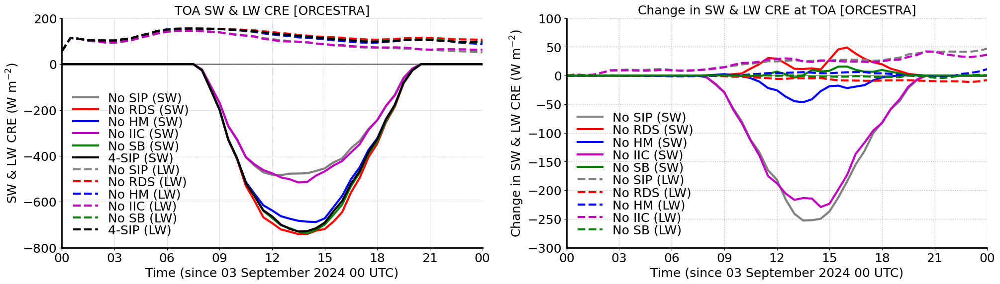

In [17]:


plt.figure(figsize=(24, 6))
plt.style.use('default')

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP (SW)')
plt.plot(ds_norf.time, toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS (SW)')
plt.plot(ds_nohm.time, toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM (SW)')
plt.plot(ds_nobr.time, toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC (SW)')
plt.plot(ds_nosb.time, toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB (SW)')
plt.plot(ds_4sip.time, toa_sw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP (SW)')

plt.plot(ds_nosip.time, toa_lw_cre_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP (LW)')
plt.plot(ds_norf.time, toa_lw_cre_norf, 'r--', linewidth=lnwdth, label='No RDS (LW)')
plt.plot(ds_nohm.time, toa_lw_cre_nohm, 'b--', linewidth=lnwdth, label='No HM (LW)')
plt.plot(ds_nobr.time, toa_lw_cre_nobr, 'm--', linewidth=lnwdth, label='No IIC (LW)')
plt.plot(ds_nosb.time, toa_lw_cre_nosb, 'g--', linewidth=lnwdth, label='No SB (LW)')
plt.plot(ds_4sip.time, toa_lw_cre_4sip, 'k--', linewidth=lnwdth, label='4-SIP (LW)')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(-800,200)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('SW & LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW & LW CRE [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.01, ncols=1, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP (SW)')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS (SW)')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM (SW)')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC (SW)')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB (SW)')

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP (LW)')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r--', linewidth=lnwdth, label='No RDS (LW)')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b--', linewidth=lnwdth, label='No HM (LW)')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm--', linewidth=lnwdth, label='No IIC (LW)')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g--', linewidth=lnwdth, label='No SB (LW)')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(-300, 100)
#plt.yticks([-8, -6, -4, -2, 0, 2, 4, 6, 8], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in SW & LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in SW & LW CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=1, loc='best')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.show()


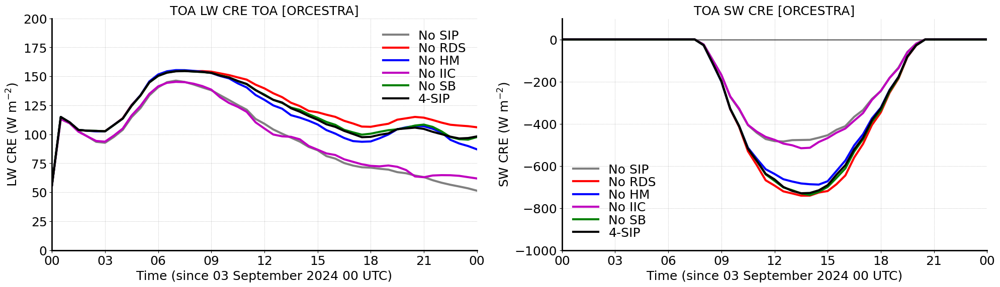

In [49]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_lw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(0,200)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA LW CRE TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_sw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-1000,100)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW CRE [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


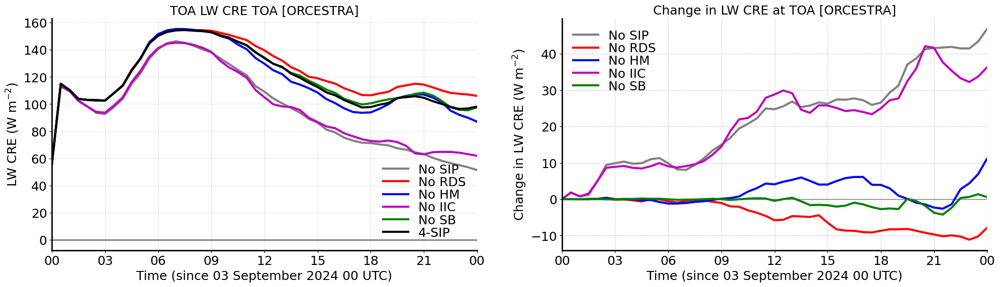

In [50]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_lw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(0,200)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA LW CRE TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-30, 5)
#plt.yticks([-30, -25, -20, -15, -10, -5, 0, 5], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.ylabel('Change in LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in LW CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.show()


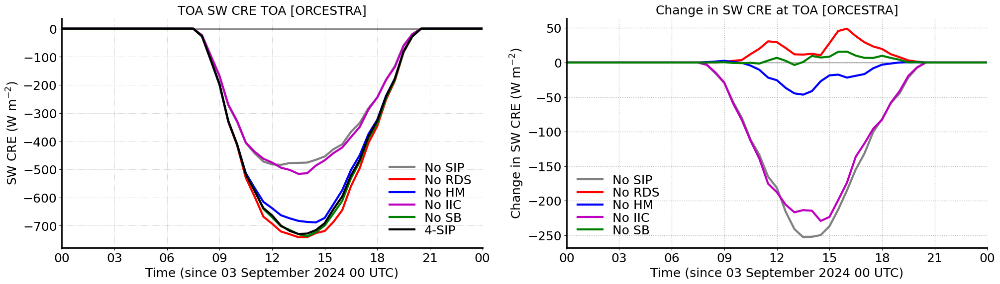

In [51]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_sw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(0,200)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW CRE TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-30, 5)
#plt.yticks([-30, -25, -20, -15, -10, -5, 0, 5], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.ylabel('Change in SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in SW CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.show()


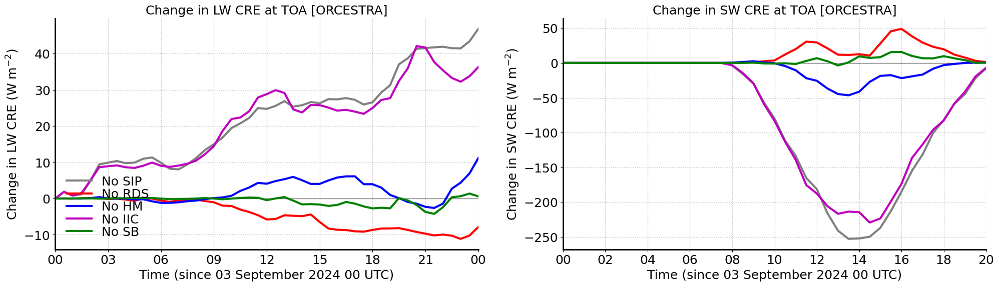

In [52]:

plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-30, 5)
#plt.yticks([-30, -25, -20, -15, -10, -5, 0, 5], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.ylabel('Change in LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in LW CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-50,300)
#plt.yticks([-8, -4, 0, 4, 8, 12, 16, 20], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.ylabel('Change in SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in SW CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')

#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


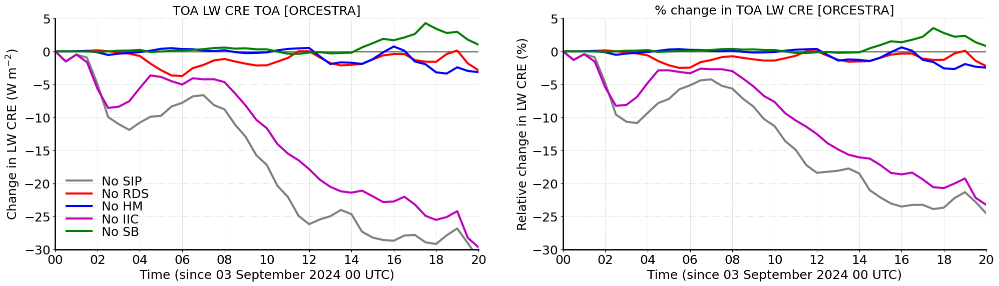

In [33]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-30, 5)
#plt.yticks([-14, -12, -10, -8, -6, -4, -2, 0, 2], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA LW CRE TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-30,5)
plt.yticks(fontsize=fontsize)
plt.ylabel('Relative change in LW CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% change in TOA LW CRE [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


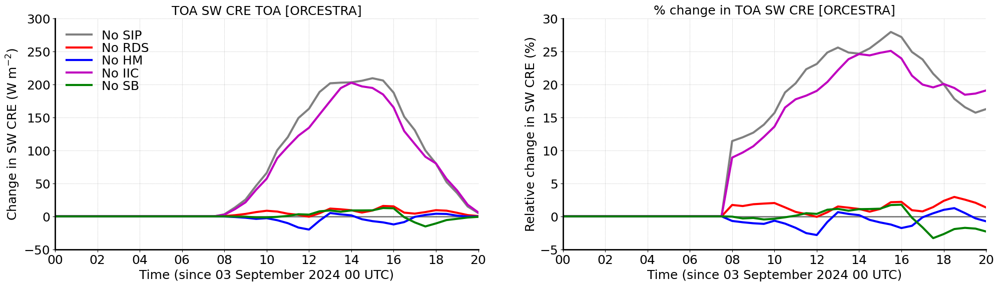

In [36]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-50, 300)
plt.yticks(fontsize=fontsize)
#plt.yticks([-8, -4, 0, 4, 8, 12, 16, 20], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW CRE TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-5,30)
plt.yticks(fontsize=fontsize)
plt.ylabel('Relative change in SW CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% change in TOA SW CRE [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


## Radiative Heating Rates

In [53]:
# LW/SW heating rate with No SIP
mean_lwr_kperd_nosip = 86400.*ds_nosip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nosip = 86400.*ds_nosip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nosip = mean_lwr_kperd_nosip + mean_swr_kperd_nosip

# LW/SW heating rate with 4 SIP
mean_lwr_kperd_4sip = 86400.*ds_4sip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_4sip = 86400.*ds_4sip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_4sip = mean_lwr_kperd_4sip + mean_swr_kperd_4sip

# LW/SW heating rate with No RF
mean_lwr_kperd_norf = 86400.*ds_norf.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_norf = 86400.*ds_norf.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_norf = mean_lwr_kperd_norf + mean_swr_kperd_norf

# LW/SW heating rate with No HM
mean_lwr_kperd_nohm = 86400.*ds_nohm.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nohm = 86400.*ds_nohm.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nohm = mean_lwr_kperd_nohm + mean_swr_kperd_nohm

# LW/SW heating rate with No IIC
mean_lwr_kperd_nobr = 86400.*ds_nobr.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nobr = 86400.*ds_nobr.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nobr = mean_lwr_kperd_nobr + mean_swr_kperd_nobr

# LW/SW heating rate with No SB
mean_lwr_kperd_nosb = 86400.*ds_nosb.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nosb = 86400.*ds_nosb.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nosb = mean_lwr_kperd_nosb + mean_swr_kperd_nosb

# Change in tot rad. heating w.r.t. control
del_tot_rad_kperd_norf = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_norf
del_tot_rad_kperd_nohm = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nohm
del_tot_rad_kperd_nobr = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nobr
del_tot_rad_kperd_nosb = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nosb
del_tot_rad_kperd_nosip = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nosip

# Change in LW rad. heating w.r.t. control
del_lwr_kperd_norf = mean_lwr_kperd_4sip-mean_lwr_kperd_norf
del_lwr_kperd_nohm = mean_lwr_kperd_4sip-mean_lwr_kperd_nohm
del_lwr_kperd_nobr = mean_lwr_kperd_4sip-mean_lwr_kperd_nobr
del_lwr_kperd_nosb = mean_lwr_kperd_4sip-mean_lwr_kperd_nosb
del_lwr_kperd_nosip = mean_lwr_kperd_4sip-mean_lwr_kperd_nosip

# Change in SW rad. heating w.r.t. control
del_swr_kperd_norf = mean_swr_kperd_4sip-mean_swr_kperd_norf
del_swr_kperd_nohm = mean_swr_kperd_4sip-mean_swr_kperd_nohm
del_swr_kperd_nobr = mean_swr_kperd_4sip-mean_swr_kperd_nobr
del_swr_kperd_nosb = mean_swr_kperd_4sip-mean_swr_kperd_nosb
del_swr_kperd_nosip = mean_swr_kperd_4sip-mean_swr_kperd_nosip

mean_tot_rad_kperd_nosip = mean_tot_rad_kperd_nosip.where(mean_tempc_nosip > -70)
mean_tot_rad_kperd_4sip = mean_tot_rad_kperd_4sip.where(mean_tempc_4sip > -70)
mean_tot_rad_kperd_norf = mean_tot_rad_kperd_norf.where(mean_tempc_norf > -70)
mean_tot_rad_kperd_nohm = mean_tot_rad_kperd_nohm.where(mean_tempc_nohm > -70)
mean_tot_rad_kperd_nobr = mean_tot_rad_kperd_nobr.where(mean_tempc_nobr > -70)
mean_tot_rad_kperd_nosb = mean_tot_rad_kperd_nosb.where(mean_tempc_nosb > -70)

In [54]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_rad_kperd_nosip, mean_tot_rad_kperd_4sip, mean_tot_rad_kperd_norf, mean_tot_rad_kperd_nohm, 
             mean_tot_rad_kperd_nobr, mean_tot_rad_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_rad_kperd_nosip = numpy_variables[0]
mean_tot_rad_kperd_4sip = numpy_variables[1]
mean_tot_rad_kperd_norf = numpy_variables[2]
mean_tot_rad_kperd_nohm = numpy_variables[3]
mean_tot_rad_kperd_nobr = numpy_variables[4]
mean_tot_rad_kperd_nosb = numpy_variables[5]


In [55]:

variables = [mean_lwr_kperd_nosip, mean_lwr_kperd_4sip, mean_lwr_kperd_norf, mean_lwr_kperd_nohm, 
             mean_lwr_kperd_nobr, mean_lwr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_lwr_kperd_nosip = numpy_variables[0]
mean_lwr_kperd_4sip = numpy_variables[1]
mean_lwr_kperd_norf = numpy_variables[2]
mean_lwr_kperd_nohm = numpy_variables[3]
mean_lwr_kperd_nobr = numpy_variables[4]
mean_lwr_kperd_nosb = numpy_variables[5]

variables = [mean_swr_kperd_nosip, mean_swr_kperd_4sip, mean_swr_kperd_norf, mean_swr_kperd_nohm, 
             mean_swr_kperd_nobr, mean_swr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_swr_kperd_nosip = numpy_variables[0]
mean_swr_kperd_4sip = numpy_variables[1]
mean_swr_kperd_norf = numpy_variables[2]
mean_swr_kperd_nohm = numpy_variables[3]
mean_swr_kperd_nobr = numpy_variables[4]
mean_swr_kperd_nosb = numpy_variables[5]


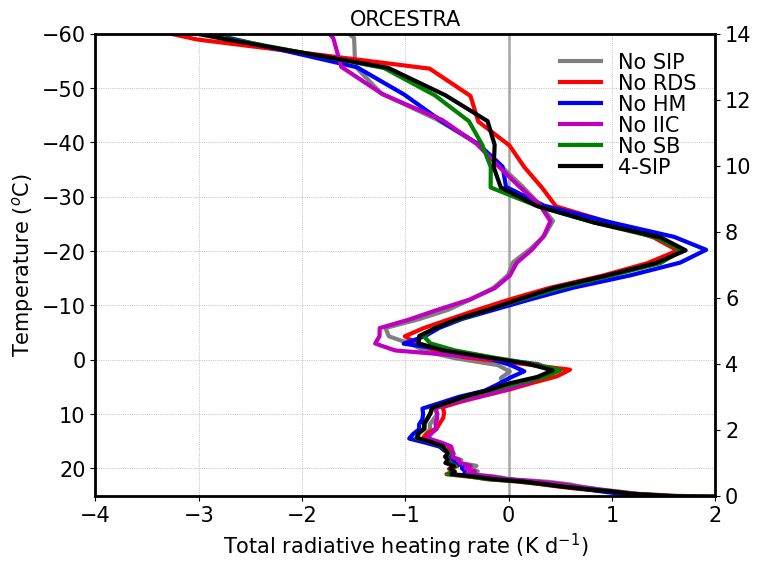

In [58]:
fontsize=15; lnwdth=3; alpha=0.6;

plt.figure(figsize=(8, 6)) 

plt1=plt.gca() 
plt2=plt1.twinx() 

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6) 

plt1.plot(mean_tot_rad_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')  
plt1.plot(mean_tot_rad_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS') 
plt1.plot(mean_tot_rad_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM') 
plt1.plot(mean_tot_rad_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC') 
plt1.plot(mean_tot_rad_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_rad_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_rad_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-4, 2) 
plt1.set_ylim(25, -60) 
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60]) 
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize) 
plt1.tick_params(axis='y', labelsize=fontsize) 
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total radiative heating rate (K d$^{-1}$)', fontsize=fontsize) 
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend() 
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2) 
plt1.spines['right'].set_linewidth(2) 
plt1.spines['left'].set_linewidth(2) 
plt1.spines['bottom'].set_linewidth(2) 
plt.show()


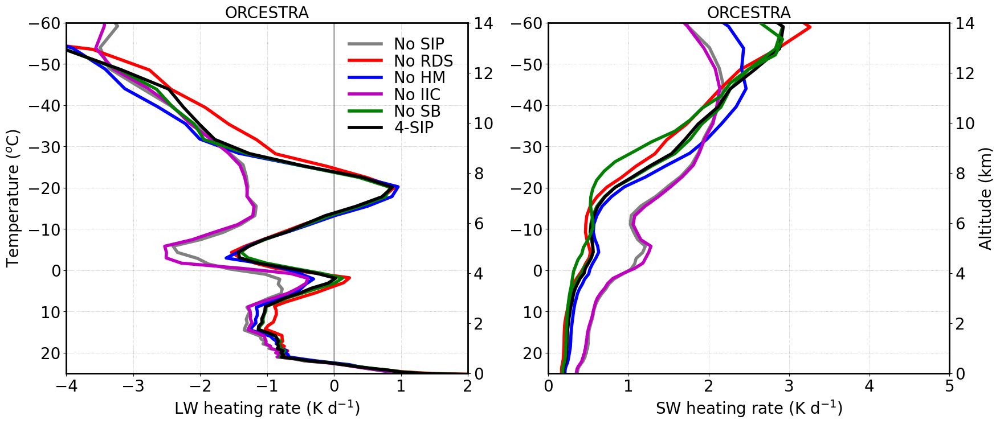

In [59]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lwr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_lwr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_lwr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_lwr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_lwr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_lwr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lwr_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4., 2)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-4, -3, -2, -1, 0])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('LW heating rate (K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_swr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_swr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_swr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_swr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_swr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_swr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_swr_kperd_nosb, mean_ht_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 5)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([0, 1, 2, 3, 4, 5])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')

plt1.set_xlabel('SW heating rate (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.show()


# Vertical velocity

In [17]:

thres_q = 0.;

#mean_tot_w_nosip = ds_nosip.w_vel.where(abs(ds_nosip.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_4sip = ds_4sip.w_vel.where(abs(ds_4sip.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_norf = ds_norf.w_vel.where(abs(ds_norf.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nohm = ds_nohm.w_vel.where(abs(ds_nohm.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nobr = ds_nobr.w_vel.where(abs(ds_nobr.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nosb = ds_nosb.w_vel.where(abs(ds_nosb.w_vel) > 0.).mean(dim=('time','ncells'))

#mean_tot_w_nosip = ds_nosip.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_4sip = ds_4sip.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_norf = ds_norf.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nohm = ds_nohm.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nobr = ds_nobr.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nosb = ds_nosb.w_vel.mean(dim=('time','ncells'))

mean_tot_w_nosip = xr.where(ds_nosip.tqi > thres_q, ds_nosip.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_4sip = xr.where(ds_4sip.tqi > thres_q, ds_4sip.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_norf = xr.where(ds_norf.tqi > thres_q, ds_norf.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nohm = xr.where(ds_nohm.tqi > thres_q, ds_nohm.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nobr = xr.where(ds_nobr.tqi > thres_q, ds_nobr.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nosb = xr.where(ds_nosb.tqi > thres_q, ds_nosb.w_vel, np.nan).mean(dim=('time','ncells'))

del_tot_w_nosip = mean_tot_w_4sip - mean_tot_w_nosip
del_tot_w_norf = mean_tot_w_4sip - mean_tot_w_norf
del_tot_w_nohm = mean_tot_w_4sip - mean_tot_w_nohm
del_tot_w_nobr = mean_tot_w_4sip - mean_tot_w_nobr
del_tot_w_nosb = mean_tot_w_4sip - mean_tot_w_nosb

#mean_tot_w_nosip = mean_tot_w_nosip.where(mean_tempc_nosip > -70)
#mean_tot_w_4sip = mean_tot_w_4sip.where(mean_tempc_4sip > -70)
#mean_tot_w_norf = mean_tot_w_norf.where(mean_tempc_norf > -70)
#mean_tot_w_nohm = mean_tot_w_nohm.where(mean_tempc_nohm > -70)
#mean_tot_w_nobr = mean_tot_w_nobr.where(mean_tempc_nobr > -70)
#mean_tot_w_nosb = mean_tot_w_nosb.where(mean_tempc_nosb > -70)

#del_tot_w_nosip = del_tot_w_nosip.where(mean_tempc_nosip > -70)
#del_tot_w_norf = del_tot_w_norf.where(mean_tempc_norf > -70)
#del_tot_w_nohm = del_tot_w_nohm.where(mean_tempc_nohm > -70)
#del_tot_w_nobr = del_tot_w_nobr.where(mean_tempc_nobr > -70)
#del_tot_w_nosb = del_tot_w_nosb.where(mean_tempc_nosb > -70)

In [18]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_w_nosip, mean_tot_w_4sip, mean_tot_w_norf, mean_tot_w_nohm, mean_tot_w_nobr, mean_tot_w_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_w_nosip = numpy_variables[0]
mean_tot_w_4sip = numpy_variables[1]
mean_tot_w_norf = numpy_variables[2]
mean_tot_w_nohm = numpy_variables[3]
mean_tot_w_nobr = numpy_variables[4]
mean_tot_w_nosb = numpy_variables[5]

In [19]:

del_tot_w_nosip = mean_tot_w_4sip-mean_tot_w_nosip
del_tot_w_norf = mean_tot_w_4sip-mean_tot_w_norf
del_tot_w_nohm = mean_tot_w_4sip-mean_tot_w_nohm 
del_tot_w_nobr = mean_tot_w_4sip-mean_tot_w_nobr 
del_tot_w_nosb = mean_tot_w_4sip-mean_tot_w_nosb 

per_del_tot_w_nosip = 100*del_tot_w_nosip/mean_tot_w_4sip
per_del_tot_w_norf = 100*del_tot_w_norf/mean_tot_w_4sip
per_del_tot_w_nohm = 100*del_tot_w_nohm/mean_tot_w_4sip
per_del_tot_w_nobr = 100*del_tot_w_nobr/mean_tot_w_4sip
per_del_tot_w_nosb = 100*del_tot_w_nosb/mean_tot_w_4sip


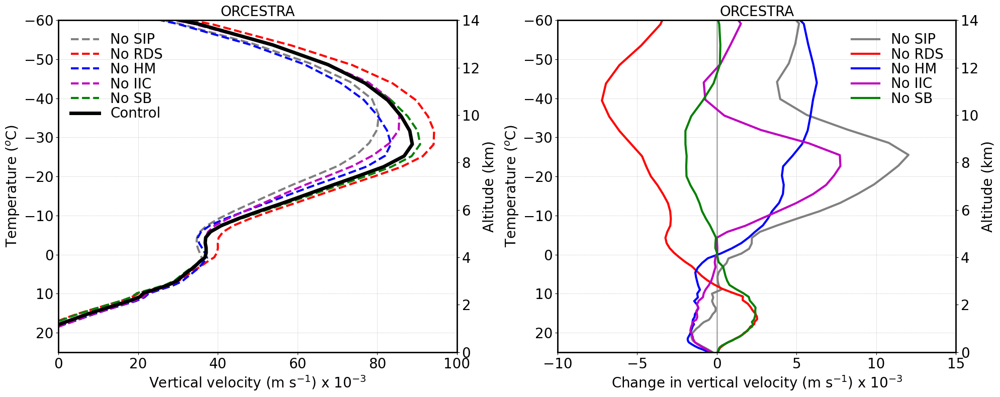

In [21]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_w_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_w_norf*fact, mean_tempc_norf, 'r--', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_w_nohm*fact, mean_tempc_nohm, 'b--', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_w_nobr*fact, mean_tempc_nobr, 'm--', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_w_nosb*fact, mean_tempc_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_w_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='Control')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 100)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([0, 20, 40, 60, 80, 100, 120, 140])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(del_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(del_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(del_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(del_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(del_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-10, 15)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-10, -5, 0, 5, 10, 15])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Change in vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


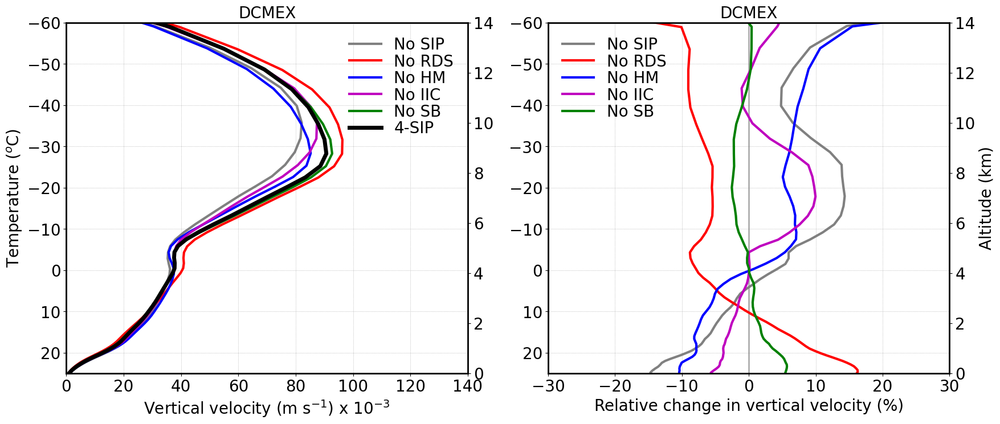

In [72]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_w_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 140)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([0, 20, 40, 60, 80, 100, 120, 140])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-30, 30)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-30, -20, -10, 0, 10, 20, 30])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Relative change in vertical velocity (%)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


# Cloud cover

In [67]:

mean_tot_cld_cover_nosip = ds_nosip.clc.where(ds_nosip.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_4sip = ds_4sip.clc.where(ds_4sip.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_norf = ds_norf.clc.where(ds_norf.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nohm = ds_nohm.clc.where(ds_nohm.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nobr = ds_nobr.clc.where(ds_nobr.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nosb = ds_nosb.clc.where(ds_nosb.tq > 0.).mean(dim=('time','ncells'))


In [68]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_cld_cover_nosip, mean_tot_cld_cover_4sip, mean_tot_cld_cover_norf, mean_tot_cld_cover_nohm, 
             mean_tot_cld_cover_nobr, mean_tot_cld_cover_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_cld_cover_nosip = numpy_variables[0]
mean_tot_cld_cover_4sip = numpy_variables[1]
mean_tot_cld_cover_norf = numpy_variables[2]
mean_tot_cld_cover_nohm = numpy_variables[3]
mean_tot_cld_cover_nobr = numpy_variables[4]
mean_tot_cld_cover_nosb = numpy_variables[5]


In [69]:

del_tot_cld_cover_nosip = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nosip 
del_tot_cld_cover_norf = mean_tot_cld_cover_4sip-mean_tot_cld_cover_norf
del_tot_cld_cover_nohm = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nohm 
del_tot_cld_cover_nobr = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nobr 
del_tot_cld_cover_nosb = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nosb 

per_del_tot_cld_cover_nosip = 100*del_tot_cld_cover_nosip/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_norf = 100*del_tot_cld_cover_norf/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nohm = 100*del_tot_cld_cover_nohm/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nobr = 100*del_tot_cld_cover_nobr/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nosb = 100*del_tot_cld_cover_nosb/mean_tot_cld_cover_4sip


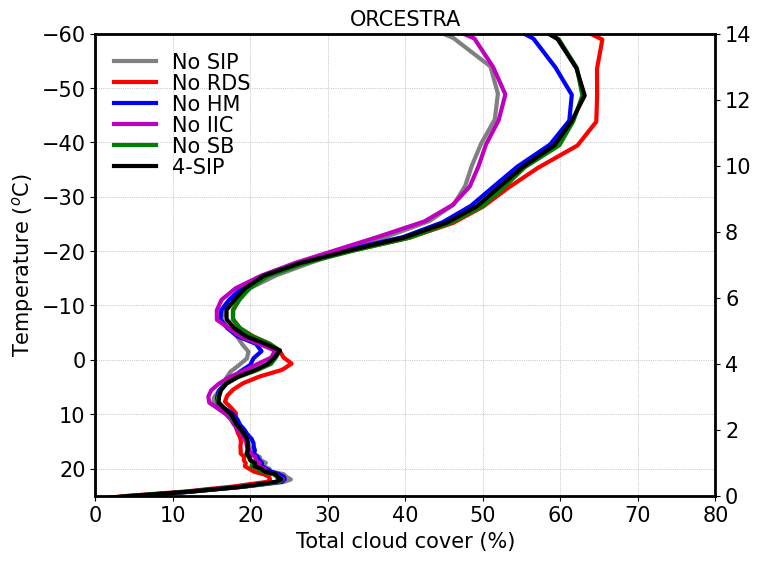

In [70]:
fontsize=15; lnwdth=3; alpha=0.6;

plt.figure(figsize=(8, 6)) 

plt1=plt.gca() 
plt2=plt1.twinx() 

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6) 

plt1.plot(mean_tot_cld_cover_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP') 
plt1.plot(mean_tot_cld_cover_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS') 
plt1.plot(mean_tot_cld_cover_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM') 
plt1.plot(mean_tot_cld_cover_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC') 
plt1.plot(mean_tot_cld_cover_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_cld_cover_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP') 

plt2.plot(mean_tot_rad_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 80) 
plt1.set_ylim(25, -60) 
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60]) 
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize) 
plt1.tick_params(axis='y', labelsize=fontsize) 
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total cloud cover (%)', fontsize=fontsize) 
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend() 
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2) 
plt1.spines['right'].set_linewidth(2) 
plt1.spines['left'].set_linewidth(2) 
plt1.spines['bottom'].set_linewidth(2) 
plt.show()

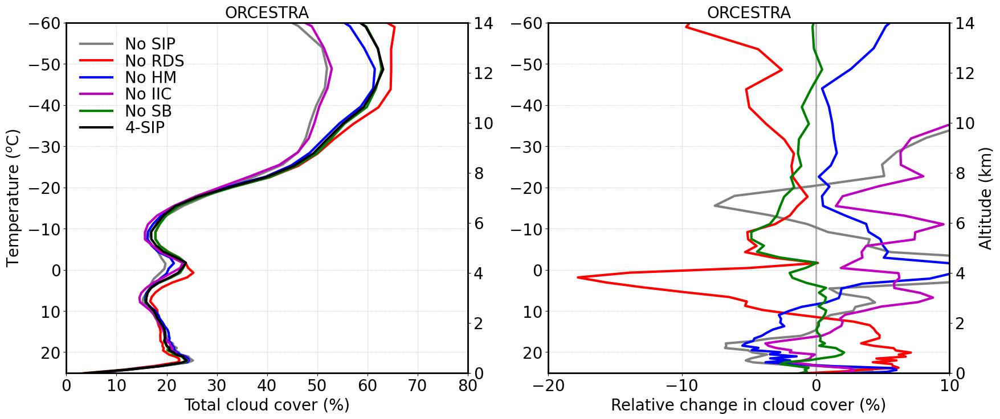

In [74]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_cld_cover_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_cld_cover_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_cld_cover_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_cld_cover_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_cld_cover_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_cld_cover_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 80)
plt1.set_ylim(25, -60)
plt2.set_ylim(0., 14)

plt1.set_xticks([0, 10, 20, 30, 40, 50 ,60, 70, 80])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total cloud cover (%)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_tot_cld_cover_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_tot_cld_cover_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_tot_cld_cover_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_tot_cld_cover_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_tot_cld_cover_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-20, 10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-20, -10, 0, 10])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Relative change in cloud cover (%)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


# Surface rainfall

In [18]:
acc_precip_nosip = ds_nosip.tot_prec.mean('ncells')
acc_precip_4sip = ds_4sip.tot_prec.mean('ncells')
acc_precip_nohm = ds_nohm.tot_prec.mean('ncells')
acc_precip_nobr = ds_nobr.tot_prec.mean('ncells')
acc_precip_norf = ds_norf.tot_prec.mean('ncells')
acc_precip_nosb = ds_nosb.tot_prec.mean('ncells')

In [19]:
del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')
del_prec_norf = ds_norf.tot_prec.diff('time')
del_prec_nohm = ds_nohm.tot_prec.diff('time')
del_prec_nobr = ds_nobr.tot_prec.diff('time')
del_prec_nosb = ds_nosb.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/0.5
precip_rate_4sip = del_prec_4sip/0.5
precip_rate_norf = del_prec_norf/0.5            # output is over 30 min
precip_rate_nohm = del_prec_nohm/0.5
precip_rate_nobr = del_prec_nobr/0.5
precip_rate_nosb = del_prec_nosb/0.5

# Change in surface precipitation
del_acc_prec_nosip = acc_precip_4sip-acc_precip_nosip  
del_acc_prec_norf = acc_precip_4sip-acc_precip_norf 
del_acc_prec_nohm = acc_precip_4sip-acc_precip_nohm 
del_acc_prec_nobr = acc_precip_4sip-acc_precip_nobr 
del_acc_prec_nosb = acc_precip_4sip-acc_precip_nosb 


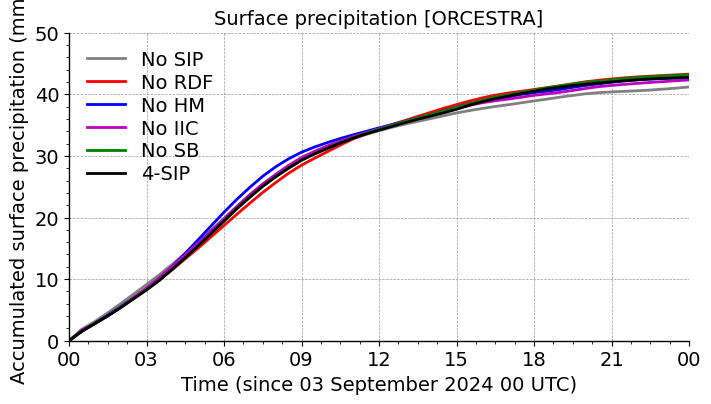

In [20]:


fontsize=14
linwdth = 2
plt.figure(figsize=(8, 4))

plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='grey', label="No SIP", linewidth = linwdth)
plt.plot(ds_norf.time, acc_precip_norf, "r-", label="No RDF", linewidth = linwdth)
plt.plot(ds_nohm.time, acc_precip_nohm, "b-", label="No HM", linewidth = linwdth)
plt.plot(ds_nobr.time, acc_precip_nobr, "m-", label="No IIC", linewidth = linwdth)
plt.plot(ds_nosb.time, acc_precip_nosb, "g-", label="No SB", linewidth = linwdth)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="4-SIP", linewidth = linwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
plt.ylim(0, 50)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation [ORCESTRA]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()


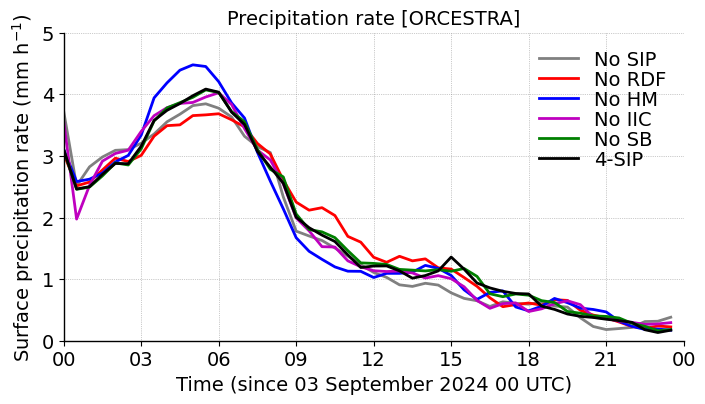

In [22]:


fontsize=14
lnwdth = 2
plt.figure(figsize=(8, 4))

plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time[:-1], precip_rate_norf.mean('ncells'), 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time[:-1], precip_rate_nohm.mean('ncells'), 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time[:-1], precip_rate_nobr.mean('ncells'), 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time[:-1], precip_rate_nosb.mean('ncells'), 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.ylim(0, 5)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate [ORCESTRA]', fontsize=fontsize)
#plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()


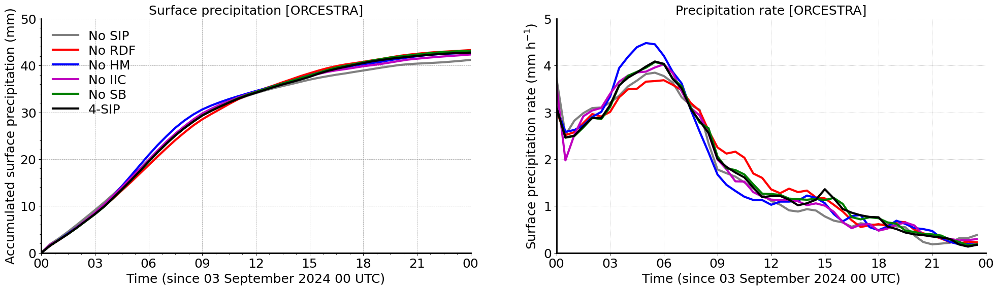

In [77]:


fontsize=18
linwdth = 3
plt.figure(figsize=(24, 6))

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='grey', label="No SIP", linewidth = linwdth)
plt.plot(ds_norf.time, acc_precip_norf, "r-", label="No RDF", linewidth = linwdth)
plt.plot(ds_nohm.time, acc_precip_nohm, "b-", label="No HM", linewidth = linwdth)
plt.plot(ds_nobr.time, acc_precip_nobr, "m-", label="No IIC", linewidth = linwdth)
plt.plot(ds_nosb.time, acc_precip_nosb, "g-", label="No SB", linewidth = linwdth)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="4-SIP", linewidth = linwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
plt.ylim(0, 50)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation [ORCESTRA]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time[:-1], precip_rate_norf.mean('ncells'), 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time[:-1], precip_rate_nohm.mean('ncells'), 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time[:-1], precip_rate_nobr.mean('ncells'), 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time[:-1], precip_rate_nosb.mean('ncells'), 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.ylim(0, 5)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate [ORCESTRA]', fontsize=fontsize)
#plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)
plt.show()


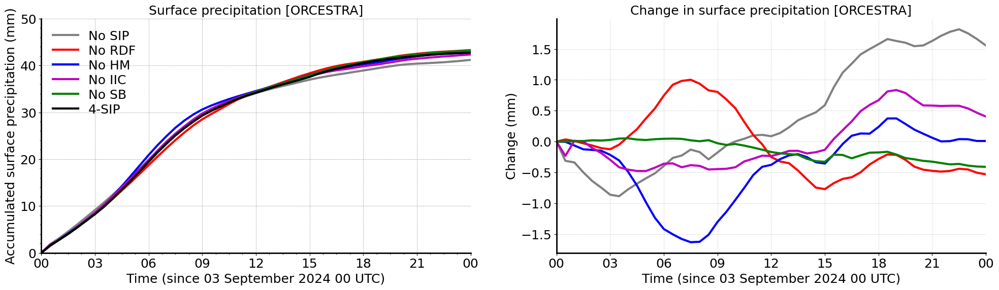

In [78]:


fontsize=18
linwdth = 3
plt.figure(figsize=(24, 6))

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='grey', label="No SIP", linewidth = linwdth)
plt.plot(ds_norf.time, acc_precip_norf, "r-", label="No RDF", linewidth = linwdth)
plt.plot(ds_nohm.time, acc_precip_nohm, "b-", label="No HM", linewidth = linwdth)
plt.plot(ds_nobr.time, acc_precip_nobr, "m-", label="No IIC", linewidth = linwdth)
plt.plot(ds_nosb.time, acc_precip_nosb, "g-", label="No SB", linewidth = linwdth)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="4-SIP", linewidth = linwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
plt.ylim(0, 50)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation [ORCESTRA]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(ds_nosip.time, del_acc_prec_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_acc_prec_norf, 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time, del_acc_prec_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_acc_prec_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_acc_prec_nosb, 'g-', linewidth=lnwdth, label='No SB')

#plt.ylim(-5, 5)
plt.ylabel('Change (mm)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Change in surface precipitation [ORCESTRA]', fontsize=fontsize)
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)
plt.show()


# Ice number concentrations

In [79]:


thres_w = 2.
mean_tot_inc_up_nosip = ds_nosip.inc_perl.where(ds_nosip.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_4sip = ds_4sip.inc_perl.where(ds_4sip.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_norf = ds_norf.inc_perl.where(ds_norf.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nohm = ds_nohm.inc_perl.where(ds_nohm.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nobr = ds_nobr.inc_perl.where(ds_nobr.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nosb = ds_nosb.inc_perl.where(ds_nosb.w_vel > thres_w).mean(dim=('time','ncells'))

mean_tot_inc_dn_nosip = ds_nosip.inc_perl.where(ds_nosip.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_4sip = ds_4sip.inc_perl.where(ds_4sip.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_norf = ds_norf.inc_perl.where(ds_norf.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nohm = ds_nohm.inc_perl.where(ds_nohm.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nobr = ds_nobr.inc_perl.where(ds_nobr.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nosb = ds_nosb.inc_perl.where(ds_nosb.w_vel < -1*thres_w).mean(dim=('time','ncells'))



In [80]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_inc_up_nosip, mean_tot_inc_up_4sip, mean_tot_inc_up_norf, mean_tot_inc_up_nohm, 
             mean_tot_inc_up_nobr, mean_tot_inc_up_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_inc_up_nosip = numpy_variables[0]
mean_tot_inc_up_4sip = numpy_variables[1]
mean_tot_inc_up_norf = numpy_variables[2]
mean_tot_inc_up_nohm = numpy_variables[3]
mean_tot_inc_up_nobr = numpy_variables[4]
mean_tot_inc_up_nosb = numpy_variables[5]


variables = [mean_tot_inc_dn_nosip, mean_tot_inc_dn_4sip, mean_tot_inc_dn_norf, mean_tot_inc_dn_nohm, 
             mean_tot_inc_dn_nobr, mean_tot_inc_dn_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_inc_dn_nosip = numpy_variables[0]
mean_tot_inc_dn_4sip = numpy_variables[1]
mean_tot_inc_dn_norf = numpy_variables[2]
mean_tot_inc_dn_nohm = numpy_variables[3]
mean_tot_inc_dn_nobr = numpy_variables[4]
mean_tot_inc_dn_nosb = numpy_variables[5]


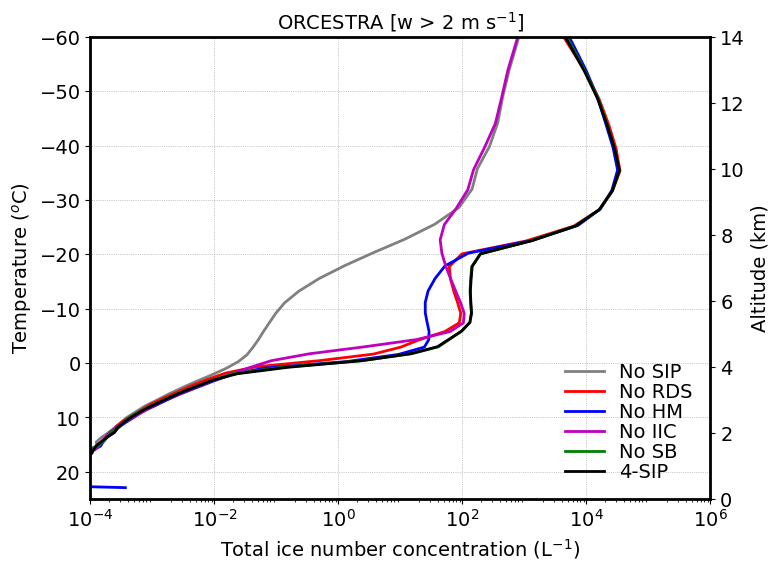

In [88]:


fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))


plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_up_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_up_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_up_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_up_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_up_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_inc_up_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_inc_up_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA [w > 2 m s$^{-1}$]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.show()


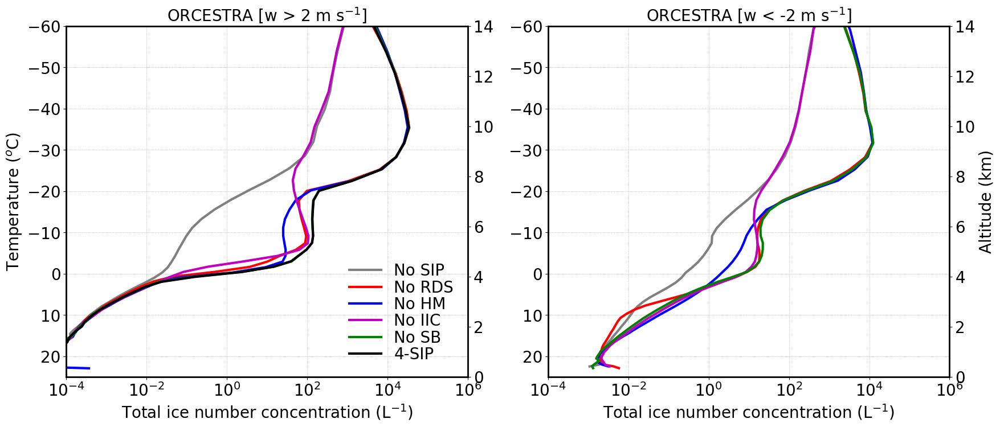

In [86]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_up_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_up_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_up_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_up_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_up_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_inc_up_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_inc_up_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA [w > 2 m s$^{-1}$]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_dn_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_dn_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_dn_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_dn_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_dn_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(mean_tot_inc_dn_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [w < -2 m s$^{-1}$]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


### Mass and number mixing ratios of hydrometeors

In [12]:

thres_q = 1.e-12

mean_qc_4sip = ds_4sip.qc.where(ds_4sip.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_4sip = ds_4sip.qr.where(ds_4sip.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_4sip = ds_4sip.qi.where(ds_4sip.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_4sip = ds_4sip.qs.where(ds_4sip.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_4sip = ds_4sip.qg.where(ds_4sip.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_4sip = ds_4sip.qh.where(ds_4sip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_4sip, mean_qr_4sip, mean_qi_4sip, mean_qs_4sip, mean_qg_4sip, mean_qh_4sip]
numpy_variables = [var.values for var in variables]

mean_qc_4sip = numpy_variables[0]
mean_qr_4sip = numpy_variables[1]
mean_qi_4sip = numpy_variables[2]
mean_qs_4sip = numpy_variables[3]
mean_qg_4sip = numpy_variables[4]
mean_qh_4sip = numpy_variables[5]

mean_qnc_4sip = ds_4sip.qnc.where(ds_4sip.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_4sip = ds_4sip.qnr.where(ds_4sip.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_4sip = ds_4sip.qni.where(ds_4sip.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_4sip = ds_4sip.qns.where(ds_4sip.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_4sip = ds_4sip.qng.where(ds_4sip.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_4sip = ds_4sip.qnh.where(ds_4sip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_4sip, mean_qnr_4sip, mean_qni_4sip, mean_qns_4sip, mean_qng_4sip, mean_qnh_4sip]
numpy_variables = [var.values for var in variables]

mean_qnc_4sip = numpy_variables[0]
mean_qnr_4sip = numpy_variables[1]
mean_qni_4sip = numpy_variables[2]
mean_qns_4sip = numpy_variables[3]
mean_qng_4sip = numpy_variables[4]
mean_qnh_4sip = numpy_variables[5]


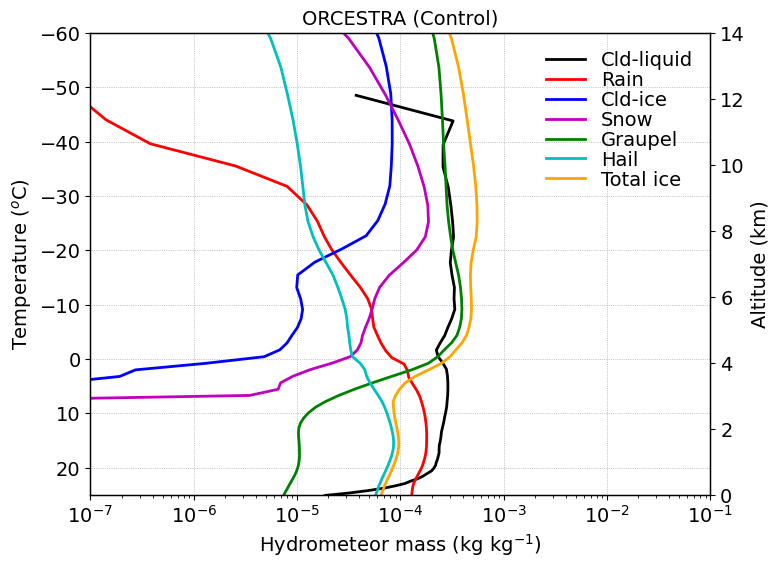

In [39]:

mean_tqi_4sip = np.nansum([mean_qi_4sip,mean_qs_4sip,mean_qg_4sip,mean_qh_4sip], axis=0)

fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-7, 1.e-1)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()


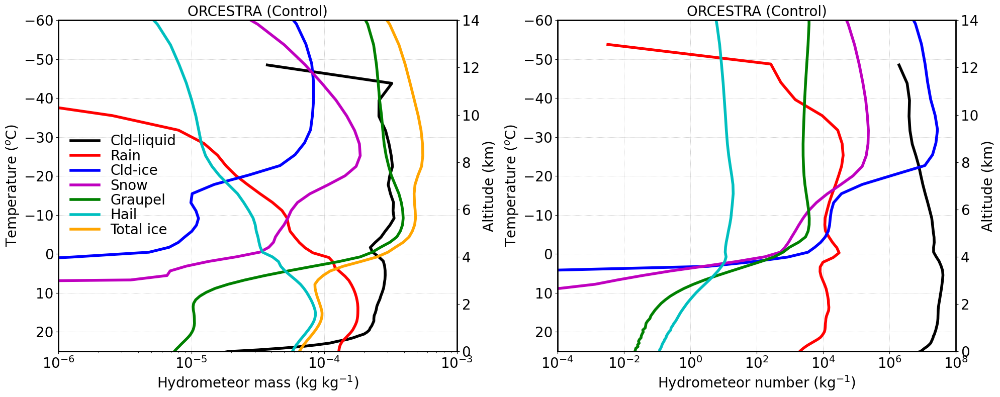

In [27]:

mean_tqi_4sip = np.nansum([mean_qi_4sip,mean_qs_4sip,mean_qg_4sip,mean_qh_4sip], axis=0)


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-6, 1.e-3)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e8)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


In [12]:

thres_q = 1.e-12

mean_qc_nosip = ds_nosip.qc.where(ds_nosip.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nosip = ds_nosip.qr.where(ds_nosip.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nosip = ds_nosip.qi.where(ds_nosip.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nosip = ds_nosip.qs.where(ds_nosip.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nosip = ds_nosip.qg.where(ds_nosip.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nosip = ds_nosip.qh.where(ds_nosip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nosip, mean_qr_nosip, mean_qi_nosip, mean_qs_nosip, mean_qg_nosip, mean_qh_nosip]
numpy_variables = [var.values for var in variables]

mean_qc_nosip = numpy_variables[0]
mean_qr_nosip = numpy_variables[1]
mean_qi_nosip = numpy_variables[2]
mean_qs_nosip = numpy_variables[3]
mean_qg_nosip = numpy_variables[4]
mean_qh_nosip = numpy_variables[5]

mean_qnc_nosip = ds_nosip.qnc.where(ds_nosip.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nosip = ds_nosip.qnr.where(ds_nosip.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nosip = ds_nosip.qni.where(ds_nosip.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nosip = ds_nosip.qns.where(ds_nosip.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nosip = ds_nosip.qng.where(ds_nosip.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nosip = ds_nosip.qnh.where(ds_nosip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nosip, mean_qnr_nosip, mean_qni_nosip, mean_qns_nosip, mean_qng_nosip, mean_qnh_nosip]
numpy_variables = [var.values for var in variables]

mean_qnc_nosip = numpy_variables[0]
mean_qnr_nosip = numpy_variables[1]
mean_qni_nosip = numpy_variables[2]
mean_qns_nosip = numpy_variables[3]
mean_qng_nosip = numpy_variables[4]
mean_qnh_nosip = numpy_variables[5]


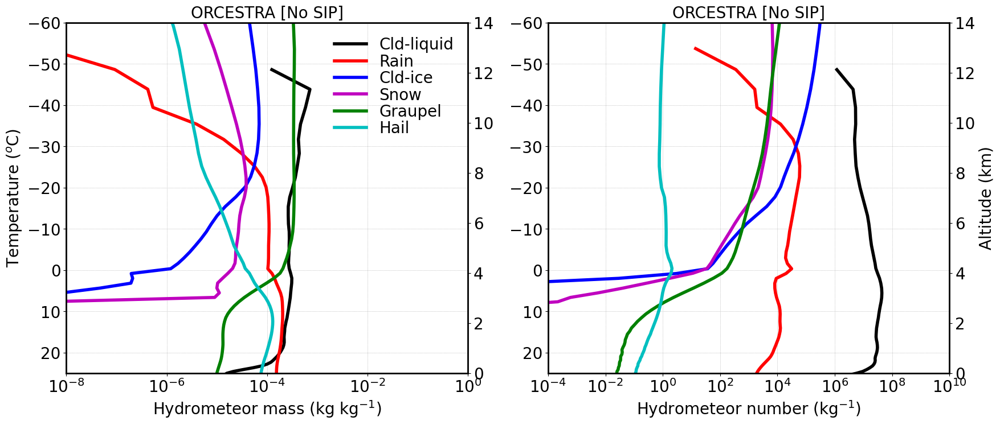

In [13]:


mean_tqi_nosip = np.nansum([mean_qi_nosip,mean_qs_nosip,mean_qg_nosip,mean_qh_nosip], axis=0)

fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nosip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nosip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nosip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nosip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nosip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nosip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_nosip*fact, mean_tempc_nosip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_nosip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nosip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nosip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nosip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nosip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nosip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nosip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nosip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [No SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


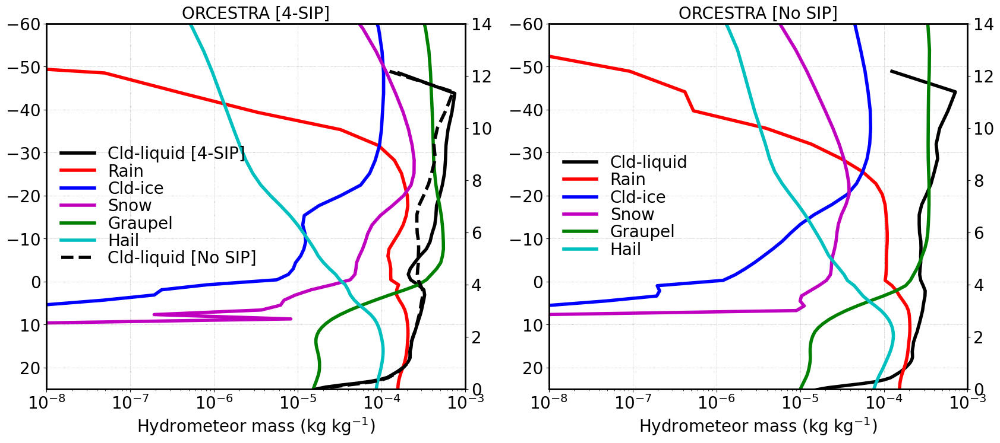

In [26]:

mean_tqi_4sip = np.nansum([mean_qi_4sip,mean_qs_4sip,mean_qg_4sip,mean_qh_4sip], axis=0)
mean_tqi_nosip = np.nansum([mean_qi_nosip,mean_qs_nosip,mean_qg_nosip,mean_qh_nosip], axis=0)

fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Cld-liquid [4-SIP]')
plt1.plot(mean_qr_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt1.plot(mean_qc_4sip*fact, mean_tempc_4sip, 'k--', linewidth=lnwdth, label='Cld-liquid [No SIP]')

plt2.plot(mean_qh_4sip*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e-3)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [4-SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)



plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nosip*fact, mean_tempc_nosip, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nosip*fact, mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nosip*fact, mean_tempc_nosip, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nosip*fact, mean_tempc_nosip, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nosip*fact, mean_tempc_nosip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nosip*fact, mean_tempc_nosip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_nosip*fact, mean_tempc_nosip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_4sip*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e-3)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [30]:
print(mean_tempc_4sip)
print(mean_qc_nosip-mean_qc_4sip)
print()
print(100*(mean_qc_nosip-mean_qc_4sip)/mean_qc_4sip)

[-64.11463    -71.0595     -79.17266    -76.77152    -72.620636
 -68.711105   -64.192184   -58.8995     -53.580677   -48.532993
 -43.778416   -39.382874   -35.339413   -31.642221   -28.245401
 -25.187431   -22.452347   -19.996225   -17.65675    -15.365664
 -13.184917   -11.161037    -9.274622    -7.5398364   -5.9204917
  -4.3918433   -2.9827352   -1.66251     -0.40766516   0.74917555
   1.9210182    3.1262739    4.341495     5.5112567    6.62047
   7.685756     8.7003975    9.67859     10.628353    11.552832
  12.435058    13.263919    14.050942    14.816273    15.542435
  16.222034    16.879282    17.523832    18.146746    18.75318
  19.331327    19.88926     20.413582    20.91575     21.390892
  21.853464    22.300392    22.751839    23.197172    23.640087
  24.088024    24.53992     24.98477     25.388887    25.748495  ]
[            nan             nan             nan             nan
             nan             nan             nan             nan
             nan -3.61723796e-05 -

In [89]:
thres_q = 1.e-12

mean_qc_norf = ds_norf.qc.where(ds_norf.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_norf = ds_norf.qr.where(ds_norf.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_norf = ds_norf.qi.where(ds_norf.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_norf = ds_norf.qs.where(ds_norf.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_norf = ds_norf.qg.where(ds_norf.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_norf = ds_norf.qh.where(ds_norf.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_norf, mean_qr_norf, mean_qi_norf, mean_qs_norf, mean_qg_norf, mean_qh_norf]
numpy_variables = [var.values for var in variables]

mean_qc_norf = numpy_variables[0]
mean_qr_norf = numpy_variables[1]
mean_qi_norf = numpy_variables[2]
mean_qs_norf = numpy_variables[3]
mean_qg_norf = numpy_variables[4]
mean_qh_norf = numpy_variables[5]

mean_qnc_norf = ds_norf.qnc.where(ds_norf.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_norf = ds_norf.qnr.where(ds_norf.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_norf = ds_norf.qni.where(ds_norf.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_norf = ds_norf.qns.where(ds_norf.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_norf = ds_norf.qng.where(ds_norf.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_norf = ds_norf.qnh.where(ds_norf.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_norf, mean_qnr_norf, mean_qni_norf, mean_qns_norf, mean_qng_norf, mean_qnh_norf]
numpy_variables = [var.values for var in variables]

mean_qnc_norf = numpy_variables[0]
mean_qnr_norf = numpy_variables[1]
mean_qni_norf = numpy_variables[2]
mean_qns_norf = numpy_variables[3]
mean_qng_norf = numpy_variables[4]
mean_qnh_norf = numpy_variables[5]

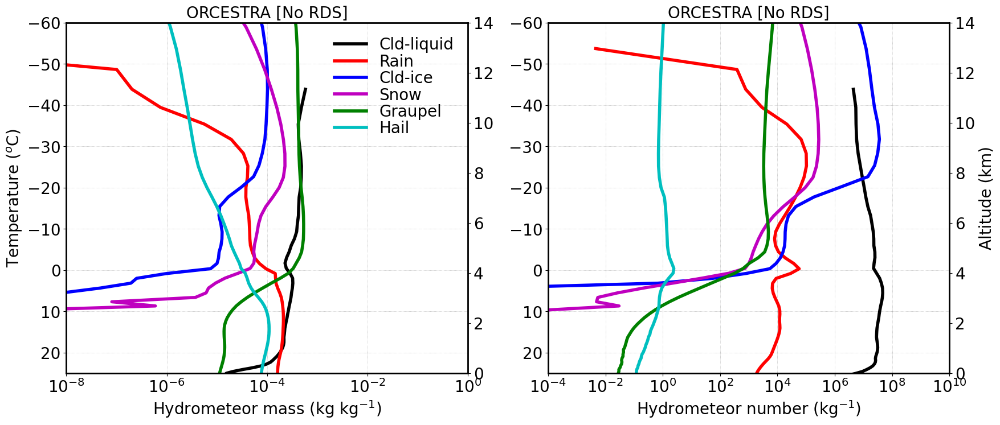

In [90]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_norf*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_norf*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_norf*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_norf*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_norf*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_norf*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_norf*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No RDS]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_norf*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_norf*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_norf*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_norf*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_norf*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_norf*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_norf*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [No RDS]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [91]:
thres_q = 1.e-12

mean_qc_nohm = ds_nohm.qc.where(ds_nohm.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nohm = ds_nohm.qr.where(ds_nohm.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nohm = ds_nohm.qi.where(ds_nohm.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nohm = ds_nohm.qs.where(ds_nohm.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nohm = ds_nohm.qg.where(ds_nohm.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nohm = ds_nohm.qh.where(ds_nohm.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nohm, mean_qr_nohm, mean_qi_nohm, mean_qs_nohm, mean_qg_nohm, mean_qh_nohm]
numpy_variables = [var.values for var in variables]

mean_qc_nohm = numpy_variables[0]
mean_qr_nohm = numpy_variables[1]
mean_qi_nohm = numpy_variables[2]
mean_qs_nohm = numpy_variables[3]
mean_qg_nohm = numpy_variables[4]
mean_qh_nohm = numpy_variables[5]

mean_qnc_nohm = ds_nohm.qnc.where(ds_nohm.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nohm = ds_nohm.qnr.where(ds_nohm.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nohm = ds_nohm.qni.where(ds_nohm.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nohm = ds_nohm.qns.where(ds_nohm.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nohm = ds_nohm.qng.where(ds_nohm.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nohm = ds_nohm.qnh.where(ds_nohm.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nohm, mean_qnr_nohm, mean_qni_nohm, mean_qns_nohm, mean_qng_nohm, mean_qnh_nohm]
numpy_variables = [var.values for var in variables]

mean_qnc_nohm = numpy_variables[0]
mean_qnr_nohm = numpy_variables[1]
mean_qni_nohm = numpy_variables[2]
mean_qns_nohm = numpy_variables[3]
mean_qng_nohm = numpy_variables[4]
mean_qnh_nohm = numpy_variables[5]

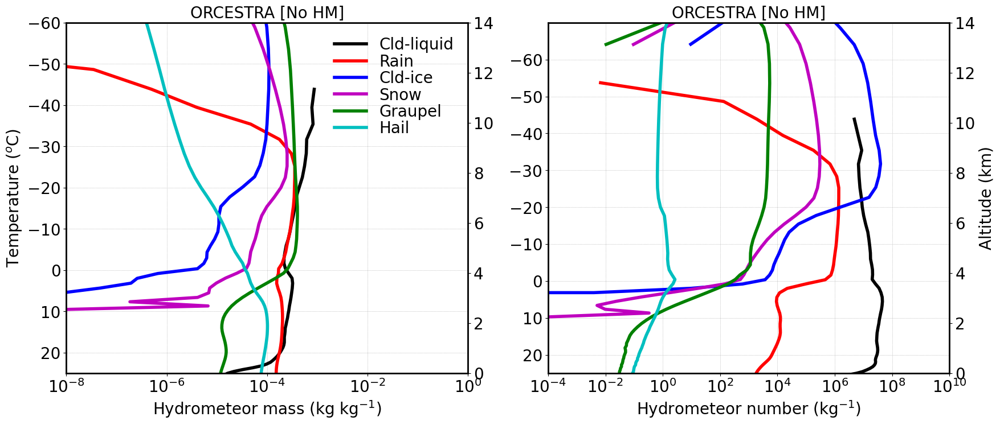

In [92]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nohm*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nohm*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nohm*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nohm*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nohm*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nohm*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nohm*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No HM]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nohm*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nohm*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nohm*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nohm*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nohm*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nohm*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nohm*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [No HM]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [93]:
thres_q = 1.e-12

mean_qc_nobr = ds_nobr.qc.where(ds_nobr.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nobr = ds_nobr.qr.where(ds_nobr.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nobr = ds_nobr.qi.where(ds_nobr.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nobr = ds_nobr.qs.where(ds_nobr.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nobr = ds_nobr.qg.where(ds_nobr.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nobr = ds_nobr.qh.where(ds_nobr.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nobr, mean_qr_nobr, mean_qi_nobr, mean_qs_nobr, mean_qg_nobr, mean_qh_nobr]
numpy_variables = [var.values for var in variables]

mean_qc_nobr = numpy_variables[0]
mean_qr_nobr = numpy_variables[1]
mean_qi_nobr = numpy_variables[2]
mean_qs_nobr = numpy_variables[3]
mean_qg_nobr = numpy_variables[4]
mean_qh_nobr = numpy_variables[5]

mean_qnc_nobr = ds_nobr.qnc.where(ds_nobr.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nobr = ds_nobr.qnr.where(ds_nobr.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nobr = ds_nobr.qni.where(ds_nobr.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nobr = ds_nobr.qns.where(ds_nobr.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nobr = ds_nobr.qng.where(ds_nobr.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nobr = ds_nobr.qnh.where(ds_nobr.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nobr, mean_qnr_nobr, mean_qni_nobr, mean_qns_nobr, mean_qng_nobr, mean_qnh_nobr]
numpy_variables = [var.values for var in variables]

mean_qnc_nobr = numpy_variables[0]
mean_qnr_nobr = numpy_variables[1]
mean_qni_nobr = numpy_variables[2]
mean_qns_nobr = numpy_variables[3]
mean_qng_nobr = numpy_variables[4]
mean_qnh_nobr = numpy_variables[5]


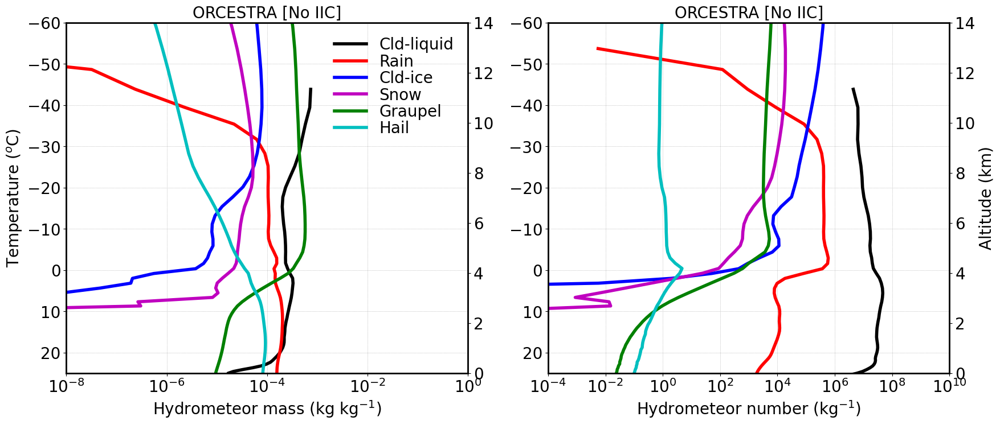

In [94]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nobr*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nobr*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nobr*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nobr*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nobr*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nobr*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nobr*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No IIC]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nobr*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nobr*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nobr*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nobr*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nobr*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nobr*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nobr*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [No IIC]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [95]:
thres_q = 1.e-12

mean_qc_nosb = ds_nosb.qc.where(ds_nosb.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nosb = ds_nosb.qr.where(ds_nosb.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nosb = ds_nosb.qi.where(ds_nosb.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nosb = ds_nosb.qs.where(ds_nosb.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nosb = ds_nosb.qg.where(ds_nosb.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nosb = ds_nosb.qh.where(ds_nosb.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nosb, mean_qr_nosb, mean_qi_nosb, mean_qs_nosb, mean_qg_nosb, mean_qh_nosb]
numpy_variables = [var.values for var in variables]

mean_qc_nosb = numpy_variables[0]
mean_qr_nosb = numpy_variables[1]
mean_qi_nosb = numpy_variables[2]
mean_qs_nosb = numpy_variables[3]
mean_qg_nosb = numpy_variables[4]
mean_qh_nosb = numpy_variables[5]

mean_qnc_nosb = ds_nosb.qnc.where(ds_nosb.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nosb = ds_nosb.qnr.where(ds_nosb.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nosb = ds_nosb.qni.where(ds_nosb.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nosb = ds_nosb.qns.where(ds_nosb.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nosb = ds_nosb.qng.where(ds_nosb.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nosb = ds_nosb.qnh.where(ds_nosb.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nosb, mean_qnr_nosb, mean_qni_nosb, mean_qns_nosb, mean_qng_nosb, mean_qnh_nosb]
numpy_variables = [var.values for var in variables]

mean_qnc_nosb = numpy_variables[0]
mean_qnr_nosb = numpy_variables[1]
mean_qni_nosb = numpy_variables[2]
mean_qns_nosb = numpy_variables[3]
mean_qng_nosb = numpy_variables[4]
mean_qnh_nosb = numpy_variables[5]

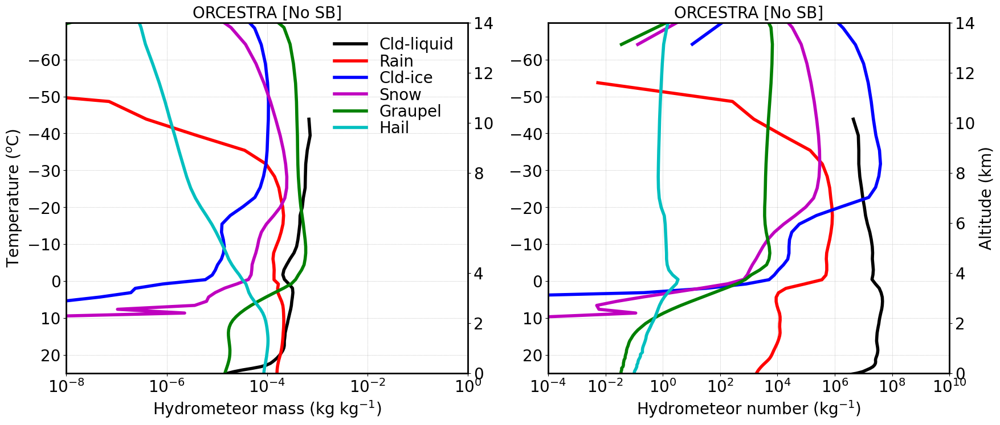

In [96]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nosb*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nosb*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nosb*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nosb*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nosb*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nosb*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No SB]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nosb*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nosb*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nosb*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nosb*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nosb*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nosb*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [No SB]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


# Process rates
### 1. Process rates of SIPs
#### mass and number mixing ratio 

In [29]:

thres_q = 1.e-14

mean_qi_homhet_4sip = ds_4sip.d_qi_homhet.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))
mean_qi_hom_4sip = ds_4sip.d_qi_hom.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))
mean_qi_het_4sip = ds_4sip.d_qi_het.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))

variables = [mean_qi_homhet_4sip, mean_qi_hom_4sip, mean_qi_het_4sip]
numpy_variables = [var.values for var in variables]

mean_qi_homhet_4sip = numpy_variables[0]
mean_qi_hom_4sip = numpy_variables[1]
mean_qi_het_4sip = numpy_variables[2]

mean_qi_tot_sec_4sip = ds_4sip.dqi_sec.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_rf_4sip = ds_4sip.dqi_ds.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_hm_4sip = ds_4sip.dqi_rs.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_br_4sip = ds_4sip.dqi_br.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_snow_4sip = ds_4sip.dqi_snow_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_graup_4sip = ds_4sip.dqi_graup_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_4sip = mean_qi_sb_snow_4sip + mean_qi_sb_graup_4sip

mean_qni_tot_sec_4sip = ds_4sip.dqni_sec.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_rf_4sip = ds_4sip.dqni_ds.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_hm_4sip = ds_4sip.dqni_rs.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_br_4sip = ds_4sip.dqni_br.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_snow_4sip = ds_4sip.dqni_snow_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_graup_4sip = ds_4sip.dqni_graup_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_4sip = mean_qni_sb_snow_4sip + mean_qni_sb_graup_4sip

variables = [mean_qi_tot_sec_4sip, mean_qi_rf_4sip, mean_qi_hm_4sip, mean_qi_br_4sip, mean_qi_sb_4sip]
numpy_variables = [var.values for var in variables]

mean_qi_tot_sec_4sip = numpy_variables[0]
mean_qi_rf_4sip = numpy_variables[1]
mean_qi_hm_4sip = numpy_variables[2]
mean_qi_br_4sip = numpy_variables[3]
mean_qi_sb_4sip = numpy_variables[4]

variables = [mean_qni_tot_sec_4sip, mean_qni_rf_4sip, mean_qni_hm_4sip, mean_qni_br_4sip, mean_qni_sb_4sip]
numpy_variables = [var.values for var in variables]

mean_qni_tot_sec_4sip = numpy_variables[0]
mean_qni_rf_4sip = numpy_variables[1]
mean_qni_hm_4sip = numpy_variables[2]
mean_qni_br_4sip = numpy_variables[3]
mean_qni_sb_4sip = numpy_variables[4]

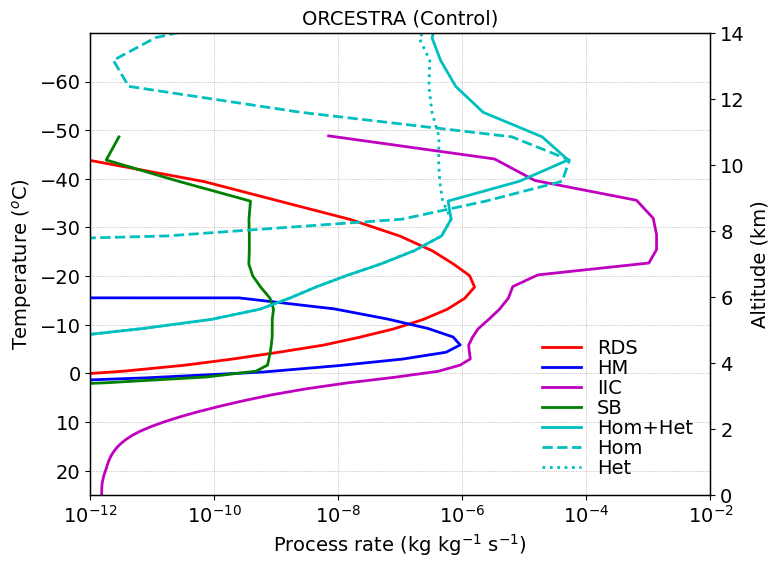

In [30]:
fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))


plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qi_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qi_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qi_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qi_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
#plt1.plot(mean_qi_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')


plt1.plot(mean_qi_homhet_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hom+Het')
plt1.plot(mean_qi_hom_4sip*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')
plt1.plot(mean_qi_het_4sip*fact, mean_tempc_4sip, 'c:', linewidth=lnwdth, label='Het')
#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(mean_qi_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-12, 1.e-2)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

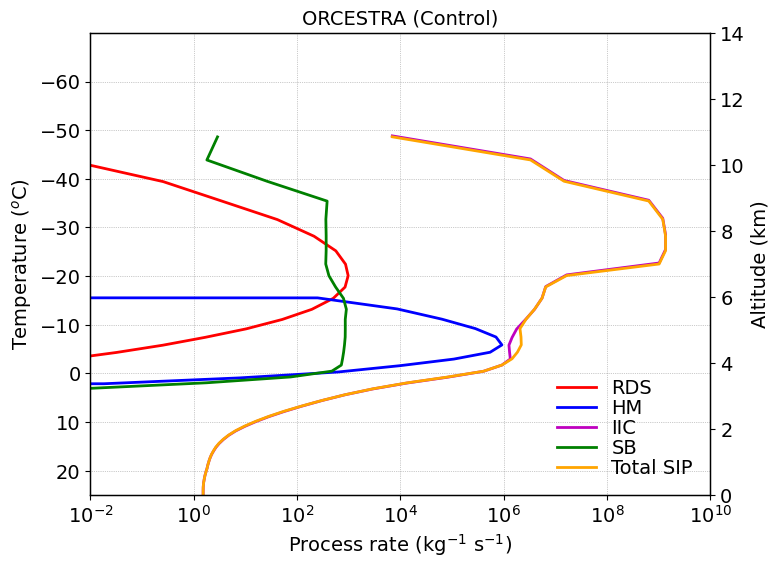

In [33]:
fontsize=14;
lnwdth=2;
alpha=0.6;

mean_qni_tot_sec_4sip = mean_qni_rf_4sip+mean_qni_hm_4sip+mean_qni_br_4sip+mean_qni_sb_4sip

plt.figure(figsize=(8, 6))


plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total SIP')


#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(mean_qni_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-2, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

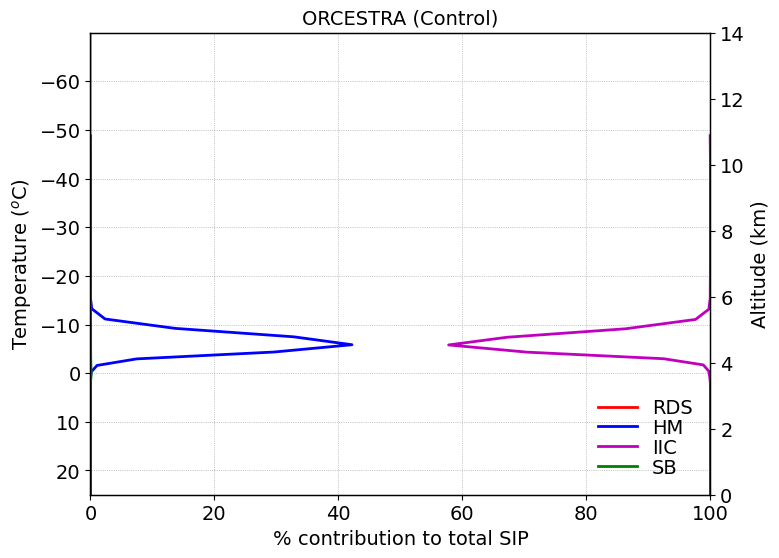

In [38]:
fontsize=14;
lnwdth=2;
alpha=0.6;

mean_qni_tot_sec_4sip = mean_qni_rf_4sip+mean_qni_hm_4sip+mean_qni_br_4sip+mean_qni_sb_4sip

per_qni_rf_4sip = 100*mean_qni_rf_4sip/mean_qni_tot_sec_4sip
per_qni_hm_4sip = 100*mean_qni_hm_4sip/mean_qni_tot_sec_4sip
per_qni_br_4sip = 100*mean_qni_br_4sip/mean_qni_tot_sec_4sip
per_qni_sb_4sip = 100*mean_qni_sb_4sip/mean_qni_tot_sec_4sip

plt.figure(figsize=(8, 6))


plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_qni_rf_4sip, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(per_qni_hm_4sip, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(per_qni_br_4sip, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(per_qni_sb_4sip, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')


#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(per_qni_sb_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

#plt1.set_xscale('log')
plt1.set_xlim(0, 1.e2)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('% contribution to total SIP', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

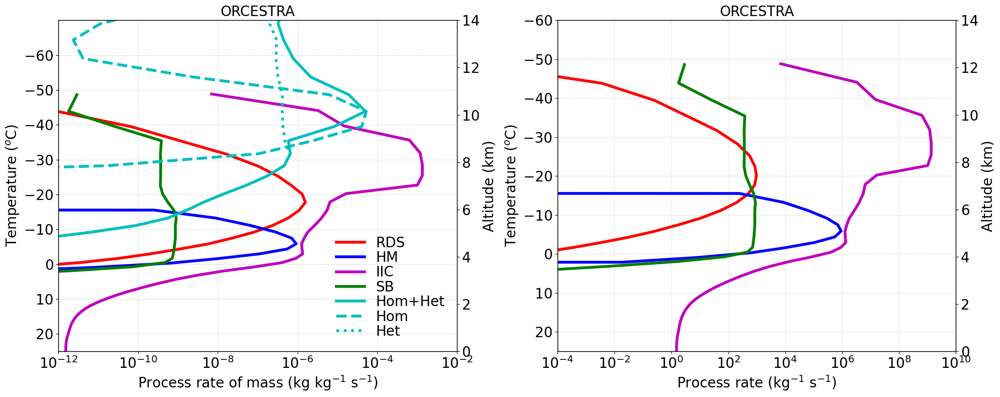

In [112]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qi_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qi_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qi_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qi_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
#plt1.plot(mean_qi_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')


plt1.plot(mean_qi_homhet_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hom+Het')
plt1.plot(mean_qi_hom_4sip*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')
plt1.plot(mean_qi_het_4sip*fact, mean_tempc_4sip, 'c:', linewidth=lnwdth, label='Het')
#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(mean_qi_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-12, 1.e-2)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate of mass (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
#plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_qni_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


## Process rates of riming, deposition, nucleation, freezing

In [13]:

thres_q = 1.e-8

# Riming
mean_dq_tot_rime_4sip = xr.where(ds_4sip.d_qx_riming > thres_q, ds_4sip.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nosip = xr.where(ds_nosip.d_qx_riming > thres_q, ds_nosip.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_norf = xr.where(ds_norf.d_qx_riming > thres_q, ds_norf.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nohm = xr.where(ds_nohm.d_qx_riming > thres_q, ds_nohm.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nobr = xr.where(ds_nobr.d_qx_riming > thres_q, ds_nobr.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nosb = xr.where(ds_nosb.d_qx_riming > thres_q, ds_nosb.d_qx_riming, np.nan).mean(dim=('time','ncells'))

# Deposition
mean_dq_tot_dep_4sip = ds_4sip.d_qi_dep+ds_4sip.d_qs_dep+ds_4sip.d_qg_dep+ds_4sip.d_qh_dep
mean_dq_tot_dep_nosip = ds_nosip.d_qi_dep+ds_nosip.d_qs_dep+ds_nosip.d_qg_dep+ds_nosip.d_qh_dep
mean_dq_tot_dep_norf = ds_norf.d_qi_dep+ds_norf.d_qs_dep+ds_norf.d_qg_dep+ds_norf.d_qh_dep
mean_dq_tot_dep_nohm = ds_nohm.d_qi_dep+ds_nohm.d_qs_dep+ds_nohm.d_qg_dep+ds_nohm.d_qh_dep
mean_dq_tot_dep_nobr = ds_nobr.d_qi_dep+ds_nobr.d_qs_dep+ds_nobr.d_qg_dep+ds_nobr.d_qh_dep
mean_dq_tot_dep_nosb = ds_nosb.d_qi_dep+ds_nosb.d_qs_dep+ds_nosb.d_qg_dep+ds_nosb.d_qh_dep

mean_dq_tot_dep_4sip = xr.where(mean_dq_tot_dep_4sip > thres_q, mean_dq_tot_dep_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nosip = xr.where(mean_dq_tot_dep_nosip > thres_q, mean_dq_tot_dep_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_norf = xr.where(mean_dq_tot_dep_norf > thres_q, mean_dq_tot_dep_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nohm = xr.where(mean_dq_tot_dep_nohm > thres_q, mean_dq_tot_dep_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nobr = xr.where(mean_dq_tot_dep_nobr > thres_q, mean_dq_tot_dep_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nosb = xr.where(mean_dq_tot_dep_nosb > thres_q, mean_dq_tot_dep_nosb, np.nan).mean(dim=('time','ncells'))

# Saturation adjustment
mean_dq_satad1_4sip = xr.where(ds_4sip.d_satad > thres_q, ds_4sip.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nosip = xr.where(ds_nosip.d_satad > thres_q, ds_nosip.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_norf = xr.where(ds_norf.d_satad > thres_q, ds_norf.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nohm = xr.where(ds_nohm.d_satad > thres_q, ds_nohm.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nobr = xr.where(ds_nobr.d_satad > thres_q, ds_nobr.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nosb = xr.where(ds_nosb.d_satad > thres_q, ds_nosb.d_satad, np.nan).mean(dim=('time','ncells'))

mean_dq_satad2_4sip = xr.where(ds_4sip.d_satad2 > thres_q, ds_4sip.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nosip = xr.where(ds_nosip.d_satad2 > thres_q, ds_nosip.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_norf = xr.where(ds_norf.d_satad2 > thres_q, ds_norf.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nohm = xr.where(ds_nohm.d_satad2 > thres_q, ds_nohm.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nobr = xr.where(ds_nobr.d_satad2 > thres_q, ds_nobr.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nosb = xr.where(ds_nosb.d_satad2 > thres_q, ds_nosb.d_satad2, np.nan).mean(dim=('time','ncells'))

# Hom+het ice nucleation
mean_dq_homhet_4sip = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nosip = xr.where(ds_nosip.d_qi_homhet > thres_q, ds_nosip.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_norf = xr.where(ds_norf.d_qi_homhet > thres_q, ds_norf.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nohm = xr.where(ds_nohm.d_qi_homhet > thres_q, ds_nohm.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nobr = xr.where(ds_nobr.d_qi_homhet > thres_q, ds_nobr.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nosb = xr.where(ds_nosb.d_qi_homhet > thres_q, ds_nosb.d_qi_homhet, np.nan).mean(dim=('time','ncells'))

# Hom ice nucleation
mean_dq_hom_4sip = xr.where(ds_4sip.d_qi_hom > thres_q, ds_4sip.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nosip = xr.where(ds_nosip.d_qi_hom > thres_q, ds_nosip.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_norf = xr.where(ds_norf.d_qi_hom > thres_q, ds_norf.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nohm = xr.where(ds_nohm.d_qi_hom > thres_q, ds_nohm.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nobr = xr.where(ds_nobr.d_qi_hom > thres_q, ds_nobr.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nosb = xr.where(ds_nosb.d_qi_hom > thres_q, ds_nosb.d_qi_hom, np.nan).mean(dim=('time','ncells'))

# het ice nucleation
mean_dq_het_4sip = xr.where(ds_4sip.d_qi_het > thres_q, ds_4sip.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nosip = xr.where(ds_nosip.d_qi_het > thres_q, ds_nosip.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_norf = xr.where(ds_norf.d_qi_het > thres_q, ds_norf.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nohm = xr.where(ds_nohm.d_qi_het > thres_q, ds_nohm.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nobr = xr.where(ds_nobr.d_qi_het > thres_q, ds_nobr.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nosb = xr.where(ds_nosb.d_qi_het > thres_q, ds_nosb.d_qi_het, np.nan).mean(dim=('time','ncells'))

# Rain freezing
mean_dq_rainfreez_4sip = ds_4sip.d_qr_rf+ds_4sip.d_qs_rf+ds_4sip.d_qg_rf+ds_4sip.d_qh_rf
mean_dq_rainfreez_nosip = ds_nosip.d_qr_rf+ds_nosip.d_qs_rf+ds_nosip.d_qg_rf+ds_nosip.d_qh_rf
mean_dq_rainfreez_norf = ds_norf.d_qr_rf+ds_norf.d_qs_rf+ds_norf.d_qg_rf+ds_norf.d_qh_rf
mean_dq_rainfreez_nohm = ds_nohm.d_qr_rf+ds_nohm.d_qs_rf+ds_nohm.d_qg_rf+ds_nohm.d_qh_rf
mean_dq_rainfreez_nobr = ds_nobr.d_qr_rf+ds_nobr.d_qs_rf+ds_nobr.d_qg_rf+ds_nobr.d_qh_rf
mean_dq_rainfreez_nosb = ds_nosb.d_qr_rf+ds_nosb.d_qs_rf+ds_nosb.d_qg_rf+ds_nosb.d_qh_rf

mean_dq_rainfreez_4sip = xr.where(mean_dq_rainfreez_4sip > thres_q, mean_dq_rainfreez_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nosip = xr.where(mean_dq_rainfreez_nosip > thres_q, mean_dq_rainfreez_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_norf = xr.where(mean_dq_rainfreez_norf > thres_q, mean_dq_rainfreez_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nohm = xr.where(mean_dq_rainfreez_nohm > thres_q, mean_dq_rainfreez_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nobr = xr.where(mean_dq_rainfreez_nobr > thres_q, mean_dq_rainfreez_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nosb = xr.where(mean_dq_rainfreez_nosb > thres_q, mean_dq_rainfreez_nosb, np.nan).mean(dim=('time','ncells'))

# Evaporation
mean_dq_evap_4sip = ds_4sip.d_qr_evap+ds_4sip.d_qsgh_evap
mean_dq_evap_nosip = ds_nosip.d_qr_evap+ds_nosip.d_qsgh_evap
mean_dq_evap_norf = ds_norf.d_qr_evap+ds_norf.d_qsgh_evap
mean_dq_evap_nohm = ds_nohm.d_qr_evap+ds_nohm.d_qsgh_evap
mean_dq_evap_nobr = ds_nobr.d_qr_evap+ds_nobr.d_qsgh_evap
mean_dq_evap_nosb = ds_nosb.d_qr_evap+ds_nosb.d_qsgh_evap

mean_dq_evap_4sip = xr.where(mean_dq_evap_4sip > thres_q, mean_dq_evap_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nosip = xr.where(mean_dq_evap_nosip > thres_q, mean_dq_evap_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_norf = xr.where(mean_dq_evap_norf > thres_q, mean_dq_evap_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nohm = xr.where(mean_dq_evap_nohm > thres_q, mean_dq_evap_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nobr = xr.where(mean_dq_evap_nobr > thres_q, mean_dq_evap_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nosb = xr.where(mean_dq_evap_nosb > thres_q, mean_dq_evap_nosb, np.nan).mean(dim=('time','ncells'))

# Melting
mean_dq_melt_4sip = ds_4sip.d_qc_melt+ds_4sip.d_qr_melt
mean_dq_melt_nosip = ds_nosip.d_qc_melt+ds_nosip.d_qr_melt
mean_dq_melt_norf = ds_norf.d_qc_melt+ds_norf.d_qr_melt
mean_dq_melt_nohm = ds_nohm.d_qc_melt+ds_nohm.d_qr_melt
mean_dq_melt_nobr = ds_nobr.d_qc_melt+ds_nobr.d_qr_melt
mean_dq_melt_nosb = ds_nosb.d_qc_melt+ds_nosb.d_qr_melt

mean_dq_melt_4sip = xr.where(mean_dq_melt_4sip > thres_q, mean_dq_melt_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nosip = xr.where(mean_dq_melt_nosip > thres_q, mean_dq_melt_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_norf = xr.where(mean_dq_melt_norf > thres_q, mean_dq_melt_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nohm = xr.where(mean_dq_melt_nohm > thres_q, mean_dq_melt_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nobr = xr.where(mean_dq_melt_nobr > thres_q, mean_dq_melt_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nosb = xr.where(mean_dq_melt_nosb > thres_q, mean_dq_melt_nosb, np.nan).mean(dim=('time','ncells'))

# Nucleation

mean_dq_nuc_4sip = xr.where(ds_4sip.d_qc_nuc > thres_q, ds_4sip.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nosip = xr.where(ds_nosip.d_qc_nuc > thres_q, ds_nosip.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_norf = xr.where(ds_norf.d_qc_nuc > thres_q, ds_norf.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nohm = xr.where(ds_nohm.d_qc_nuc > thres_q, ds_nohm.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nobr = xr.where(ds_nobr.d_qc_nuc > thres_q, ds_nobr.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nosb = xr.where(ds_nosb.d_qc_nuc > thres_q, ds_nosb.d_qc_nuc, np.nan).mean(dim=('time','ncells'))


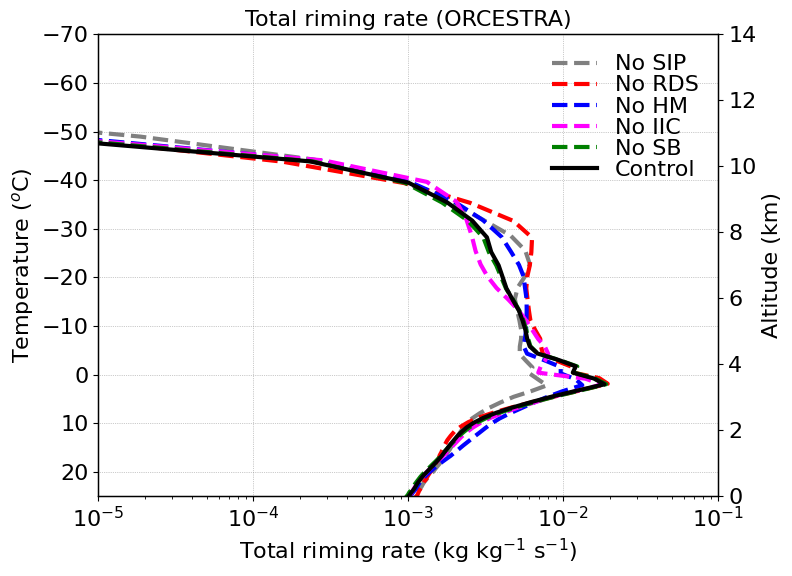

In [14]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_tot_rime_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_tot_rime_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_tot_rime_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_tot_rime_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_tot_rime_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_tot_rime_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_tot_rime_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)#, label='Control') 

#plt2.plot(mean_tot_inc_up_caipeex*fact, mean_ht_4sip_caipeex, '-', color='none', linewidth=lnwdth)#, label='No SB')
#plt2.plot(mean_tot_inc_up_dcmex*fact, mean_ht_4sip_dcmex, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_mc3e*fact, mean_ht_4sip_mc3e, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_orcestra*fact, mean_ht_4sip_orcestra, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_steps*fact, mean_ht_4sip_steps, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
#plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total riming rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total riming rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

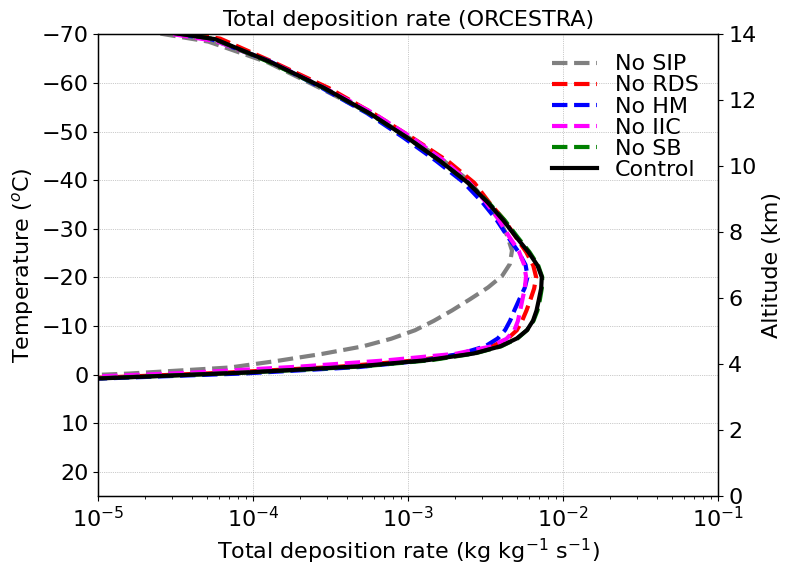

In [16]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_tot_dep_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_tot_dep_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_tot_dep_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_tot_dep_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_tot_dep_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_tot_dep_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_tot_dep_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total deposition rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total deposition rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

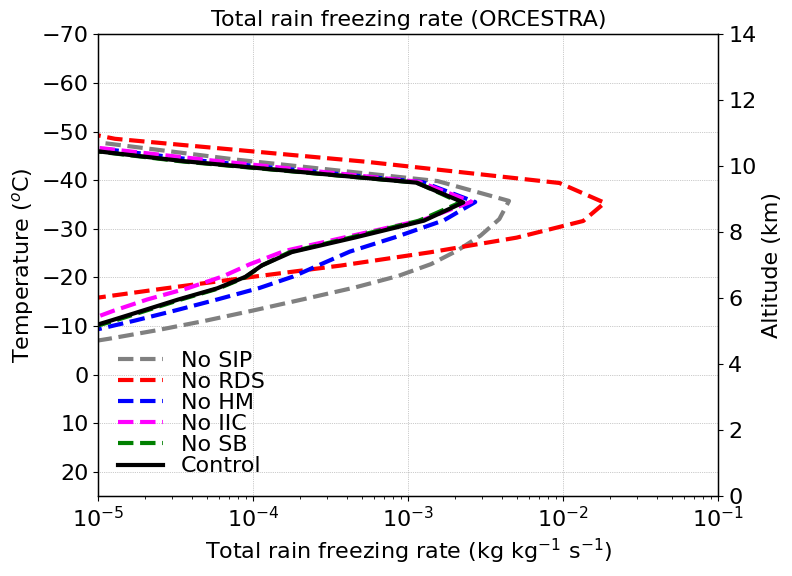

In [17]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_rainfreez_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_rainfreez_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_rainfreez_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_rainfreez_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_rainfreez_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_rainfreez_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_rainfreez_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total rain freezing rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total rain freezing rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

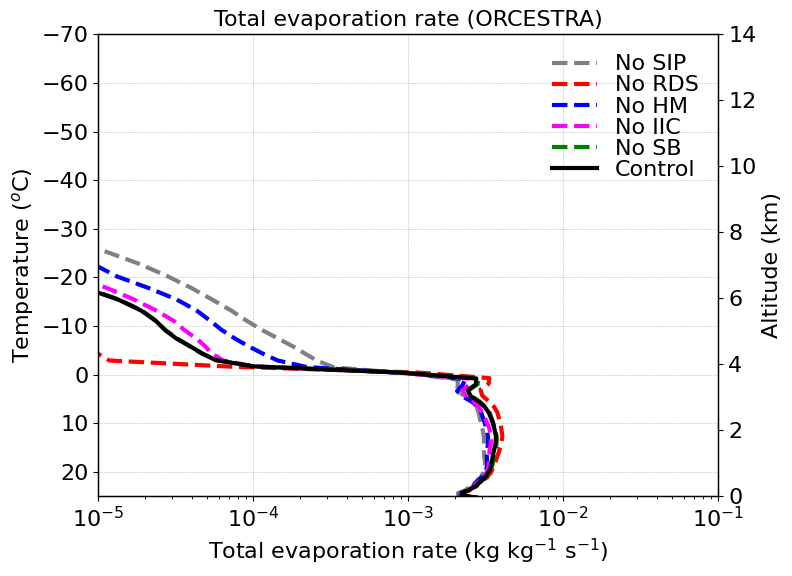

In [18]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_evap_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_evap_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_evap_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_evap_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_evap_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_evap_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_evap_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total evaporation rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total evaporation rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

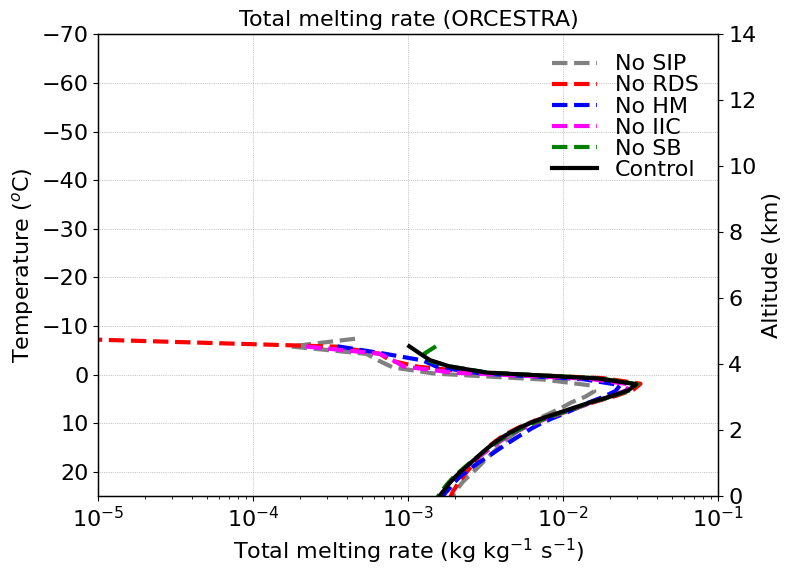

In [19]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_melt_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_melt_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_melt_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_melt_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_melt_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_melt_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_melt_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total melting rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total melting rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

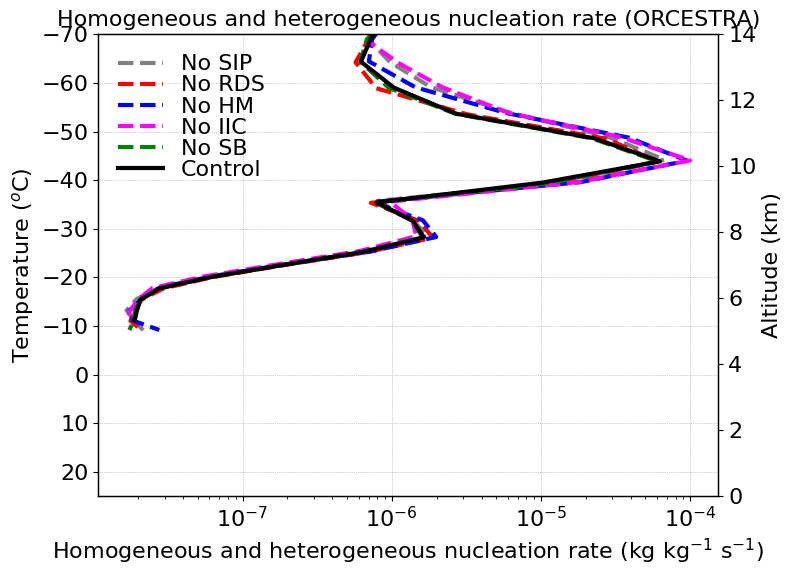

In [21]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_homhet_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_homhet_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_homhet_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_homhet_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_homhet_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_homhet_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_homhet_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)#, label='Control')

#plt2.plot(mean_tot_inc_up_caipeex*fact, mean_ht_4sip_caipeex, '-', color='none', linewidth=lnwdth)#, label='No SB')
#plt2.plot(mean_tot_inc_up_dcmex*fact, mean_ht_4sip_dcmex, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_mc3e*fact, mean_ht_4sip_mc3e, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_orcestra*fact, mean_ht_4sip_orcestra, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_steps*fact, mean_ht_4sip_steps, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
#plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
#plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Homogeneous and heterogeneous nucleation rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Homogeneous and heterogeneous nucleation rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

In [7]:

def calc_dewpoint(tempc, rh):
    dewpoint = tempc - ((100. - rh)/5.)
    return dewpoint


def calc_tdew(t, rh):        # Magnus-Tetens approximation
    a = 17.27; b = 237.7;
    alpha = (a*t/(b+t)) + np.log(rh/100)
    td = b*alpha/(a-alpha)
    return td
    
def calc_vir_temp(tc, q):
    #virt_tempk_wk = t/(1. - (ev/p)*(1-0.622))
    temp = tc + (1-0.622*q)
    return temp
    
def calculate_lcl(pressure, temperature, dewpoint):
    l = np.argmin(np.abs(temperature - dewpoint))
    return pressure[l], temperature[l]

def calc_lcl(t, td):
    lcl = td + 125.*(t-td)
    return lcl
    
def e_sat_hpa(tc):
    e_sat_pa = 6.112*np.exp((17.67*tc)/(tc+243.5))
    return e_sat_pa

def calc_parcel_temp(pres, ht, q_sat, tk_lcl):
    grav = 9.8  # acceleration due to gravity [m/s^2]
    eps = 0.622  # ratio of the gas constants for water vapor and dry air
    Rd = 287.  # specific gas constant for dry air [J/(kg*K)]
    cp = 1005.  # specific heat capacity at constant pressure for dry air [J/(kg*K)]
    lv = 2.5e6  # latent heat of vaporization [J/kg]
    Rv = 461.  # specific gas constant for water vapor [J/(kg*K)]

    tk_parcel = np.zeros(len(ht))  
    del_t_par = np.zeros(len(ht))  

    tk_parcel[0] = tk_lcl + 273.15 
    
    for i in range(1, len(ht)):
        dht = ht[i] - ht[i - 1]  
        qs = q_sat[i]  
        term_a = 1. + lv * qs / (Rd * tk_parcel[i - 1])
        term_b = (lv ** 2.) * eps * qs
        term_c = Rd * (tk_parcel[i - 1]) ** 2.
        
        del_t_par[i] = grav * term_a / (cp + (term_b / term_c))

        tk_parcel[i] = tk_parcel[i - 1] - del_t_par[i] * dht
        
    tempc = tk_parcel - 273.15
    return tempc

import numpy as np



def calc_cape(pres, t_env, t_par, tv_env, tv_par):
    """
    Calculate Convective Available Potential Energy (CAPE).
    
    Parameters:
        pres (array): Pressure levels (hPa or Pa).
        t_env (array): Environmental temperature (°C).
        t_par (array): Parcel temperature (°C).
        tv_env (array): Environmental virtual temperature (°C).
        tv_par (array): Parcel virtual temperature (°C).
    
    Returns:
        cape (float): CAPE value (J/kg).
    """
    Rd = 287.0  # gas constant for dry air (J/kg/K)
    
    # Convert temperatures to Kelvin
    tk_env = t_env + 273.15
    tk_v_env = tv_env + 273.15
    tk_par = t_par + 273.15
    tk_v_par = tv_par + 273.15
    
    cape = 0.0
    
    # Loop through pressure levels
    for i in range(1, len(pres)):
        # Check if parcel is warmer than the environment
        if tk_v_par[i] > tk_v_env[i]:
            # Calculate logarithmic pressure difference
            dlnp = np.log(pres[i-1] / pres[i])
            cape = cape + Rd * (tk_v_par[i] - tk_v_env[i]) * dlnp
    return cape
        

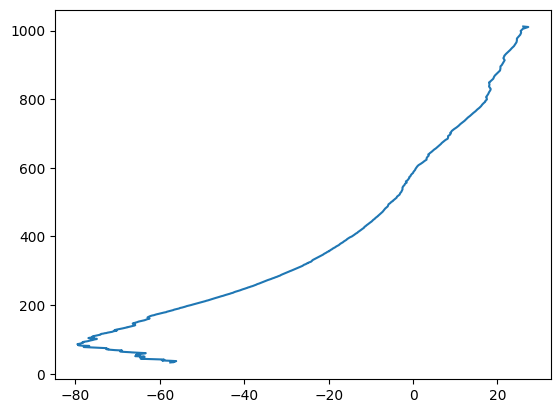

In [20]:
file_path = '/work/bk1415/b382718/output/orcestra/observations/wyoming_sonde/sonde_orcestra_20240903_1200UTC'
column_names = ['pres', 'height', 'temp', 'Tdew', 'relhum', 'qv', 'w_dir', 'w_wind', 'theta', 'theta_e', 'theta_v']


# Specify invalid values (strings or other markers for missing data)
invalid_values = ['-----------------------------------------------------------------------------', '9999.0', '999.0']

# Read the data and replace invalid values with NaN
ds_sonde = pd.read_csv(file_path, sep='\s+', skiprows=6, names=column_names, na_values=invalid_values)

# drop rows with NaN values if needed
ds_sonde.dropna(inplace=True)


temp_sonde = ds_sonde.temp.values
pres_sonde = ds_sonde.pres.values
tdew_sonde = ds_sonde.Tdew.values
rh_sonde = ds_sonde.relhum.values
qv_sonde = ds_sonde.qv.values
w_sonde = ds_sonde.w_wind.values
ht_sonde = ds_sonde.height.values

plt.plot(temp_sonde, pres_sonde)

In [12]:
ds_4sip.time[24]

<xarray.DataArray 'time' ()>
array('2024-09-03T12:00:00.000000000', dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 2024-09-03T12:00:00
Attributes:
    standard_name:  time
    axis:           T

Tenv    ::  [ 25.472301   25.102497   24.697054   24.264956   23.847887   23.441639
  23.044283   22.65701    22.262733   21.851585   21.42618    20.985214
  20.5164     20.013956   19.469633   18.894772   18.294472   17.667616
  17.003273   16.33308    15.616732   14.869071   14.097094   13.298925
  12.463171   11.583893   10.66444     9.718272    8.737001    7.729309
   6.6857643   5.6324406   4.5390754   3.3691444   2.157193    0.9753825
  -0.1675019  -1.4445887  -2.7727835  -4.1448     -5.607413   -7.155437
  -8.803791  -10.689388  -12.701304  -14.897587  -17.16448   -19.48239
 -21.997797  -24.785824  -27.889805  -31.305443  -34.981346  -38.979004
 -43.344913  -48.040936  -53.05474   -58.342712  -63.43048   -67.92141
 -72.30739   -76.134026  -78.61002   -70.58618   -63.699135 ]
Tparcel ::  [ 2.34416389e+01  2.33515918e+01  2.32197732e+01  2.30573637e+01
  2.28685845e+01  2.26558342e+01  2.24206675e+01  2.21641810e+01
  2.18870746e+01  2.15897641e+01  2.12725122e+01  2.09354437e+01


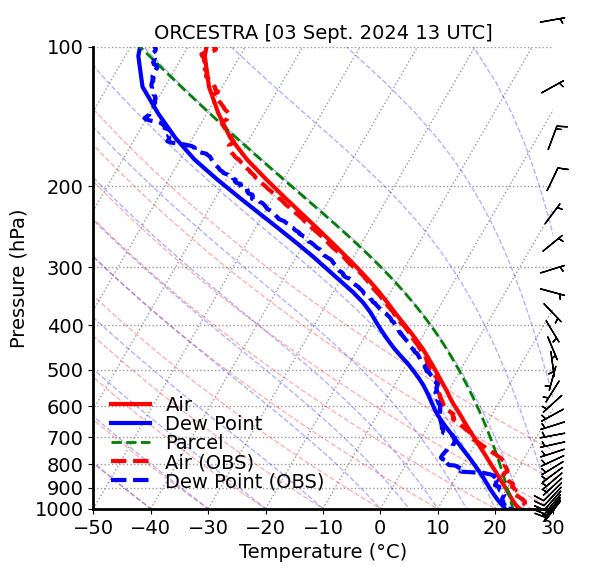

In [22]:

ds_skewt = ds_4sip.sel(time=ds_4sip.time[24])

tempc = ds_skewt.temp-273.15 #.values
pres_pa = ds_skewt.pres #.values
ht_m = ds_skewt.z_mc
rel_hum = ds_skewt.rh #.values
u_wind = ds_skewt.u
v_wind = ds_skewt.v
q_vap = ds_skewt.qv

   
temp_dew = calc_dewpoint(tempc, rel_hum)
#temp_dew = calc_tdew(tempc, rel_hum)

avg_tempc = tempc.mean(dim=('ncells')).values
avg_dewtempc = temp_dew.mean(dim=('ncells')).values
avg_pres = 0.01*pres_pa.mean(dim=('ncells')).values
avg_ht = ht_m.mean(dim=('ncells')).values
avg_rh = rel_hum.mean(dim=('ncells')).values
avg_qv = q_vap.mean(dim=('ncells')).values

avg_u = u_wind.mean(dim=('ncells')).values
avg_v = v_wind.mean(dim=('ncells')).values

avg_tempc = avg_tempc[::-1]
avg_dewtempc = avg_dewtempc[::-1]
avg_pres = avg_pres[::-1]
avg_ht = avg_ht[::-1]
avg_rh = avg_rh[::-1]
avg_u = avg_u[::-1]
avg_v = avg_v[::-1]
avg_qv = avg_qv[::-1]

#----- Calculate parcel properties
e_sat = e_sat_hpa(avg_tempc)
q_sat = 0.622*e_sat/(avg_pres-e_sat)

lcl_pressure, lcl_temp = calculate_lcl(avg_pres, avg_tempc, avg_dewtempc)
#lcl_temp = calc_lcl(avg_tempc[0], avg_dewtempc)
parcel_temp = calc_parcel_temp(avg_pres, avg_ht, 1.5*q_sat, lcl_temp)
Tv_env = calc_vir_temp(avg_tempc, avg_qv)
Tv_parcel = calc_vir_temp(parcel_temp, 1.5*q_sat)
parcel_cape = calc_cape(avg_pres, avg_tempc, parcel_temp, Tv_env, Tv_parcel)
print('Tenv    :: ', avg_tempc)
print('Tparcel :: ', parcel_temp)
print('LCL :: ', lcl_temp)
print('CAPE :: ',parcel_cape)
#------

# Create the Skew-T plot
fontsize=14;
lnwdth=3;
alpha=0.3;

fig = plt.figure(figsize=(8, 6))
skew = SkewT(fig)

# Plot temperature and dew point on the Skew-T
skew.plot(avg_pres, avg_tempc, 'r-', label='Air', linewidth=lnwdth)
#skew.plot(avg_pres, calc_dewpoint(avg_tempc, avg_rh), 'b-.', label='Dew Point', linewidth=lnwdth)
skew.plot(avg_pres, avg_dewtempc, 'b-', label='Dew Point', linewidth=lnwdth)
skew.plot(avg_pres, parcel_temp, 'g--', label='Parcel', linewidth=lnwdth-1)

skew.plot(pres_sonde* units.hPa, temp_sonde* units.degC, 'r--', label='Air (OBS)', linewidth=lnwdth)
skew.plot(pres_sonde* units.hPa, tdew_sonde* units.degC, 'b--', label='Dew Point (OBS)', linewidth=lnwdth)

# Add wind barbs 
if 'u' in ds_skewt and 'v' in ds_skewt:
    u_wind = avg_u  # Zonal wind component
    v_wind = avg_v  # Meridional wind component
    skew.plot_barbs(avg_pres[::2], u_wind[::2], v_wind[::2], length=6, color='black', pivot='middle')

# Add the dry and moist adiabats to the plot
skew.plot_dry_adiabats(linewidth=1, alpha=alpha)
skew.plot_moist_adiabats(linewidth=1, alpha=alpha)

ax = skew.ax
ax.set_xlabel('Temperature (°C)', fontsize=fontsize)
ax.set_ylabel('Pressure (hPa)', fontsize=fontsize)
ax.set_xlim(-50, 30)
ax.set_ylim(1000., 100)
ax.tick_params(axis='x', labelsize=fontsize)
ax.tick_params(axis='y', labelsize=fontsize)
plt.title('ORCESTRA [03 Sept. 2024 13 UTC]', fontsize=fontsize)

plt.legend(frameon=False, handlelength=2, labelspacing=0.01, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=1., color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()

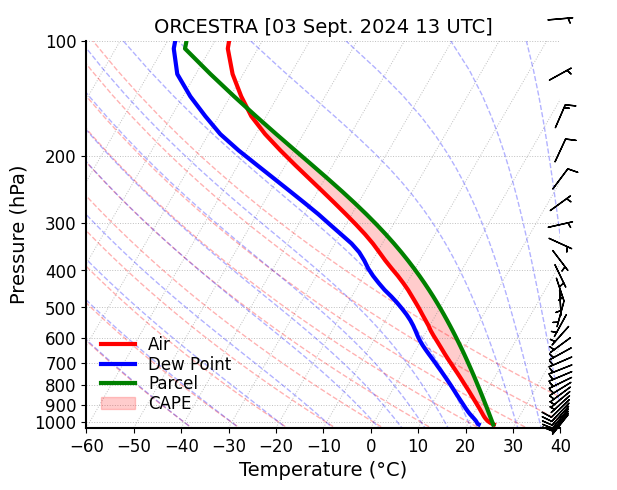

In [87]:
ds_skewt = ds_4sip.sel(time=ds_4sip.time[26])

tempc = ds_skewt.temp-273.15 #.values
pres_pa = ds_skewt.pres #.values
ht_m = ds_skewt.z_mc
rel_hum = ds_skewt.rh #.values
u_wind = ds_skewt.u
v_wind = ds_skewt.v
q_vap = ds_skewt.qv

   
temp_dew = calc_dewpoint(tempc, rel_hum)
#temp_dew = calc_tdew(tempc, rel_hum)

avg_tempc = tempc.mean(dim=('ncells')).values
avg_dewtempc = temp_dew.mean(dim=('ncells')).values
avg_pres = 0.01*pres_pa.mean(dim=('ncells')).values
avg_ht = ht_m.mean(dim=('ncells')).values
avg_rh = rel_hum.mean(dim=('ncells')).values
avg_qv = q_vap.mean(dim=('ncells')).values

avg_u = u_wind.mean(dim=('ncells')).values
avg_v = v_wind.mean(dim=('ncells')).values

avg_tempc = avg_tempc[::-1]
avg_dewtempc = avg_dewtempc[::-1]
avg_pres = avg_pres[::-1]
avg_ht = avg_ht[::-1]
avg_rh = avg_rh[::-1]
avg_u = avg_u[::-1]
avg_v = avg_v[::-1]
avg_qv = avg_qv[::-1]

# Create the Skew-T plot
fontsize=14;
lnwdth=3;
alpha=0.3;

fig = plt.figure(figsize=(8, 5))
skew = SkewT(fig)

skew.plot(avg_pres, avg_tempc, 'r-', label='Air', linewidth=lnwdth)
skew.plot(avg_pres, avg_dewtempc, 'b-', label='Dew Point', linewidth=lnwdth)

skew.plot_dry_adiabats(linewidth=1, alpha=alpha, linestyle='--')
skew.plot_moist_adiabats(linewidth=1, alpha=alpha, linestyle='--')

moist_adiabats = skew.moist_adiabats

# Now, we'll plot parcel path (that follows moist adiabatic line between LFC and LNB)
# We basically skip calculation of parcel temperature and CAPE and make use of the SKEWT plot itself

adiabat_profiles = []
for path in moist_adiabats.get_paths():
    temp_pres = path.vertices
    # We now interpolate temp_pres on available pressure levels
    adiabat_temp = np.interp(avg_pres, 
                           temp_pres[:,1][::-1],  # Pressure values
                           temp_pres[:,0][::-1])  # Temperature values
    adiabat_profiles.append(adiabat_temp)

# Find intersections between environmental temp and moist adiabats (these intersection points are LFC and LNB)
crossing_points = []
for i in range(len(avg_pres)-1):
    for j, adiabat in enumerate(adiabat_profiles):
        if ((avg_tempc[i] > adiabat[i] and avg_tempc[i+1] <= adiabat[i+1]) or 
            (avg_tempc[i] < adiabat[i] and avg_tempc[i+1] >= adiabat[i+1])):
            crossing_points.append((i, j))

# Process crossing points to find LFC and LNB
if len(crossing_points) >= 2:
    # Sort by pressure (descending)
    crossing_points.sort(key=lambda x: avg_pres[x[0]], reverse=True)
    
    lfc_idx, lfc_adiabat_idx = crossing_points[0]
    lnb_idx, lnb_adiabat_idx = crossing_points[-1]
    
    # Create parcel temperature line
    parcel_temp = np.full_like(avg_tempc, np.nan)
    parcel_temp[lfc_idx:lnb_idx+1] = adiabat_profiles[lfc_adiabat_idx][lfc_idx:lnb_idx+1]
    
    # Plot parcel path
    skew.plot(avg_pres, parcel_temp, 'g-', linewidth=lnwdth, label='Parcel')
    
    # Shade CAPE area
    skew.ax.fill_betweenx(avg_pres[lfc_idx:lnb_idx+1],
                        avg_tempc[lfc_idx:lnb_idx+1],
                        parcel_temp[lfc_idx:lnb_idx+1],
                        where=parcel_temp[lfc_idx:lnb_idx+1] > avg_tempc[lfc_idx:lnb_idx+1],
                        color='red', alpha=0.2, label='CAPE')

    # Mark LFC and LNB
    skew.plot(avg_pres[lfc_idx], avg_tempc[lfc_idx], 'k', markersize=10, markeredgewidth=2)#, label='LFC')
    skew.plot(avg_pres[lnb_idx], avg_tempc[lnb_idx], 'k', markersize=10, markeredgewidth=2)#, label='LNB')
    
    # Add text labels
    #plt.text(avg_tempc[lfc_idx]-2, avg_pres[lfc_idx]-10, 'LFC', 
    #        fontsize=fontsize-2, ha='right', va='top')
    #plt.text(avg_tempc[lnb_idx]+2, avg_pres[lnb_idx]+10, 'LNB', 
    #        fontsize=fontsize-2, ha='left', va='bottom')

# Add wind barbs if available
if 'u' in ds_skewt and 'v' in ds_skewt:
    u_wind = avg_u  # Zonal wind component
    v_wind = avg_v  # Meridional wind component
    skew.plot_barbs(avg_pres[::2], u_wind[::2], v_wind[::2], length=6, color='black', pivot='middle')

# Configure plot appearance
ax = skew.ax
ax.set_xlabel('Temperature (°C)', fontsize=fontsize)
ax.set_ylabel('Pressure (hPa)', fontsize=fontsize)
ax.set_xlim(-60, 40)
ax.set_ylim(avg_pres[0]+20, 100)
ax.tick_params(axis='both', labelsize=fontsize-2)

plt.title('ORCESTRA [03 Sept. 2024 13 UTC]', fontsize=fontsize)#, pad=20)

plt.legend(frameon=False, handlelength=2, labelspacing=0.1, fontsize=fontsize-2, loc='lower left')#, bbox_to_anchor=(0.7, 0.95))

plt.grid(True, linestyle=':', linewidth=0.7, color='grey', alpha=0.5)

# Clean up borders
for spine in ax.spines.values():
    spine.set_linewidth(1.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


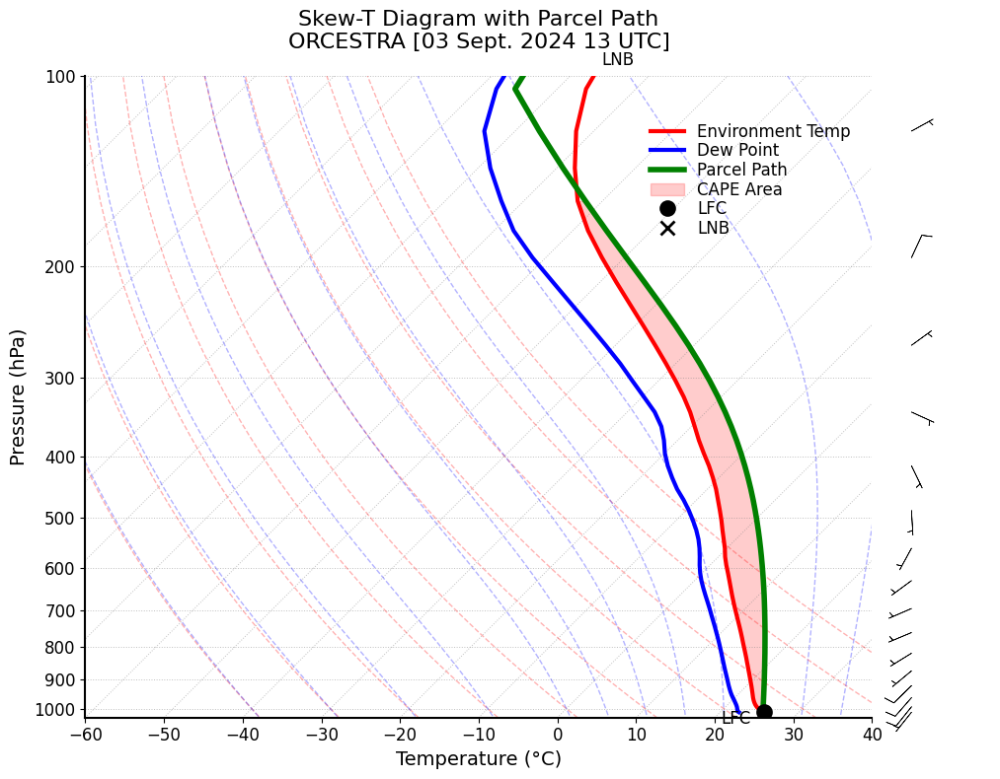

In [77]:
import numpy as np
import matplotlib.pyplot as plt
from metpy.plots import SkewT

# Assuming you've already calculated these arrays from your dataset:
# avg_pres, avg_tempc, avg_dewtempc, etc.

# Create the Skew-T plot
fontsize = 14
lnwdth = 3
alpha = 0.3

fig = plt.figure(figsize=(10, 8))
skew = SkewT(fig, rotation=45)

# Plot environmental temperature and dew point
skew.plot(avg_pres, avg_tempc, 'r-', label='Environment Temp', linewidth=lnwdth)
skew.plot(avg_pres, avg_dewtempc, 'b-', label='Dew Point', linewidth=lnwdth)

# Add adiabats (must plot them first to access later)
skew.plot_dry_adiabats(linewidth=1, alpha=alpha, linestyle='--')
skew.plot_moist_adiabats(linewidth=1, alpha=alpha, linestyle='--')

# Get moist adiabats from the plot
moist_adiabats = skew.moist_adiabats

# Extract temperature values from adiabat paths
adiabat_profiles = []
for path in moist_adiabats.get_paths():
    temp_pres = path.vertices
    # Interpolate to our pressure levels (pressure is y-axis)
    adiabat_temp = np.interp(avg_pres, 
                           temp_pres[:,1][::-1],  # Pressure values
                           temp_pres[:,0][::-1])  # Temperature values
    adiabat_profiles.append(adiabat_temp)

# Find intersections between environmental temp and moist adiabats
crossing_points = []
for i in range(len(avg_pres)-1):
    for j, adiabat in enumerate(adiabat_profiles):
        if ((avg_tempc[i] > adiabat[i] and avg_tempc[i+1] <= adiabat[i+1]) or 
            (avg_tempc[i] < adiabat[i] and avg_tempc[i+1] >= adiabat[i+1])):
            crossing_points.append((i, j))

# Process crossing points to find LFC and LNB
if len(crossing_points) >= 2:
    # Sort by pressure (descending)
    crossing_points.sort(key=lambda x: avg_pres[x[0]], reverse=True)
    
    lfc_idx, lfc_adiabat_idx = crossing_points[0]
    lnb_idx, lnb_adiabat_idx = crossing_points[-1]
    
    # Create parcel temperature line
    parcel_temp = np.full_like(avg_tempc, np.nan)
    parcel_temp[lfc_idx:lnb_idx+1] = adiabat_profiles[lfc_adiabat_idx][lfc_idx:lnb_idx+1]
    
    # Plot parcel path
    skew.plot(avg_pres, parcel_temp, 'g-', linewidth=lnwdth+1, label='Parcel Path')
    
    # Shade CAPE area
    skew.ax.fill_betweenx(avg_pres[lfc_idx:lnb_idx+1],
                        avg_tempc[lfc_idx:lnb_idx+1],
                        parcel_temp[lfc_idx:lnb_idx+1],
                        where=parcel_temp[lfc_idx:lnb_idx+1] > avg_tempc[lfc_idx:lnb_idx+1],
                        color='red', alpha=0.2, label='CAPE Area')
    
    # Mark LFC and LNB
    skew.plot(avg_pres[lfc_idx], avg_tempc[lfc_idx], 'ko', 
             markersize=10, markeredgewidth=2, label='LFC')
    skew.plot(avg_pres[lnb_idx], avg_tempc[lnb_idx], 'kx', 
             markersize=10, markeredgewidth=2, label='LNB')
    
    # Add text labels
    plt.text(avg_tempc[lfc_idx]-2, avg_pres[lfc_idx]-10, 'LFC', 
            fontsize=fontsize-2, ha='right', va='top')
    plt.text(avg_tempc[lnb_idx]+2, avg_pres[lnb_idx]+10, 'LNB', 
            fontsize=fontsize-2, ha='left', va='bottom')

# Add wind barbs if available
if 'avg_u' in locals() and 'avg_v' in locals():
    n = max(1, len(avg_pres)//15)  # Plot every nth level
    skew.plot_barbs(avg_pres[::n], avg_u[::n], avg_v[::n], 
                   xloc=1.05, length=6, linewidth=0.5)

# Configure plot appearance
ax = skew.ax
ax.set_xlabel('Temperature (°C)', fontsize=fontsize)
ax.set_ylabel('Pressure (hPa)', fontsize=fontsize)
ax.set_xlim(-60, 40)
ax.set_ylim(avg_pres[0]+20, 100)
ax.tick_params(axis='both', labelsize=fontsize-2)

plt.title('Skew-T Diagram with Parcel Path\nORCESTRA [03 Sept. 2024 13 UTC]', 
         fontsize=fontsize+2, pad=20)

plt.legend(frameon=False, handlelength=2, labelspacing=0.1, 
          fontsize=fontsize-2, loc='upper left', bbox_to_anchor=(0.7, 0.95))

plt.grid(True, linestyle=':', linewidth=0.7, color='grey', alpha=0.5)

# Clean up borders
for spine in ax.spines.values():
    spine.set_linewidth(1.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


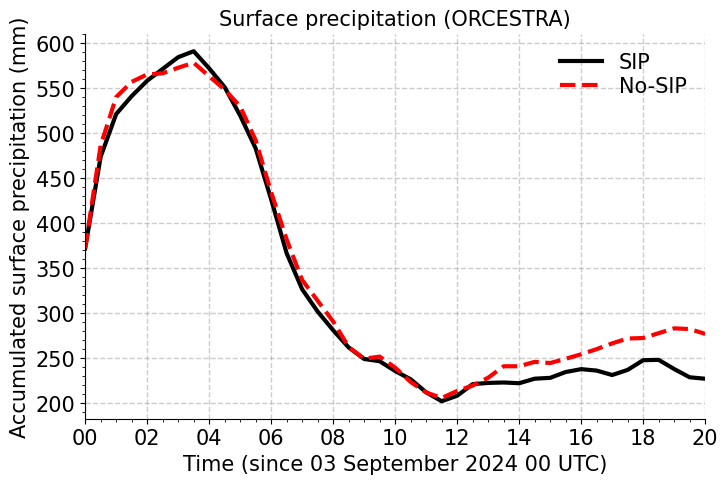

In [21]:

filt_cape = xr.where(ds_nosip_effrad_new.cape_ml > 0., ds_nosip_effrad_new.cape_ml, np.nan)
cape_nosip = filt_cape.mean('ncells')

filt_cape = xr.where(ds_sip_effrad_new.cape_ml > 0., ds_sip_effrad_new.cape_ml, np.nan)
cape_sip = filt_cape.mean('ncells')

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 5))

plt.plot(ds_sip_new.time, cape_sip, "k-", label="SIP", linewidth = lnwdth)
plt.plot(ds_nosip_new.time, cape_nosip, "r--", label="No-SIP", linewidth = lnwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=1, alpha=0.4)
plt.minorticks_on()
plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)
start_date = datetime(2024, 9, 3, 0, 0)
end_date = datetime(2024, 9, 3, 20, 0)
plt.xlim(start_date, end_date)
#plt.ylim(0, 50)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation (ORCESTRA)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper right')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.show()

In [100]:

mean_ht_nosip = ds_nosip.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

mean_ht_4sip = ds_4sip.z_mc.mean(dim=('time','ncells'))
mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

mean_ht_norf = ds_norf.z_mc.mean(dim=('time','ncells'))
mean_tempc_norf = ds_norf.tempc.mean(dim=('time','ncells'))

mean_ht_nohm = ds_nohm.z_mc.mean(dim=('time','ncells'))
mean_tempc_nohm = ds_nohm.tempc.mean(dim=('time','ncells'))

mean_ht_nobr = ds_nobr.z_mc.mean(dim=('time','ncells'))
mean_tempc_nobr = ds_nobr.tempc.mean(dim=('time','ncells'))

#mean_ht_nosb = ds_nosb.z_mc.mean(dim=('time','ncells'))
#mean_tempc_nosb = ds_nosb.tempc.mean(dim=('time','ncells'))

# Latent heating rate with No SIP
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))

# Latent heating rate with 4-SIP
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))

# Latent heating rate with No Raindrop Shattering (RF)
filt_lhr = xr.where((ds_norf.tq > 1.e-6) & (ds_norf.w_vel > w_thres), ds_norf.d_lhr, np.nan)
lhr_kpers_norf = (1./1800.) * np.gradient(ds_norf.d_lhr, axis=0) # w.r.t. time
lhr_kperd_norf = lhr_kpers_norf * 86400.
mean_lhr_kperd_norf = np.mean(lhr_kperd_norf, axis=(0,2))

# Latent heating rate with No Hallett-Mossop (HM)
filt_lhr = xr.where((ds_nohm.tq > 1.e-6) & (ds_nohm.w_vel > w_thres), ds_nohm.d_lhr, np.nan)
lhr_kpers_nohm = (1./1800.) * np.gradient(ds_nohm.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nohm = lhr_kpers_nohm * 86400.
mean_lhr_kperd_nohm = np.mean(lhr_kperd_nohm, axis=(0,2))

# Latent heating rate with No ice-ice collision breakup (BR)
filt_lhr = xr.where((ds_nobr.tq > 1.e-6) & (ds_nobr.w_vel > w_thres), ds_nobr.d_lhr, np.nan)
lhr_kpers_nobr = (1./1800.) * np.gradient(ds_nobr.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nobr = lhr_kpers_nobr * 86400.
mean_lhr_kperd_nobr = np.mean(lhr_kperd_nobr, axis=(0,2))
#
## Latent heating rate with No Sublimation (SB)
#filt_lhr = xr.where((ds_nosb.tq > 1.e-6) & (ds_nosb.w_vel > w_thres), ds_nosb.d_lhr, np.nan)
#lhr_kpers_nosb = (1./1800.) * np.gradient(ds_nosb.d_lhr, axis=0) # w.r.t. time
#lhr_kperd_nosb = lhr_kpers_nosb * 86400.
#mean_lhr_kperd_nosb = np.mean(lhr_kperd_nosb, axis=(0,2))


# Change in lhr w.r.t. control
del_lhr_kperd_nosip = mean_lhr_kperd_4sip-mean_lhr_kperd_nosip
del_lhr_kperd_norf = mean_lhr_kperd_4sip-mean_lhr_kperd_norf
del_lhr_kperd_nohm = mean_lhr_kperd_4sip-mean_lhr_kperd_nohm
del_lhr_kperd_nobr = mean_lhr_kperd_4sip-mean_lhr_kperd_nobr
#del_lhr_kperd_nosb = mean_lhr_kperd_4sip-mean_lhr_kperd_nosb


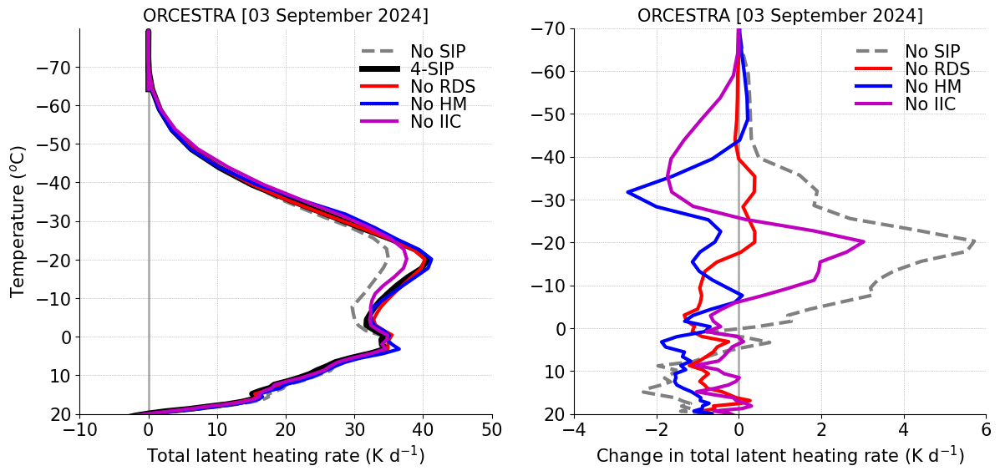

In [101]:

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(14, 6))

plt.subplot(1,2,1)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(mean_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(mean_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(mean_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
#plt.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-10, 50)
plt.ylim(20, -80)
plt.xticks([-10, 0, 10, 20, 30, 40, 50], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 September 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)


plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(del_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(del_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(del_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(del_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
#plt.plot(del_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-4, 6)
plt.ylim(20, -70)
plt.xticks([-4, -2, 0, 2, 4, 6], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Change in total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
#plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 September 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()

plt.show()


In [10]:
ds_4sip

<xarray.Dataset>
Dimensions:         (time: 41, ncells: 73960, vertices: 3, height: 65, bnds: 2,
                     height_2: 66, plev: 1, plev_2: 1, plev_3: 1)
Coordinates:
  * time            (time) datetime64[ns] 2024-09-03 ... 2024-09-03T20:00:00
    clon            (ncells) float64 dask.array<chunksize=(73960,), meta=np.ndarray>
    clat            (ncells) float64 dask.array<chunksize=(73960,), meta=np.ndarray>
  * height          (height) float64 1.0 2.0 3.0 4.0 5.0 ... 62.0 63.0 64.0 65.0
  * height_2        (height_2) float64 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0 66.0
  * plev            (plev) float64 800.0
  * plev_2          (plev_2) float64 400.0
  * plev_3          (plev_3) float64 0.0
Dimensions without coordinates: ncells, vertices, bnds
Data variables: (12/100)
    clon_bnds       (time, ncells, vertices) float64 dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    clat_bnds       (time, ncells, vertices) float64 dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    height_bnds     (time, height, bnds) float64 dask.array<chunksize=(1, 65, 2), meta=np.ndarray>
    plev_bnds       (time, plev, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_2_bnds     (time, plev_2, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_3_bnds     (time, plev_3, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    ...              ...
    tqi             (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    tq              (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    ciwc_gperm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    tiwc_gperm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    cdnc_percm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    inc_perl        (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 2.4.0 (https://mpime...
    Conventions:          CF-1.6
    number_of_grid_used:  99
    uuidOfHGrid:          572c63b4-5951-d138-93bd-61b05c102860
    uuidOfVGrid:          567425a0-32bf-151c-3811-4389b7cd21e0
    institution:          Max Planck Institute for Meteorology/Deutscher Wett...
    title:                ICON simulation
    source:               version: 2024.10; revision: 2a8abec3cefd1c9db62f378...
    history:              /home/b/b382718/icon_orcestra_4sip/icon-oct2024/bin...
    references:           see MPIM/DWD publications
    comment:              Deepak Waman (b382718) on l30683 (Linux 4.18.0-513....

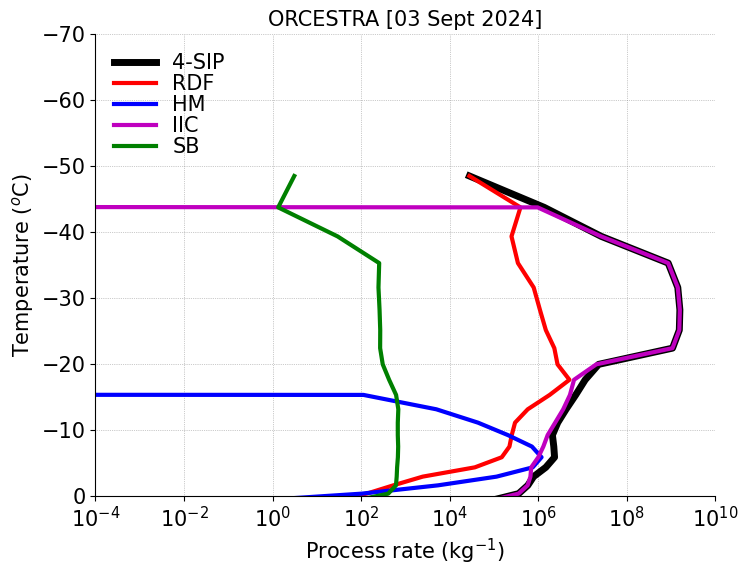

In [22]:

thres_q = 1.e-12
qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_sec, np.nan)
dqi_sec_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_ds, np.nan)
dqi_rf_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_rs, np.nan)
dqi_hm_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_br, np.nan)
dqi_br_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_snow_sbf, np.nan)
dqi_snow_sb = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_graup_sbf, np.nan)
dqi_graup_sb = qi_filt.mean(dim=('time','ncells'))

dqi_tot_sb = dqi_snow_sb + dqi_graup_sb

qi_filt = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan)
dqi_homhet_tot = qi_filt.mean(dim=('time', 'ncells'))


avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))




dqi_sec_tot = dqi_sec_tot.values #where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.values   #where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.values   #where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.values   #where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.values   #where(avg_tempc > -50)
dqi_homhet_tot = dqi_homhet_tot.values
avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(dqi_sec_tot, avg_tempc, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(dqi_rf_tot, avg_tempc, 'r-', linewidth=lnwdth, label='RDF')
plt.plot(dqi_hm_tot, avg_tempc, 'b-', linewidth=lnwdth, label='HM')
plt.plot(dqi_br_tot, avg_tempc, 'm-', linewidth=lnwdth, label='IIC')
plt.plot(dqi_tot_sb, avg_tempc, 'g-', linewidth=lnwdth, label='SB')
#plt.plot(dqi_homhet_tot, avg_tempc, 'c-', linewidth=lnwdth, label='Hom-Het')

plt.xscale('log')
plt.xlim(1.e-4, 1.e10)
plt.ylim(0, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 Sept 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


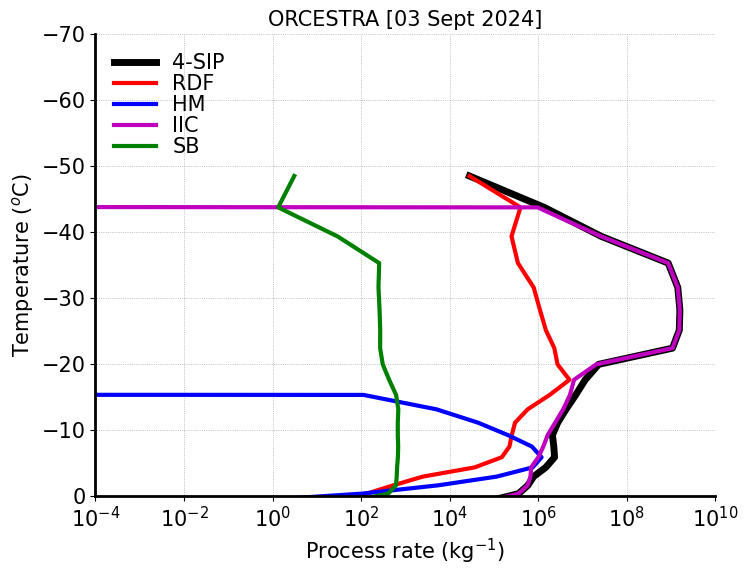

In [26]:

thres_q = 1.e-12
qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_sec, np.nan)
dqi_sec_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_ds, np.nan)
dqi_rf_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_rs, np.nan)
dqi_hm_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_br, np.nan)
dqi_br_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_snow_sbf, np.nan)
dqi_snow_sb = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_graup_sbf, np.nan)
dqi_graup_sb = qi_filt.mean(dim=('time','ncells'))

dqi_tot_sb = dqi_snow_sb + dqi_graup_sb

qi_filt = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan)
dqi_homhet_tot = qi_filt.mean(dim=('time', 'ncells'))


avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))


dqi_sec_tot = dqi_sec_tot.where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.where(avg_tempc > -50)

dqi_sec_tot = dqi_sec_tot.values #where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.values   #where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.values   #where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.values   #where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.values   #where(avg_tempc > -50)
dqi_homhet_tot = dqi_homhet_tot.values
avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;
st = 3
plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(dqi_sec_tot, avg_tempc, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(dqi_rf_tot, avg_tempc, 'r-', linewidth=lnwdth, label='RDF')
plt.plot(dqi_hm_tot, avg_tempc, 'b-', linewidth=lnwdth, label='HM')
plt.plot(dqi_br_tot, avg_tempc, 'm-', linewidth=lnwdth, label='IIC')
plt.plot(dqi_tot_sb, avg_tempc, 'g-', linewidth=lnwdth, label='SB')
#plt.plot(dqi_homhet_tot, avg_tempc, 'c-', linewidth=lnwdth, label='Hom-Het')

plt.xscale('log')
plt.xlim(1.e-4, 1.e10)
plt.ylim(0, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 Sept 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


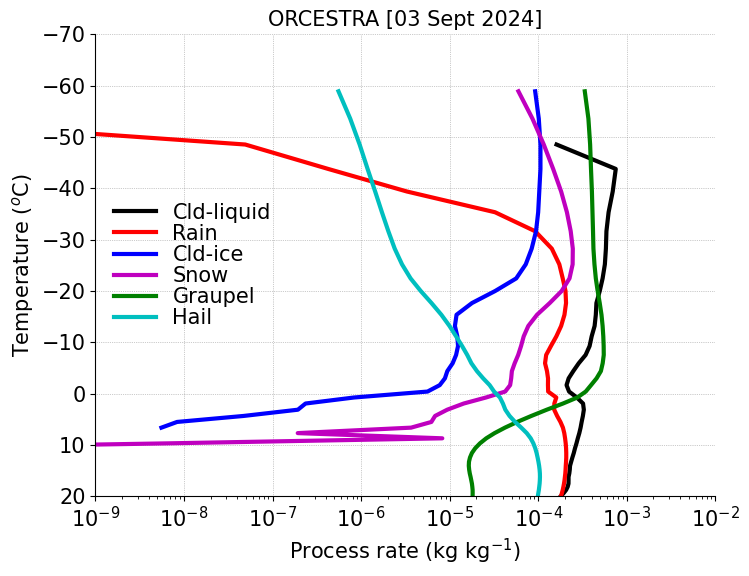

In [25]:

thres_q = 1.e-12
filt_q = xr.where(ds_4sip.qr > thres_q, ds_4sip.qr, np.nan)
avg_qr = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qc > thres_q, ds_4sip.qc, np.nan)
avg_qc = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qi > thres_q, ds_4sip.qi, np.nan)
avg_qi = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qs > thres_q, ds_4sip.qs, np.nan)
avg_qs = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qg > thres_q, ds_4sip.qg, np.nan)
avg_qg = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qh, np.nan)
avg_qh = filt_q.mean(dim=('time','ncells'))

avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

avg_qr = avg_qr.where(avg_tempc > -60)
avg_qc = avg_qc.where(avg_tempc > -60)
avg_qi = avg_qi.where(avg_tempc > -60)
avg_qs = avg_qs.where(avg_tempc > -60)
avg_qg = avg_qg.where(avg_tempc > -60)
avg_qh = avg_qh.where(avg_tempc > -60)

avg_qr = avg_qr.values
avg_qc = avg_qc.values
avg_qi = avg_qi.values
avg_qs = avg_qs.values
avg_qg = avg_qg.values
avg_qh = avg_qh.values

avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(avg_qc, avg_tempc, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt.plot(avg_qr, avg_tempc, 'r-', linewidth=lnwdth, label='Rain')
plt.plot(avg_qi, avg_tempc, 'b-', linewidth=lnwdth, label='Cld-ice')
plt.plot(avg_qs, avg_tempc, 'm-', linewidth=lnwdth, label='Snow')
plt.plot(avg_qg, avg_tempc, 'g-', linewidth=lnwdth, label='Graupel')
plt.plot(avg_qh, avg_tempc, 'c-', linewidth=lnwdth, label='Hail')

plt.xscale('log')
plt.xlim(1.e-9, 1.e-2)
plt.ylim(20, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 Sept 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


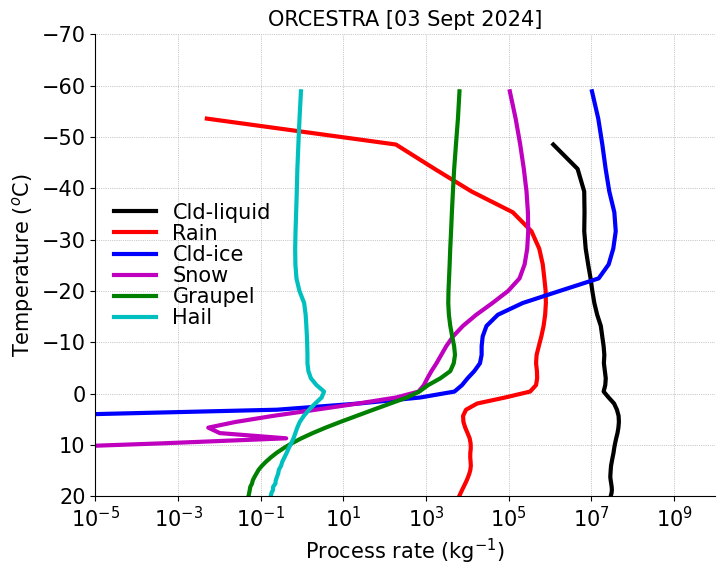

In [24]:

thres_q = 1.e-12
filt_q = xr.where(ds_4sip.qr > thres_q, ds_4sip.qnr, np.nan)
avg_qnr = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qc > thres_q, ds_4sip.qnc, np.nan)
avg_qnc = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qi > thres_q, ds_4sip.qni, np.nan)
avg_qni = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qs > thres_q, ds_4sip.qns, np.nan)
avg_qns = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qg > thres_q, ds_4sip.qng, np.nan)
avg_qng = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qnh, np.nan)
avg_qnh = filt_q.mean(dim=('time','ncells'))

avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

avg_qnr = avg_qnr.where(avg_tempc > -60)
avg_qnc = avg_qnc.where(avg_tempc > -60)
avg_qni = avg_qni.where(avg_tempc > -60)
avg_qns = avg_qns.where(avg_tempc > -60)
avg_qng = avg_qng.where(avg_tempc > -60)
avg_qnh = avg_qnh.where(avg_tempc > -60)

avg_qnr = avg_qnr.values
avg_qnc = avg_qnc.values
avg_qni = avg_qni.values
avg_qns = avg_qns.values
avg_qng = avg_qng.values
avg_qnh = avg_qnh.values

avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(avg_qnc, avg_tempc, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt.plot(avg_qnr, avg_tempc, 'r-', linewidth=lnwdth, label='Rain')
plt.plot(avg_qni, avg_tempc, 'b-', linewidth=lnwdth, label='Cld-ice')
plt.plot(avg_qns, avg_tempc, 'm-', linewidth=lnwdth, label='Snow')
plt.plot(avg_qng, avg_tempc, 'g-', linewidth=lnwdth, label='Graupel')
plt.plot(avg_qnh, avg_tempc, 'c-', linewidth=lnwdth, label='Hail')

plt.xscale('log')
plt.xlim(1.e-5, 1.e10)
plt.ylim(20, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 Sept 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


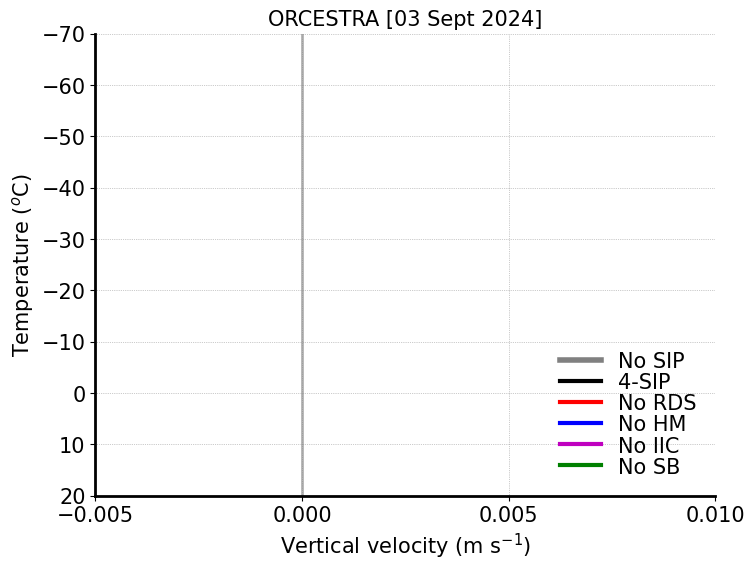

In [27]:

mean_w_up_nosip = ds_nosip.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_4sip = ds_4sip.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_norf = ds_norf.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_nohm = ds_nohm.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_nobr = ds_nobr.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_nosb = ds_nosb.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))

mean_w_dn_nosip = ds_nosip.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_4sip = ds_4sip.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_norf = ds_norf.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_nohm = ds_nohm.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_nobr = ds_nobr.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_nosb = ds_nosb.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))

mean_w_net_nosip = ds_nosip.w_vel.mean(dim=('time','ncells'))
mean_w_net_4sip = ds_4sip.w_vel.mean(dim=('time','ncells'))
mean_w_net_norf = ds_norf.w_vel.mean(dim=('time','ncells'))
mean_w_net_nohm = ds_nohm.w_vel.mean(dim=('time','ncells'))
mean_w_net_nobr = ds_nobr.w_vel.mean(dim=('time','ncells'))
mean_w_net_nosb = ds_nosb.w_vel.mean(dim=('time','ncells'))

mean_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

mean_w_net_nosip = mean_w_net_nosip.where(mean_tempc > -60)
mean_w_net_4sip = mean_w_net_4sip.where(mean_tempc > -60)
mean_w_net_norf = mean_w_net_norf.where(mean_tempc > -60)
mean_w_net_nohm = mean_w_net_nohm.where(mean_tempc > -60)
mean_w_net_nobr = mean_w_net_nobr.where(mean_tempc > -60)
mean_w_net_nosb = mean_w_net_nosb.where(mean_tempc > -60)

mean_w_up_nosip = mean_w_up_nosip.where(mean_tempc > -60)
mean_w_up_4sip = mean_w_up_4sip.where(mean_tempc > -60)
mean_w_up_norf = mean_w_up_norf.where(mean_tempc > -60)
mean_w_up_nohm = mean_w_up_nohm.where(mean_tempc > -60)
mean_w_up_nobr = mean_w_up_nobr.where(mean_tempc > -60)
mean_w_up_nosb = mean_w_up_nosb.where(mean_tempc > -60)

mean_w_dn_nosip = mean_w_dn_nosip.where(mean_tempc > -60)
mean_w_dn_4sip = mean_w_dn_4sip.where(mean_tempc > -60)
mean_w_dn_norf = mean_w_dn_norf.where(mean_tempc > -60)
mean_w_dn_nohm = mean_w_dn_nohm.where(mean_tempc > -60)
mean_w_dn_nobr = mean_w_dn_nobr.where(mean_tempc > -60)
mean_w_dn_nosb = mean_w_dn_nosb.where(mean_tempc > -60)

mean_w_net_nosip = mean_w_net_nosip.values
mean_w_net_4sip = mean_w_net_4sip.values
mean_w_net_norf = mean_w_net_norf.values
mean_w_net_nohm = mean_w_net_nohm.values
mean_w_net_nobr = mean_w_net_nobr.values
mean_w_net_nosb = mean_w_net_nosb.values

mean_w_up_nosip = mean_w_up_nosip.values
mean_w_up_4sip = mean_w_up_4sip.values
mean_w_up_norf = mean_w_up_norf.values
mean_w_up_nohm = mean_w_up_nohm.values
mean_w_up_nobr = mean_w_up_nobr.values
mean_w_up_nosb = mean_w_up_nosb.values

mean_w_dn_nosip = mean_w_dn_nosip.values
mean_w_dn_4sip = mean_w_dn_4sip.values
mean_w_dn_norf = mean_w_dn_norf.values
mean_w_dn_nohm = mean_w_dn_nohm.values
mean_w_dn_nobr = mean_w_dn_nobr.values
mean_w_dn_nosb = mean_w_dn_nosb.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(16, 5))
#plt.subplot(1,2,1)
#plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(mean_w_net_nosip, mean_tempc, '-', color='grey', linewidth=lnwdth+1, label='No SIP')
plt.plot(mean_w_net_4sip, mean_tempc, 'k-', linewidth=lnwdth, label='4-SIP')
plt.plot(mean_w_net_norf, mean_tempc, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(mean_w_net_nohm, mean_tempc, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(mean_w_net_nobr, mean_tempc, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(mean_w_net_nosb, mean_tempc, 'g-', linewidth=lnwdth, label='No SB')

#plt.xlim(-0.005, 0.01)
plt.ylim(20, -70)
plt.xticks(fontsize=fontsize)
#plt.xticks([-0.005, 0., 0.005, 0.01], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 Sept 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()



In [49]:

acc_precip_sip = ds_sip_new.tot_prec.mean('ncells')
acc_precip_nosip = ds_nosip_new.tot_prec.mean('ncells')

filt_cond = (ds_sip_new.tq > 1.e-6) & (ds_sip_new.w_vel > 0.)
filt_wvel = xr.where(filt_cond, ds_sip_new.w_vel, np.nan)
avg_wvel_up_sip = filt_wvel.mean(dim=('time','ncells'))

filt_cond = (ds_sip_new.tq > 1.e-6) & (ds_sip_new.w_vel < 0.)
filt_wvel = xr.where(filt_cond, ds_sip_new.w_vel, np.nan)
avg_wvel_dn_sip = filt_wvel.mean(dim=('time','ncells'))

filt_cond = (ds_nosip_new.tq > 1.e-6) & (ds_nosip_new.w_vel > 0.)
filt_wvel = xr.where(filt_cond, ds_nosip_new.w_vel, np.nan)
avg_wvel_up_nosip = filt_wvel.mean(dim=('time','ncells'))

filt_cond = (ds_nosip_new.tq > 1.e-6) & (ds_nosip_new.w_vel < 0.)
filt_wvel = xr.where(filt_cond, ds_nosip_new.w_vel, np.nan)
avg_wvel_dn_nosip = filt_wvel.mean(dim=('time','ncells'))

del_prec_sip = ds_sip_new.tot_prec.diff('time')
del_prec_nosip = ds_nosip_new.tot_prec.diff('time')
precip_rate_sip = del_prec_sip/0.5            # output is over 30 min
precip_rate_nosip = del_prec_nosip/0.5

precip_rate_sip = precip_rate_sip.mean('ncells')
precip_rate_nosip = precip_rate_nosip.mean('ncells')
#print(acc_precip_sip.max().values)
#print(acc_precip_nosip.max().values)

#print(ds_sip_new.w_vel.max().values)
#print(ds_nosip_new.w_vel.max().values)

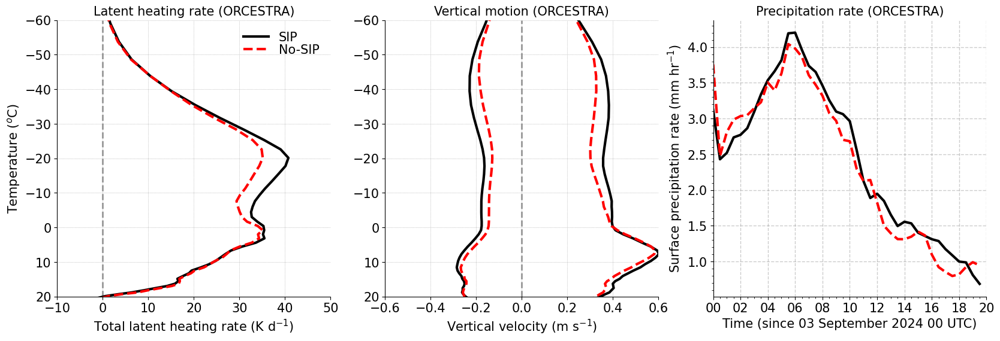

In [50]:
import matplotlib.pyplot as plt
from datetime import datetime
import matplotlib.dates as mdates

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 6))

plt.subplot(1, 3, 1)
plt.axvline(x=0, color='grey', linestyle='--', linewidth=2, alpha=0.8)
plt.plot(mean_lhr_kperday_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth, label='SIP')
plt.plot(mean_lhr_kperday_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth, label='No-SIP')

plt.xlim(-10, 50)
plt.ylim(20, -60)
plt.xticks([-10, 0, 10, 20, 30, 40, 50], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60], fontsize=fontsize)
plt.xlabel('Total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Latent heating rate (ORCESTRA)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.subplot(1, 3, 2)
plt.axvline(x=0, color='grey', linestyle='--', linewidth=2, alpha=0.8)

plt.plot(avg_wvel_up_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth, label='SIP')
plt.plot(avg_wvel_up_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth, label='No-SIP')
plt.plot(avg_wvel_dn_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth)
plt.plot(avg_wvel_dn_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth)

plt.xlim(-0.6, 0.6)
plt.ylim(20, -60)
plt.xticks([-0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
#plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Vertical motion (ORCESTRA)', fontsize=fontsize)
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

#precip_rate_sip
plt.subplot(1, 3, 3)
plt.plot(ds_sip_new.time[:-1], precip_rate_sip, "k-", label="SIP", linewidth = lnwdth)
plt.plot(ds_nosip_new.time[:-1], precip_rate_nosip, "r--", label="No-SIP", linewidth = lnwdth)

#plt.plot(ds_sip_new.time, acc_precip_sip, "k-", label="SIP", linewidth = lnwdth)
#plt.plot(ds_nosip_new.time, acc_precip_nosip, "r--", label="No-SIP", linewidth = lnwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=1, alpha=0.4)
plt.minorticks_on()
plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)
plt.ylabel('Surface precipitation rate (mm hr$^{-1}$)', fontsize=fontsize)
start_date = datetime(2024, 9, 3, 0, 0)
end_date = datetime(2024, 9, 3, 20, 0)
plt.xlim(start_date, end_date)
#plt.ylim(0, 50)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate (ORCESTRA)', fontsize=fontsize)
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout to ensure there is no overlap between subplots
#plt.tight_layout()

plt.show()


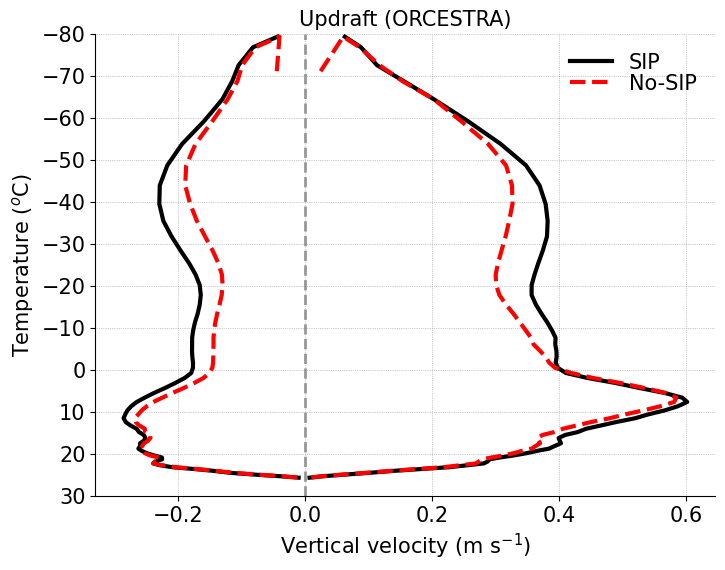

In [73]:
fontsize=15;
lnwdth=3;
alpha=0.6;


plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='--', linewidth=2, alpha=0.8)

plt.plot(avg_wvel_up_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth, label='SIP')
plt.plot(avg_wvel_up_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth, label='No-SIP')
plt.plot(avg_wvel_dn_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth)#, label='SIP')
plt.plot(avg_wvel_dn_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth)#, label='No-SIP')
#plt.xlim(-20, 50)
plt.ylim(30,-80)
#plt.xticks([-20, -10, 0, 10, 20, 30, 40, 50], fontsize=fontsize)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Updraft (ORCESTRA)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))

plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.show()

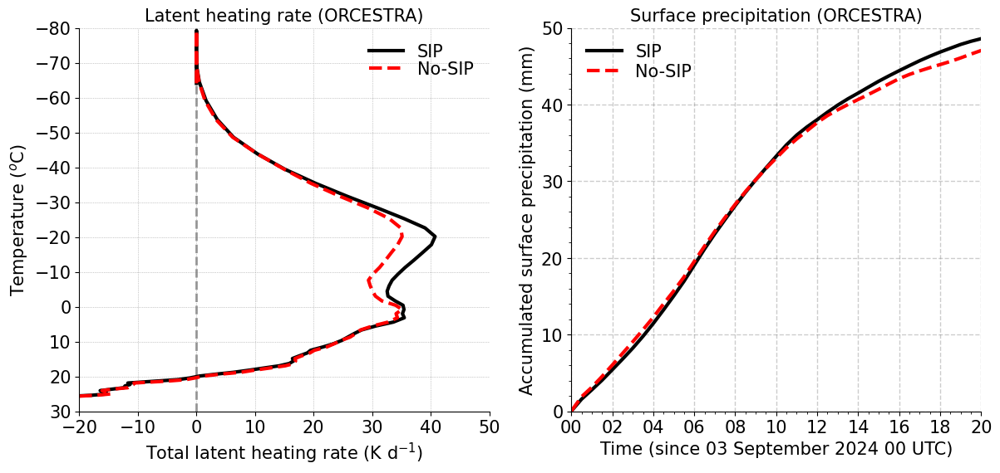

In [60]:

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(14, 6))

plt.subplot(1,2,1)
plt.axvline(x=0, color='grey', linestyle='--', linewidth=2, alpha=0.8)
#plt.text(45., 20, "(a)", fontsize=22, ha='center', color='k')#, fontweight='bold')

plt.plot(mean_lhr_kperday_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth, label='SIP')
plt.plot(mean_lhr_kperday_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth, label='No-SIP')

plt.xlim(-20, 50)
plt.ylim(30,-80)
plt.xticks([-20, -10, 0, 10, 20, 30, 40, 50], fontsize=fontsize)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
#plt.yscale('log')
plt.xlabel('Total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Latent heating rate (ORCESTRA)', fontsize=fontsize)
plt.legend()
# Increase the length of dashes in the legend
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))

plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
#plt.savefig('/work/bb1163/b382718/ICON_ANALYSIS/dcmex/plots/dcmex_inp_teflon.jpg', dpi=600, bbox_inches='tight')

plt.subplot(1,2,2)
#plt.text(1., 1, "(b)", fontsize=22, ha='center', color='k')#, fontweight='bold')

plt.plot(ds_sip_new.time, acc_precip_sip, "k-", label="SIP", linewidth = lnwdth)
plt.plot(ds_nosip_new.time, acc_precip_nosip, "r--", label="No-SIP", linewidth = lnwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=1, alpha=0.4)
plt.minorticks_on()
plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)
start_date = datetime(2024, 9, 3, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2024, 9, 3, 20, 0)
plt.xlim(start_date, end_date)
plt.ylim(0, 50)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation (ORCESTRA)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.show()

In [25]:

#### No SIP (Generalized estimation for effective particle size, not dependent on number conc.)
toa_sw_up_nosip = ds_nosip_effrad_new.swflx_up[:,0,:]
toa_sw_up_clr_nosip = ds_nosip_effrad_new.swflx_up_clr[:,0,:]
toa_lw_up_nosip = ds_nosip_effrad_new.lwflx_up[:,0,:]
toa_lw_up_clr_nosip = ds_nosip_effrad_new.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip = ds_nosip_effrad_new.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip = ds_nosip_effrad_new.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip = ds_nosip_effrad_new.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip = ds_nosip_effrad_new.lwflx_dn_clr[:,0,:]

#### SIP (Generalized estimation for effective particle size, not dependent on number conc.)
toa_sw_up_sip = ds_sip_effrad_new.swflx_up[:,0,:]
toa_sw_up_clr_sip = ds_sip_effrad_new.swflx_up_clr[:,0,:]
toa_lw_up_sip = ds_sip_effrad_new.lwflx_up[:,0,:]
toa_lw_up_clr_sip = ds_sip_effrad_new.lwflx_up_clr[:,0,:]

toa_sw_dn_sip = ds_sip_effrad_new.swflx_dn[:,0,:]
toa_sw_dn_clr_sip = ds_sip_effrad_new.swflx_dn_clr[:,0,:]
toa_lw_dn_sip = ds_sip_effrad_new.lwflx_dn[:,0,:]
toa_lw_dn_clr_sip = ds_sip_effrad_new.lwflx_dn_clr[:,0,:]

#CRE_sw = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)

#toa_cre_sw_1mom = (toa_sw_dn_1mom-toa_sw_up_1mom) - (toa_sw_dn_clr_1mom-toa_sw_up_clr_1mom)
toa_cre_sw_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_cre_sw_sip = (toa_sw_dn_sip-toa_sw_up_sip) - (toa_sw_dn_clr_sip-toa_sw_up_clr_sip)

#toa_cre_lw_1mom = (toa_lw_dn_1mom-toa_lw_up_1mom) - (toa_lw_dn_clr_1mom-toa_lw_up_clr_1mom)
toa_cre_lw_nosip = (toa_sw_dn_nosip-toa_lw_up_nosip) - (toa_sw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_cre_lw_sip = (toa_sw_dn_sip-toa_lw_up_sip) - (toa_sw_dn_clr_sip-toa_lw_up_clr_sip)

#toa_net_cre_1mom = toa_cre_sw_1mom+toa_cre_lw_1mom
toa_net_cre_nosip = toa_cre_sw_nosip+toa_cre_lw_nosip
toa_net_cre_sip = toa_cre_sw_sip+toa_cre_lw_sip

#del_toa_sw_cre_efrad = toa_cre_sw_nosip_efrad-toa_cre_sw_nosip
#del_toa_lw_cre_efrad = toa_cre_lw_nosip_efrad-toa_cre_lw_nosip



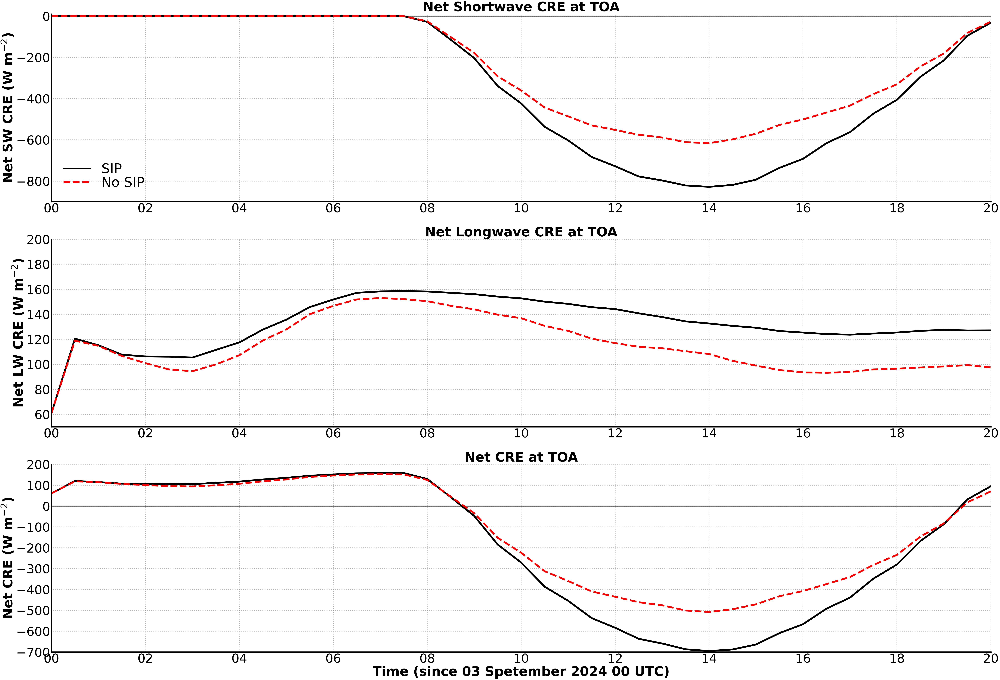

In [45]:

#plt.figure(figsize=(16, 5))
plt.figure(figsize=(95, 65))

lnwdth=10
fontsize=70
plt.subplot(3,1,1)

plt.axhline(y=0, color='k', linestyle='-', linewidth=6, alpha=0.5)

plt.plot(ds_sip_effrad_new.time, toa_cre_sw_sip.mean('ncells'), 'k-', linewidth=lnwdth, label='SIP')
plt.plot(ds_nosip_effrad_new.time, toa_cre_sw_nosip.mean('ncells'), 'r--', linewidth=lnwdth, label='No SIP')
#plt.xlabel('Time (since 03 Spetember 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)   
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-900,10)
plt.yticks(fontsize=fontsize)
plt.ylabel('Net SW CRE (W m$^{-2}$)', fontsize=fontsize+4, fontweight='bold')
plt.title('Net Shortwave CRE at TOA', fontsize=fontsize+4, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize+6, loc='lower left')
plt.grid(True, linestyle=':', linewidth=4, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(7)
plt.gca().spines['bottom'].set_linewidth(7)

plt.subplot(3,1,2)
#plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_sip_effrad_new.time, toa_cre_lw_sip.mean('ncells'), 'k-', linewidth=lnwdth, label='SIP')
plt.plot(ds_nosip_effrad_new.time, toa_cre_lw_nosip.mean('ncells'), 'r--', linewidth=lnwdth, label='No SIP')
#plt.xlabel('Time (since 03 Spetember 2024 00 UTC)', fontsize=fontsize+4)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)   
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(50,200)
plt.yticks(fontsize=fontsize)
plt.ylabel('Net LW CRE (W m$^{-2}$)', fontsize=fontsize+4, fontweight='bold')
plt.title('Net Longwave CRE at TOA', fontsize=fontsize+4, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=4, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(7)
plt.gca().spines['bottom'].set_linewidth(7)

plt.subplot(3,1,3)
plt.axhline(y=0, color='k', linestyle='-', linewidth=6, alpha=0.5)

#plt.plot(ds_1mom.time, toa_net_cre_1mom.mean('ncells'), 'r-', linewidth=linewidth, label='1-moment')
plt.plot(ds_sip_effrad_new.time, toa_net_cre_sip.mean('ncells'), 'k-', linewidth=lnwdth, label='SIP')
plt.plot(ds_nosip_effrad_new.time, toa_net_cre_nosip.mean('ncells'), 'r--', linewidth=lnwdth, label='No SIP')
plt.xlabel('Time (since 03 Spetember 2024 00 UTC)', fontsize=fontsize+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)   
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-700,200)
plt.yticks(fontsize=fontsize)
plt.ylabel('Net CRE (W m$^{-2}$)', fontsize=fontsize+4, fontweight='bold')
plt.title('Net CRE at TOA', fontsize=fontsize+4, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=4, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(7)
plt.gca().spines['bottom'].set_linewidth(7)
#plt.tight_layout()
plt.show()

In [5]:


#### 1-moment
toa_sw_up_1mom = ds_1mom.swflx_up[:,0,:]
toa_sw_up_clr_1mom = ds_1mom.swflx_up_clr[:,0,:]
toa_lw_up_1mom = ds_1mom.lwflx_up[:,0,:]
toa_lw_up_clr_1mom = ds_1mom.lwflx_up_clr[:,0,:]

toa_sw_dn_1mom = ds_1mom.swflx_dn[:,0,:]
toa_sw_dn_clr_1mom = ds_1mom.swflx_dn_clr[:,0,:]
toa_lw_dn_1mom = ds_1mom.lwflx_dn[:,0,:]
toa_lw_dn_clr_1mom = ds_1mom.lwflx_dn_clr[:,0,:]

#### No SIP (Generalized estimation for effective particle size, not dependent on number conc.)
toa_sw_up_nosip = ds_nosip.swflx_up[:,0,:]
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr[:,0,:]
toa_lw_up_nosip = ds_nosip.lwflx_up[:,0,:]
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip = ds_nosip.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip = ds_nosip.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr[:,0,:]

#### No SIP (Effective particle size is being estimated from number conc.)
toa_sw_up_nosip_efrad = ds_nosip_effrad.swflx_up[:,0,:]
toa_sw_up_clr_nosip_efrad = ds_nosip_effrad.swflx_up_clr[:,0,:]
toa_lw_up_nosip_efrad = ds_nosip_effrad.lwflx_up[:,0,:]
toa_lw_up_clr_nosip_efrad = ds_nosip_effrad.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip_efrad = ds_nosip_effrad.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip_efrad = ds_nosip_effrad.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip_efrad = ds_nosip_effrad.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip_efrad = ds_nosip_effrad.lwflx_dn_clr[:,0,:]

#CRE_sw = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)

toa_cre_sw_1mom = (toa_sw_dn_1mom-toa_sw_up_1mom) - (toa_sw_dn_clr_1mom-toa_sw_up_clr_1mom)
toa_cre_sw_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_cre_sw_nosip_efrad = (toa_sw_dn_nosip_efrad-toa_sw_up_nosip_efrad) - (toa_sw_dn_clr_nosip_efrad-toa_sw_up_clr_nosip_efrad)

toa_cre_lw_1mom = (toa_lw_dn_1mom-toa_lw_up_1mom) - (toa_lw_dn_clr_1mom-toa_lw_up_clr_1mom)
toa_cre_lw_nosip = (toa_sw_dn_nosip-toa_lw_up_nosip) - (toa_sw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_cre_lw_nosip_efrad = (toa_lw_dn_nosip_efrad-toa_lw_up_nosip_efrad) - (toa_lw_dn_clr_nosip_efrad-toa_lw_up_clr_nosip_efrad)

toa_net_cre_1mom = toa_cre_sw_1mom+toa_cre_lw_1mom
toa_net_cre_nosip = toa_cre_sw_nosip+toa_cre_lw_nosip
toa_net_cre_nosip_efrad = toa_cre_sw_nosip_efrad+toa_cre_lw_nosip_efrad

del_toa_sw_cre_efrad = toa_cre_sw_nosip_efrad-toa_cre_sw_nosip
del_toa_lw_cre_efrad = toa_cre_lw_nosip_efrad-toa_cre_lw_nosip
del_toa_net_cre_efrad = toa_net_cre_nosip_efrad-toa_net_cre_nosip



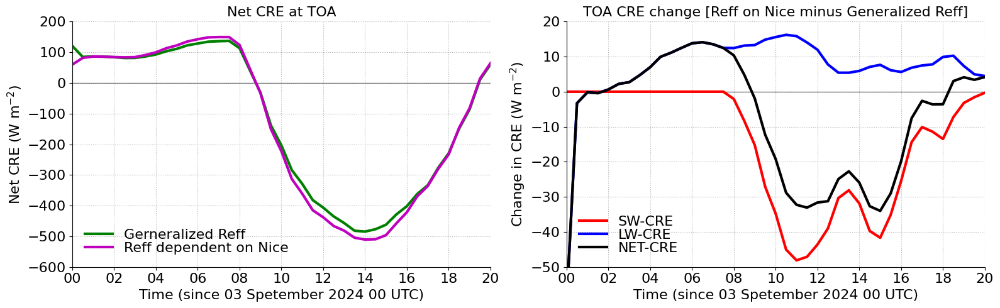

In [6]:

plt.figure(figsize=(16, 5))
linewidth=3
fontsize=16
plt.subplot(1,2,1)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

#plt.plot(ds_1mom.time, toa_net_cre_1mom.mean('ncells'), 'r-', linewidth=linewidth, label='1-moment')
plt.plot(ds_nosip.time, toa_net_cre_nosip.mean('ncells'), 'g-', linewidth=linewidth, label='Gerneralized Reff')
plt.plot(ds_nosip_effrad.time, toa_net_cre_nosip_efrad.mean('ncells'), 'm-', linewidth=linewidth, label='Reff dependent on Nice')
plt.xlabel('Time (since 03 Spetember 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)   
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-600,200)
plt.yticks(fontsize=fontsize)
plt.ylabel('Net CRE (W m$^{-2}$)', fontsize=fontsize)
plt.title('Net CRE at TOA', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.subplot(1,2,2)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip_effrad.time, del_toa_sw_cre_efrad.mean('ncells'), 'r-', linewidth=linewidth, label='SW-CRE')
plt.plot(ds_nosip_effrad.time, del_toa_lw_cre_efrad.mean('ncells'), 'b-', linewidth=linewidth, label='LW-CRE')
plt.plot(ds_nosip_effrad.time, del_toa_net_cre_efrad.mean('ncells'), 'k-', linewidth=linewidth, label='NET-CRE')

plt.xlabel('Time (since 03 Spetember 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)  
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-50,20)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in CRE (W m$^{-2}$)', fontsize=fontsize)
plt.title('TOA CRE change [Reff on Nice minus Generalized Reff]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=1, loc='lower left')
plt.grid(True, linestyle=':', color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.tight_layout()
plt.show()

In [45]:
print(ds_sip.ddt_temp_radsw.min().values)
print(ds_sip.ddt_temp_radsw.max().values)

0.0
0.0012396787


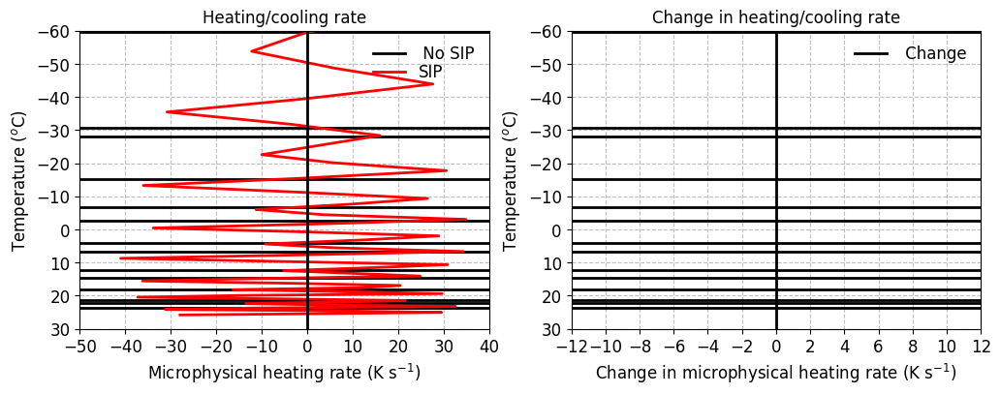

In [6]:


filt_ddt_gscp = xr.where(ds_nosip.tot_qcld > 1.e-5, ds_nosip.d_lhr, np.nan)
mean_microph_ddt_nosip = filt_ddt_gscp.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

filt_ddt_gscp = xr.where(ds_sip.tot_qcld > 1.e-5, ds_sip.ddt_temp_gscp, np.nan)
mean_microph_ddt_sip = filt_ddt_gscp.mean(dim=('time','ncells'))
mean_tempc_sip = ds_sip.tempc.mean(dim=('time','ncells'))

del_microph_ddt = mean_microph_ddt_sip-mean_microph_ddt_nosip

# Plotting
plt.figure(figsize=(12, 4))
deg_faint_errbar = 0.6
lnwdth=2
fontsize=12
plt.subplot(1,2,1)
plt.plot(mean_microph_ddt_nosip,mean_tempc_nosip, 'k-', label=' No SIP', linewidth = lnwdth)
plt.plot(mean_microph_ddt_sip,mean_tempc_sip, 'r-', label='SIP', linewidth = lnwdth)

plt.axvline(x=0, color='k', linestyle='-', linewidth=2)

plt.xlim(-50, 40)
plt.xticks([-50, -40, -30, -20, -10, 0, 10, 20, 30, 40], fontsize=fontsize)
plt.ylim(30, -60)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60], fontsize=fontsize)
plt.xlabel('Microphysical heating rate (K s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Heating/cooling rate', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.grid(True, linestyle='--', alpha=0.5, color='grey')

plt.subplot(1,2,2)

plt.plot(del_microph_ddt,mean_tempc_nosip, 'k-', label=' Change', linewidth = lnwdth)
plt.axvline(x=0, color='k', linestyle='-', linewidth=2)

plt.xlim(-12, 12)
plt.xticks([-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12], fontsize=fontsize)
plt.ylim(30, -60)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60], fontsize=fontsize)
plt.xlabel('Change in microphysical heating rate (K s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Change in heating/cooling rate', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.grid(True, linestyle='--', alpha=0.5, color='grey')

plt.show()


In [48]:
ds_sip

<xarray.Dataset>
Dimensions:         (time: 41, ncells: 73960, vertices: 3, height: 65, bnds: 2,
                     height_2: 66, plev: 1, plev_2: 1, plev_3: 1)
Coordinates:
  * time            (time) datetime64[ns] 2024-09-03 ... 2024-09-03T20:00:00
    clon            (ncells) float64 dask.array<chunksize=(73960,), meta=np.ndarray>
    clat            (ncells) float64 dask.array<chunksize=(73960,), meta=np.ndarray>
  * height          (height) float64 1.0 2.0 3.0 4.0 5.0 ... 62.0 63.0 64.0 65.0
  * height_2        (height_2) float64 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0 66.0
  * plev            (plev) float64 800.0
  * plev_2          (plev_2) float64 400.0
  * plev_3          (plev_3) float64 0.0
Dimensions without coordinates: ncells, vertices, bnds
Data variables: (12/85)
    clon_bnds       (time, ncells, vertices) float64 dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    clat_bnds       (time, ncells, vertices) float64 dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    height_bnds     (time, height, bnds) float64 dask.array<chunksize=(1, 65, 2), meta=np.ndarray>
    plev_bnds       (time, plev, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_2_bnds     (time, plev_2, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_3_bnds     (time, plev_3, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    ...              ...
    tot_qcld        (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    lwc_gperm3      (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    ciwc_gperm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    tiwc_gperm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    cdnc_percm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    inc_perl        (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 2.4.0 (https://mpime...
    Conventions:          CF-1.6
    number_of_grid_used:  99
    uuidOfHGrid:          572c63b4-5951-d138-93bd-61b05c102860
    uuidOfVGrid:          567425a0-32bf-151c-3811-4389b7cd21e0
    institution:          Max Planck Institute for Meteorology/Deutscher Wett...
    title:                ICON simulation
    source:               version: 2024.10; revision: 885c4646a69d44aa9e9fdf4...
    history:              /home/b/b382718/tdf_sip_lfr/icon-oct2024/bin/icon a...
    references:           see MPIM/DWD publications
    comment:              Deepak Waman (b382718) on l40493 (Linux 4.18.0-513....

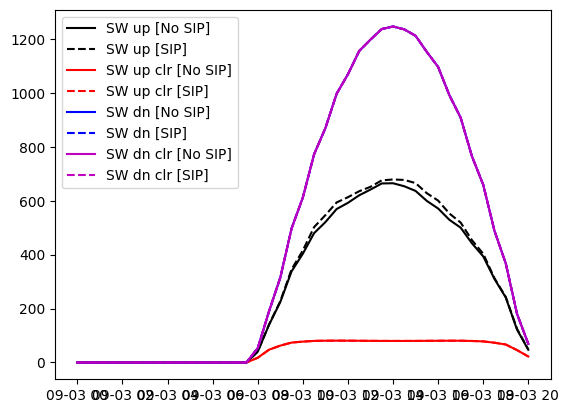

In [7]:

#### 1-moment
toa_sw_up_1mom = ds_1mom.swflx_up[:,0,:]
toa_sw_up_clr_1mom = ds_1mom.swflx_up_clr[:,0,:]
toa_lw_up_1mom = ds_1mom.lwflx_up[:,0,:]
toa_lw_up_clr_1mom = ds_1mom.lwflx_up_clr[:,0,:]

toa_sw_dn_1mom = ds_1mom.swflx_dn[:,0,:]
toa_sw_dn_clr_1mom = ds_1mom.swflx_dn_clr[:,0,:]
toa_lw_dn_1mom = ds_1mom.lwflx_dn[:,0,:]
toa_lw_dn_clr_1mom = ds_1mom.lwflx_dn_clr[:,0,:]

#### SIP
toa_sw_up_sip = ds_sip.swflx_up[:,0,:]
toa_sw_up_clr_sip = ds_sip.swflx_up_clr[:,0,:]
toa_lw_up_sip = ds_sip.lwflx_up[:,0,:]
toa_lw_up_clr_sip = ds_sip.lwflx_up_clr[:,0,:]

toa_sw_dn_sip = ds_sip.swflx_dn[:,0,:]
toa_sw_dn_clr_sip = ds_sip.swflx_dn_clr[:,0,:]
toa_lw_dn_sip = ds_sip.lwflx_dn[:,0,:]
toa_lw_dn_clr_sip = ds_sip.lwflx_dn_clr[:,0,:]

#### No SIP
toa_sw_up_nosip = ds_nosip.swflx_up[:,0,:]
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr[:,0,:]
toa_lw_up_nosip = ds_nosip.lwflx_up[:,0,:]
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip = ds_nosip.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip = ds_nosip.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr[:,0,:]

#CRE_sw = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)

toa_cre_sw_1mom = (toa_sw_dn_1mom-toa_sw_up_1mom) - (toa_sw_dn_clr_1mom-toa_sw_up_clr_1mom)
toa_cre_sw_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_cre_sw_sip = (toa_sw_dn_sip-toa_sw_up_sip) - (toa_sw_dn_clr_sip-toa_sw_up_clr_sip)

toa_cre_lw_1mom = (toa_lw_dn_1mom-toa_lw_up_1mom) - (toa_lw_dn_clr_1mom-toa_lw_up_clr_1mom)
toa_cre_lw_nosip = (toa_sw_dn_nosip-toa_lw_up_nosip) - (toa_sw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_cre_lw_sip = (toa_lw_dn_sip-toa_lw_up_sip) - (toa_lw_dn_clr_sip-toa_lw_up_clr_sip)

toa_net_cre_1mom = toa_cre_sw_1mom+toa_cre_lw_1mom
toa_net_cre_nosip = toa_cre_sw_nosip+toa_cre_lw_nosip
toa_net_cre_sip = toa_cre_sw_sip+toa_cre_lw_sip

del_toa_sw_cre = toa_cre_sw_sip-toa_cre_sw_nosip
del_toa_lw_cre = toa_cre_lw_sip-toa_cre_lw_nosip
del_toa_net_cre = toa_net_cre_sip-toa_net_cre_nosip

plt.plot(ds_nosip.time,toa_sw_up_nosip.mean('ncells'), 'k-', label='SW up [No SIP]')
plt.plot(ds_sip.time,toa_sw_up_sip.mean('ncells'), 'k--', label='SW up [SIP]')
plt.plot(ds_nosip.time,toa_sw_up_clr_nosip.mean('ncells'), 'r-', label='SW up clr [No SIP]')
plt.plot(ds_sip.time,toa_sw_up_clr_sip.mean('ncells'), 'r--', label='SW up clr [SIP]')
plt.plot(ds_nosip.time,toa_sw_dn_nosip.mean('ncells'), 'b-', label='SW dn [No SIP]')
plt.plot(ds_sip.time,toa_sw_dn_sip.mean('ncells'), 'b--', label='SW dn [SIP]')
plt.plot(ds_nosip.time,toa_sw_dn_clr_nosip.mean('ncells'), 'm-', label='SW dn clr [No SIP]')
plt.plot(ds_sip.time,toa_sw_dn_clr_sip.mean('ncells'), 'm--', label='SW dn clr [SIP]')
plt.legend()
#plt.plot(ds_sip.time,toa_cre_sw_sip.mean('ncells')-toa_cre_sw_nosip.mean('ncells'), 'k-', label='SW-CRE @ TOA')
#plt.plot(ds_sip.time,toa_cre_lw_sip.mean('ncells')-toa_cre_lw_nosip.mean('ncells'), 'r-', label='LW-CRE @ TOA')

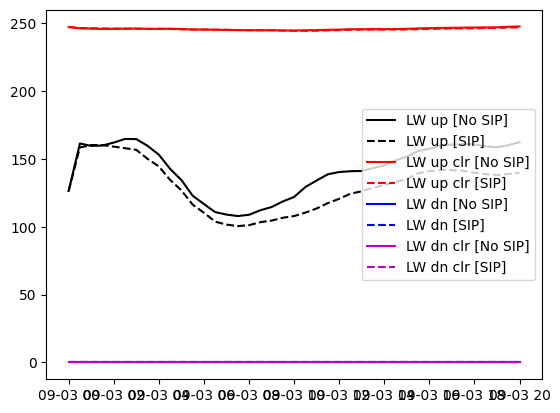

In [69]:
plt.plot(ds_nosip.time,toa_lw_up_nosip.mean('ncells'), 'k-', label='LW up [No SIP]')
plt.plot(ds_sip.time,toa_lw_up_sip.mean('ncells'), 'k--', label='LW up [SIP]')
plt.plot(ds_nosip.time,toa_lw_up_clr_nosip.mean('ncells'), 'r-', label='LW up clr [No SIP]')
plt.plot(ds_sip.time,toa_lw_up_clr_sip.mean('ncells'), 'r--', label='LW up clr [SIP]')
plt.plot(ds_nosip.time,toa_lw_dn_nosip.mean('ncells'), 'b-', label='LW dn [No SIP]')
plt.plot(ds_sip.time,toa_lw_dn_sip.mean('ncells'), 'b--', label='LW dn [SIP]')
plt.plot(ds_nosip.time,toa_lw_dn_clr_nosip.mean('ncells'), 'm-', label='LW dn clr [No SIP]')
plt.plot(ds_sip.time,toa_lw_dn_clr_sip.mean('ncells'), 'm--', label='LW dn clr [SIP]')
plt.legend()

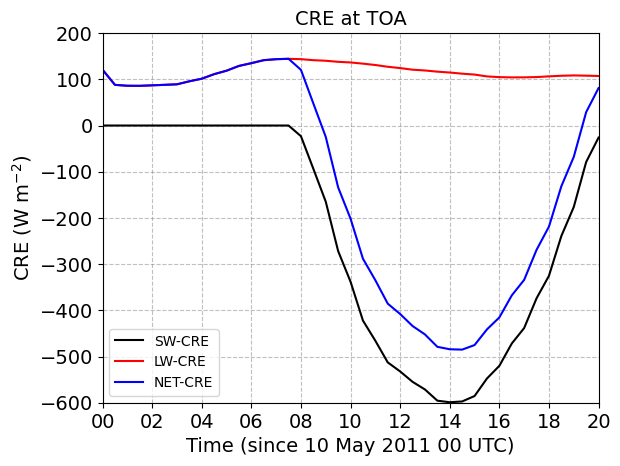

In [82]:
plt.plot(ds_sip.time, toa_cre_sw_sip.mean('ncells'), 'k-', label='SW-CRE')
plt.plot(ds_sip.time, toa_cre_lw_sip.mean('ncells'), 'r-', label='LW-CRE')
plt.plot(ds_sip.time, toa_net_cre_sip.mean('ncells'), 'b-', label='NET-CRE')
plt.xlabel('Time (since 10 May 2011 00 UTC)', fontsize=14)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2024, 9, 3, 20, 0)   # End at 12 UTC on 12 May 2011
plt.xlim(start_date, end_date)
plt.xticks(fontsize=14)
plt.ylim(-600,200)
plt.yticks(fontsize=14)
plt.ylabel('CRE (W m$^{-2}$)', fontsize=14)
plt.title('CRE at TOA', fontsize=14)
plt.legend()
plt.grid(True, linestyle='--', color='grey',alpha=0.5)

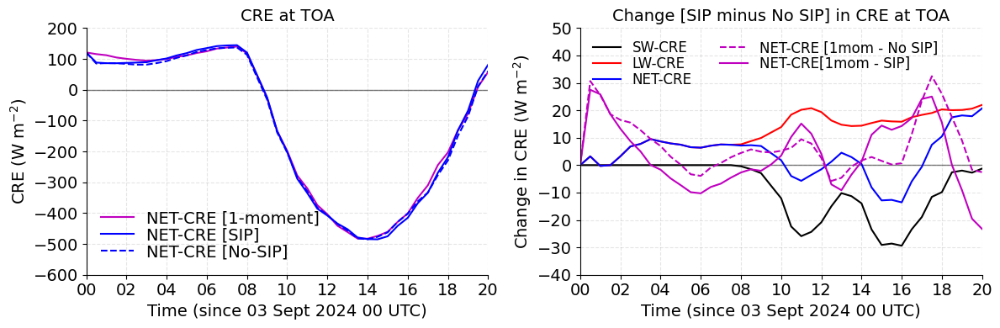

In [9]:

plt.figure(figsize=(12, 4))
linewidth=2
fontsize=14
plt.subplot(1,2,1)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_1mom.time, toa_net_cre_1mom.mean('ncells'), 'm-', label='NET-CRE [1-moment]')
#plt.plot(ds_sip.time, toa_cre_sw_sip.mean('ncells'), 'k-', label='SW-CRE [SIP]')
#plt.plot(ds_sip.time, toa_cre_lw_sip.mean('ncells'), 'r-', label='LW-CRE [SIP]')
plt.plot(ds_sip.time, toa_net_cre_sip.mean('ncells'), 'b-', label='NET-CRE [SIP]')
#plt.plot(ds_sip.time, toa_cre_sw_nosip.mean('ncells'), 'k--', label='SW-CRE [No-SIP]')
#plt.plot(ds_sip.time, toa_cre_lw_nosip.mean('ncells'), 'r--', label='LW-CRE [No-SIP]')
plt.plot(ds_sip.time, toa_net_cre_nosip.mean('ncells'), 'b--', label='NET-CRE [No-SIP]')
plt.xlabel('Time (since 03 Sept 2024 00 UTC)', fontsize=14)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)   
plt.xlim(start_date, end_date)
plt.xticks(fontsize=14)
plt.ylim(-600,200)
plt.yticks(fontsize=14)
plt.ylabel('CRE (W m$^{-2}$)', fontsize=14)
plt.title('CRE at TOA', fontsize=14)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle='--', color='grey',alpha=0.2)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.subplot(1,2,2)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_sip.time, del_toa_sw_cre.mean('ncells'), 'k-', label='SW-CRE')
plt.plot(ds_sip.time, del_toa_lw_cre.mean('ncells'), 'r-', label='LW-CRE')
plt.plot(ds_sip.time, del_toa_net_cre.mean('ncells'), 'b-', label='NET-CRE')
plt.plot(ds_sip.time, toa_net_cre_1mom.mean('ncells')-toa_net_cre_nosip.mean('ncells'), 'm--', label='NET-CRE [1mom - No SIP]')
plt.plot(ds_sip.time, toa_net_cre_1mom.mean('ncells')-toa_net_cre_sip.mean('ncells'), 'm-', label='NET-CRE[1mom - SIP]')



plt.xlabel('Time (since 03 Sept 2024 00 UTC)', fontsize=14)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)  
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-40,50)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in CRE (W m$^{-2}$)', fontsize=fontsize)
plt.title('Change [SIP minus No SIP] in CRE at TOA', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, ncols=2, loc='upper left')
plt.grid(True, linestyle='--', color='grey',alpha=0.2)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.tight_layout()
plt.show()

In [88]:

sw_up_sip = ds_sip.swflx_up
sw_up_clr_sip = ds_sip.swflx_up_clr
lw_up_sip = ds_sip.lwflx_up
lw_up_clr_sip = ds_sip.lwflx_up_clr

sw_dn_sip = ds_sip.swflx_dn
sw_dn_clr_sip = ds_sip.swflx_dn_clr
lw_dn_sip = ds_sip.lwflx_dn
lw_dn_clr_sip = ds_sip.lwflx_dn_clr

sw_up_nosip = ds_nosip.swflx_up
sw_up_clr_nosip = ds_nosip.swflx_up_clr
lw_up_nosip = ds_nosip.lwflx_up
lw_up_clr_nosip = ds_nosip.lwflx_up_clr

sw_dn_nosip = ds_nosip.swflx_dn
sw_dn_clr_nosip = ds_nosip.swflx_dn_clr
lw_dn_nosip = ds_nosip.lwflx_dn
lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr

#CRE_sw = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)

cre_sw_nosip = (sw_dn_nosip-sw_up_nosip) - (sw_dn_clr_nosip-sw_up_clr_nosip)
cre_sw_sip = (sw_dn_sip-sw_up_sip) - (sw_dn_clr_sip-sw_up_clr_sip)

cre_lw_nosip = (sw_dn_nosip-lw_up_nosip) - (sw_dn_clr_nosip-lw_up_clr_nosip)
cre_lw_sip = (lw_dn_sip-lw_up_sip) - (lw_dn_clr_sip-lw_up_clr_sip)

net_cre_nosip = cre_sw_nosip+cre_lw_nosip
net_cre_sip = cre_sw_sip+cre_lw_sip

del_sw_cre = cre_sw_sip-cre_sw_nosip
del_lw_cre = cre_lw_sip-cre_lw_nosip
del_net_cre = net_cre_sip-net_cre_nosip


In [ ]:

mean_cre_sw_sip = cre_sw_sip.mean(dim=('time','ncells'))
mean_cre_lw_sip = cre_lw_sip.mean(dim=('time','ncells'))
mean_cre_net_sip = net_cre_sip.mean(dim=('time','ncells'))

mean_cre_sw_nosip = cre_sw_nosip.mean(dim=('time','ncells'))
mean_cre_lw_nosip = cre_lw_nosip.mean(dim=('time','ncells'))
mean_cre_net_nosip = net_cre_nosip.mean(dim=('time','ncells'))

mean_tempc_sip = ds_sip.tempc.mean(dim=('time','ncells'))


mean_del_sw_cre = mean_cre_sw_sip-mean_cre_sw_nosip
mean_del_lw_cre = mean_cre_lw_sip-mean_cre_lw_nosip
mean_del_net_cre = mean_cre_net_sip-mean_cre_net_nosip

plt.figure(figsize=(12, 4))
linewidth=2
fontsize=14
plt.subplot(1,2,1)
plt.plot(mean_cre_sw_sip[:-1], mean_tempc_sip, 'k-', label='SW-CRE  [SIP]')
plt.plot(mean_cre_lw_sip[:-1], mean_tempc_sip, 'r-', label='LW-CRE [SIP]')
plt.plot(mean_cre_net_sip[:-1], mean_tempc_sip, 'b-', label='NET-CRE [SIP]')
plt.plot(mean_cre_sw_nosip[:-1], mean_tempc_sip, 'k--', label='SW-CRE  [No-SIP]')
plt.plot(mean_cre_lw_nosip[:-1], mean_tempc_sip, 'r--', label='LW-CRE [No-SIP]')
plt.plot(mean_cre_net_nosip[:-1],mean_tempc_sip, 'b--', label='NET-CRE [No-SIP]')

plt.xticks(fontsize=fontsize)
plt.xlim(-500,200)
plt.ylim(30,-60)
plt.yticks(fontsize=14)
plt.xlabel('CRE (W m$^{-2}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle='--', color='grey',alpha=0.5)

plt.subplot(1,2,2)
plt.plot(mean_del_sw_cre[:-1], mean_tempc_sip, 'k-', label='SW-CRE')
plt.plot(mean_del_lw_cre[:-1], mean_tempc_sip, 'r-', label='LW-CRE')
plt.plot(mean_del_net_cre[:-1], mean_tempc_sip, 'b-', label='NET-CRE')

#plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.xlim(-50,300)
plt.ylim(30,-60)
plt.yticks(fontsize=fontsize)
plt.xlabel('Change in CRE (W m$^{-2}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Change [SIP minus No SIP] in CRE', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle='--', color='grey',alpha=0.5)
plt.tight_layout()
plt.show()

/tmp/ipykernel_3863367/1962754006.py:46: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[0].legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')


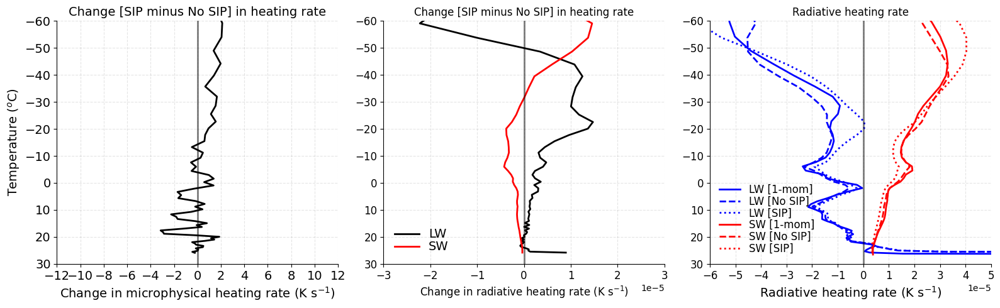

In [143]:
### Microphysical temperature tendency
mean_microph_ddt_1mom = ds_1mom.ddt_temp_gscp.mean(dim=('time','ncells'))
mean_microph_ddt_nosip = ds_nosip.ddt_temp_gscp.mean(dim=('time','ncells'))
mean_microph_ddt_sip = ds_sip.ddt_temp_gscp.mean(dim=('time','ncells'))

del_microph_ddt = mean_microph_ddt_sip-mean_microph_ddt_nosip

mean_tempc_1mom = ds_1mom.tempc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))
mean_tempc_sip = ds_sip.tempc.mean(dim=('time','ncells'))

### LW temperature tendency
mean_lw_ddt_1mom = ds_1mom.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_lw_ddt_nosip = ds_nosip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_lw_ddt_sip = ds_sip.ddt_temp_radlw.mean(dim=('time','ncells'))

del_lw_ddt = mean_lw_ddt_sip-mean_lw_ddt_nosip

### SW temperature tendency
mean_sw_ddt_1mom = ds_1mom.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_sw_ddt_nosip = ds_nosip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_sw_ddt_sip = ds_sip.ddt_temp_radsw.mean(dim=('time','ncells'))

del_sw_ddt = mean_sw_ddt_sip-mean_sw_ddt_nosip


fig, axes = plt.subplots(1, 3, figsize=(16, 5))

deg_faint_errbar = 0.6
lnwdth = 2
fontsize = 14

# Subplot 1: Change in microphysical heating/cooling rate
axes[0].plot(del_microph_ddt, mean_tempc_nosip, 'k-', label='', linewidth=lnwdth)

axes[0].axvline(x=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

axes[0].set_xlim(-12, 12)
axes[0].set_xticks([-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12])
axes[0].tick_params(axis='both', labelsize=fontsize)
axes[0].set_ylim(30, -60)
axes[0].set_yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60])
axes[0].set_xlabel('Change in microphysical heating rate (K s$^{-1}$)', fontsize=fontsize)
axes[0].set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
axes[0].set_title('Change [SIP minus No SIP] in heating rate', fontsize=fontsize)
axes[0].legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
axes[0].grid(True, linestyle='--', alpha=0.2, color='grey')

axes[0].spines['top'].set_visible(False)
axes[0].spines['right'].set_visible(False)

# Subplot 2: Change in radiative heating/cooling rate
axes[1].plot(del_lw_ddt, mean_tempc_sip, 'k-', label='LW', linewidth=lnwdth)
axes[1].plot(del_sw_ddt, mean_tempc_sip, 'r-', label='SW', linewidth=lnwdth)
axes[1].axvline(x=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

axes[1].set_xlim(-3.e-5, 3.e-5)
axes[1].set_xticks([-3.e-5, -2.e-5, -1.e-5, 0, 1.e-5, 2.e-5, 3.e-5])
axes[1].set_ylim(30, -60)
#axes[1].set_yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60])
axes[1].tick_params(axis='both', labelsize=fontsize-2)
axes[1].set_xlabel('Change in radiative heating rate (K s$^{-1}$)', fontsize=fontsize-2)
#axes[1].set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
axes[1].set_title('Change [SIP minus No SIP] in heating rate', fontsize=fontsize-2)
axes[1].legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
axes[1].grid(True, linestyle='--', alpha=0.2, color='grey')

axes[1].spines['top'].set_visible(False)
axes[1].spines['right'].set_visible(False)

# Subplot 3: Change in radiative heating/cooling rate
axes[2].plot(mean_lw_ddt_1mom, mean_tempc_1mom, 'b-', label='LW [1-mom]', linewidth=lnwdth)
axes[2].plot(mean_lw_ddt_nosip, mean_tempc_sip, 'b--', label='LW [No SIP]', linewidth=lnwdth)
axes[2].plot(mean_lw_ddt_sip, mean_tempc_sip, 'b:', label='LW [SIP]', linewidth=lnwdth)
axes[2].plot(mean_sw_ddt_1mom, mean_tempc_1mom, 'r-', label='SW [1-mom]', linewidth=lnwdth)
axes[2].plot(mean_sw_ddt_nosip, mean_tempc_sip, 'r--', label='SW [No SIP]', linewidth=lnwdth)
axes[2].plot(mean_sw_ddt_sip, mean_tempc_sip, 'r:', label='SW [SIP]', linewidth=lnwdth)
axes[2].axvline(x=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

axes[2].set_xlim(-6.e-5, 5.e-5)
axes[2].set_xticks([-6.e-5, -5.e-5, -4.e-5, -3.e-5, -2.e-5, -1.e-5, 0, 1.e-5, 2.e-5, 3.e-5, 4.e-5, 5.e-5])
axes[2].set_ylim(30, -60)
#axes[2].set_yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60])
axes[2].tick_params(axis='both', labelsize=fontsize-2)
axes[2].set_xlabel('Radiative heating rate (K s$^{-1}$)', fontsize=fontsize)
#axes[2].set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
axes[2].set_title('Radiative heating rate', fontsize=fontsize-2)
axes[2].legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, loc='lower left')
axes[2].grid(True, linestyle='--', alpha=0.2, color='grey')

axes[2].spines['top'].set_visible(False)
axes[2].spines['right'].set_visible(False)

plt.tight_layout()

plt.show()


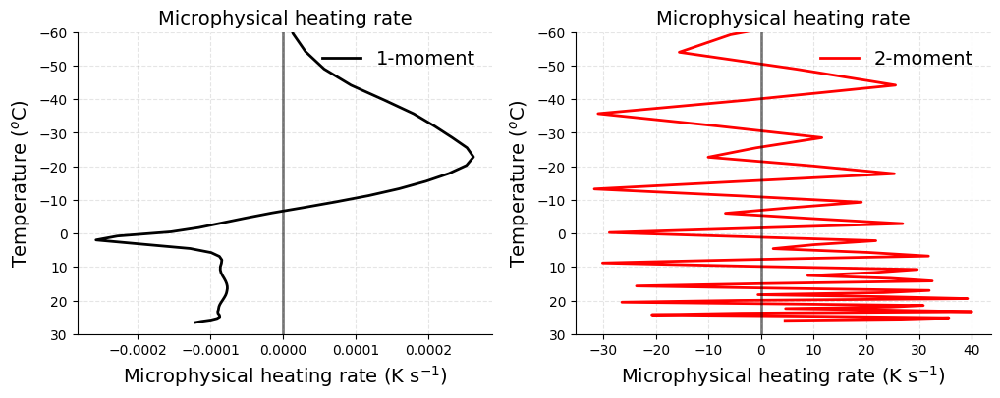

In [149]:

deg_faint_errbar = 0.6
lnwdth = 2
fontsize = 14


plt.figure(figsize=(12, 4))

plt.subplot(1,2,1)
plt.plot(ds_1mom.ddt_temp_gscp.mean(dim=('time','ncells')), ds_1mom.tempc.mean(dim=('time','ncells')), 'k-', label='1-moment', linewidth=lnwdth)

plt.axvline(x=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

#plt.xlim(-12, 12)
#plt.xticks([-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12])
plt.ylim(30, -60)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60])
plt.xlabel('Microphysical heating rate (K s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Microphysical heating rate', fontsize=fontsize)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle='--', alpha=0.2, color='grey')

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.subplot(1,2,2)
plt.plot(ds_nosip.ddt_temp_gscp.mean(dim=('time','ncells')), ds_nosip.tempc.mean(dim=('time','ncells')), 'r-', label='2-moment', linewidth=lnwdth)

plt.axvline(x=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

#plt.xlim(-12, 12)
#plt.xticks([-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12])
plt.ylim(30, -60)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60])
plt.xlabel('Microphysical heating rate (K s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Microphysical heating rate', fontsize=fontsize)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle='--', alpha=0.2, color='grey')

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)


In [14]:

#######
min_tempc_sip = ds_sip.tempc.min().values
max_tempc_sip = ds_sip.tempc.max().values

min_wvel_sip = ds_sip.w_vel.min().values
max_wvel_sip = ds_sip.w_vel.max().values

num_temp_bin = 20; num_w_bin = 20;

temp_bin = np.linspace(min_tempc_sip, max_tempc_sip, num_temp_bin+1)
wvel_bin = np.linspace(min_wvel_sip, max_wvel_sip, num_w_bin+1)
#######

#######
tempc_sip_flat = ds_sip.tempc.values.flatten()
wvel_sip_flat = ds_sip.w_vel.values.flatten()

qc_sip_flat = ds_sip.qc.values.flatten()
qi_sip_flat = ds_sip.qi.values.flatten()
qs_sip_flat = ds_sip.qs.values.flatten()
qg_sip_flat = ds_sip.qg.values.flatten()
qh_sip_flat = ds_sip.qh.values.flatten()
qr_sip_flat = ds_sip.qr.values.flatten()
tqi_sip_flat = ds_sip.tqi.values.flatten()
#######

hist_sip, temp_edges_sip, wvel_edges_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin))

#######
qc_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qc_sip_flat)[0]
qi_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qi_sip_flat)[0]
qs_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qs_sip_flat)[0]
qg_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qg_sip_flat)[0]
qh_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qh_sip_flat)[0]
qr_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qr_sip_flat)[0]
tqi_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = tqi_sip_flat)[0]
#######

#######
avg_qc_temp_w_sip = qc_sum_sip/hist_sip
avg_qc_temp_w_sip[avg_qc_temp_w_sip < 1.e-9] = np.nan

avg_qi_temp_w_sip = qi_sum_sip/hist_sip
avg_qi_temp_w_sip[avg_qi_temp_w_sip < 1.e-9] = np.nan

avg_qs_temp_w_sip = qs_sum_sip/hist_sip
avg_qs_temp_w_sip[avg_qs_temp_w_sip < 1.e-9] = np.nan

avg_qg_temp_w_sip = qg_sum_sip/hist_sip
avg_qg_temp_w_sip[avg_qg_temp_w_sip < 1.e-9] = np.nan

avg_qh_temp_w_sip = qh_sum_sip/hist_sip
avg_qh_temp_w_sip[avg_qh_temp_w_sip < 1.e-9] = np.nan

avg_qr_temp_w_sip = qr_sum_sip/hist_sip
avg_qr_temp_w_sip[avg_qr_temp_w_sip < 1.e-9] = np.nan

avg_tqi_temp_w_sip = tqi_sum_sip/hist_sip
avg_tqi_temp_w_sip[avg_tqi_temp_w_sip < 1.e-9] = np.nan
#######


/tmp/ipykernel_758819/3716124162.py:40: RuntimeWarning: invalid value encountered in divide
  avg_qc_temp_w_sip = qc_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:43: RuntimeWarning: invalid value encountered in divide
  avg_qi_temp_w_sip = qi_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:46: RuntimeWarning: invalid value encountered in divide
  avg_qs_temp_w_sip = qs_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:49: RuntimeWarning: invalid value encountered in divide
  avg_qg_temp_w_sip = qg_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:52: RuntimeWarning: invalid value encountered in divide
  avg_qh_temp_w_sip = qh_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:55: RuntimeWarning: invalid value encountered in divide
  avg_qr_temp_w_sip = qr_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:58: RuntimeWarning: invalid value encountered in divide
  avg_tqi_temp_w_sip = tqi_sum_sip/hist_sip


In [13]:

#######
min_tempc_nosip = ds_nosip.tempc.min().values
max_tempc_nosip = ds_nosip.tempc.max().values

min_wvel_nosip = ds_nosip.w_vel.min().values
max_wvel_nosip = ds_nosip.w_vel.max().values

num_temp_bin = 20; num_w_bin = 20;

temp_nosip_bin = np.linspace(min_tempc_nosip, max_tempc_nosip, num_temp_bin+1)
wvel_nosip_bin = np.linspace(min_wvel_nosip, max_wvel_nosip, num_w_bin+1)
#######

#######
tempc_nosip_flat = ds_nosip.tempc.values.flatten()
wvel_nosip_flat = ds_nosip.w_vel.values.flatten()

qc_nosip_flat = ds_nosip.qc.values.flatten()
qi_nosip_flat = ds_nosip.qi.values.flatten()
qs_nosip_flat = ds_nosip.qs.values.flatten()
qg_nosip_flat = ds_nosip.qg.values.flatten()
qh_nosip_flat = ds_nosip.qh.values.flatten()
qr_nosip_flat = ds_nosip.qr.values.flatten()
tqi_nosip_flat = ds_nosip.tqi.values.flatten()
#######

hist_nosip, temp_edges_nosip, wvel_edges_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin))

#######
qc_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qc_nosip_flat)[0]
qi_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qi_nosip_flat)[0]
qs_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qs_nosip_flat)[0]
qg_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qg_nosip_flat)[0]
qh_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qh_nosip_flat)[0]
qr_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qr_nosip_flat)[0]
tqi_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = tqi_nosip_flat)[0]
#######

#######
avg_qc_temp_w_nosip = qc_sum_nosip/hist_nosip
avg_qc_temp_w_nosip[avg_qc_temp_w_nosip < 1.e-9] = np.nan

avg_qi_temp_w_nosip = qi_sum_nosip/hist_nosip
avg_qi_temp_w_nosip[avg_qi_temp_w_nosip < 1.e-9] = np.nan

avg_qs_temp_w_nosip = qs_sum_nosip/hist_nosip
avg_qs_temp_w_nosip[avg_qs_temp_w_nosip < 1.e-9] = np.nan

avg_qg_temp_w_nosip = qg_sum_nosip/hist_nosip
avg_qg_temp_w_nosip[avg_qg_temp_w_nosip < 1.e-9] = np.nan

avg_qh_temp_w_nosip = qh_sum_nosip/hist_nosip
avg_qh_temp_w_nosip[avg_qh_temp_w_nosip < 1.e-9] = np.nan

avg_qr_temp_w_nosip = qr_sum_nosip/hist_nosip
avg_qr_temp_w_nosip[avg_qr_temp_w_nosip < 1.e-9] = np.nan

avg_tqi_temp_w_nosip = tqi_sum_nosip/hist_nosip
avg_tqi_temp_w_nosip[avg_tqi_temp_w_nosip < 1.e-9] = np.nan
#######


/tmp/ipykernel_758819/67448993.py:40: RuntimeWarning: invalid value encountered in divide
  avg_qc_temp_w_nosip = qc_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:43: RuntimeWarning: invalid value encountered in divide
  avg_qi_temp_w_nosip = qi_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:46: RuntimeWarning: invalid value encountered in divide
  avg_qs_temp_w_nosip = qs_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:49: RuntimeWarning: invalid value encountered in divide
  avg_qg_temp_w_nosip = qg_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:52: RuntimeWarning: invalid value encountered in divide
  avg_qh_temp_w_nosip = qh_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:55: RuntimeWarning: invalid value encountered in divide
  avg_qr_temp_w_nosip = qr_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:58: RuntimeWarning: invalid value encountered in divide
  avg_tqi_temp_w_nosip = tqi_sum_nosip/hist_nosip


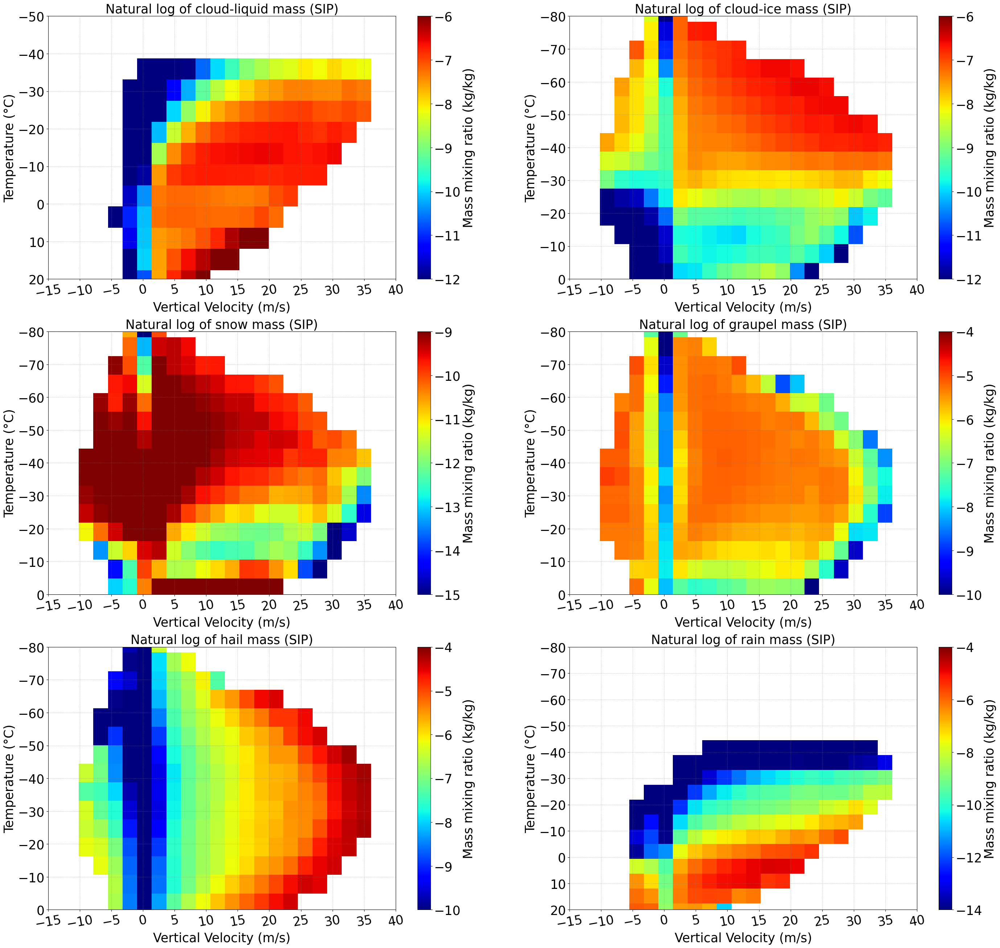

In [20]:


fontsize = 25;
rotation=10

plt.figure(figsize=(34, 32))
plt.subplot(3,2,1)
contour=plt.imshow(np.log(avg_qc_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-12, vmax=-6, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(20, -50)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of cloud-liquid mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,2)
contour=plt.imshow(np.log(avg_qi_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-12, vmax=-6, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of cloud-ice mass (SIP)', fontsize=fontsize)
#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,3)
contour=plt.imshow(np.log(avg_qs_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-15, vmax=-9, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of snow mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,4)
contour=plt.imshow(np.log(avg_qg_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-10, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of graupel mass (SIP)', fontsize=fontsize)

#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,5)
contour=plt.imshow(np.log(avg_qh_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-10, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of hail mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,6)
contour=plt.imshow(np.log(avg_qr_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-14, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(20, -80)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of rain mass (SIP)', fontsize=fontsize)

plt.show()


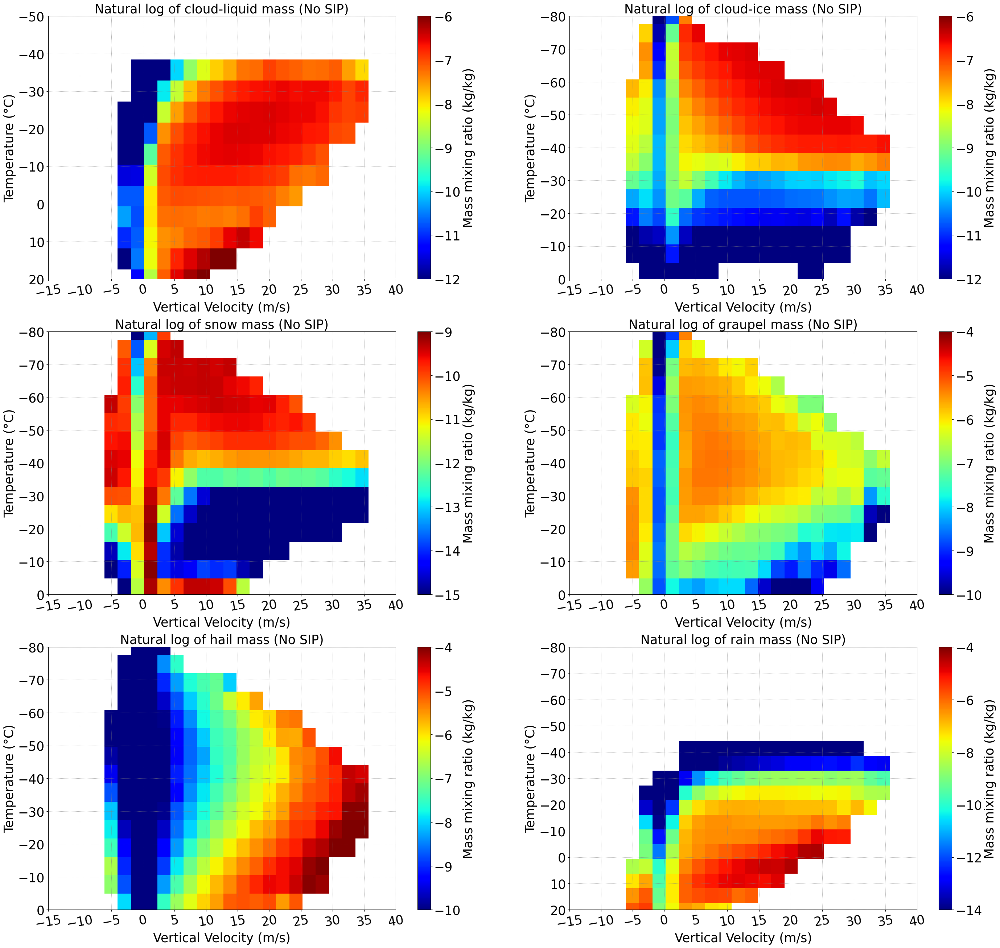

In [22]:


fontsize = 25;
rotation=10

plt.figure(figsize=(34, 32))
plt.subplot(3,2,1)
contour=plt.imshow(np.log(avg_qc_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-12, vmax=-6, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(20, -50)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of cloud-liquid mass (No SIP)', fontsize=fontsize)

plt.subplot(3,2,2)
contour=plt.imshow(np.log(avg_qi_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-12, vmax=-6, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of cloud-ice mass (No SIP)', fontsize=fontsize)
#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,3)
contour=plt.imshow(np.log(avg_qs_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-15, vmax=-9, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of snow mass (No SIP)', fontsize=fontsize)

plt.subplot(3,2,4)
contour=plt.imshow(np.log(avg_qg_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-10, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of graupel mass (No SIP)', fontsize=fontsize)

#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,5)
contour=plt.imshow(np.log(avg_qh_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-10, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of hail mass (No SIP)', fontsize=fontsize)

plt.subplot(3,2,6)
contour=plt.imshow(np.log(avg_qr_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-14, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(20, -80)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of rain mass (No SIP)', fontsize=fontsize)

plt.show()


In [315]:
#### CFAD plots


tempc = ds_sip['tempc'];
ht_km = 1.e-3 * ds_sip['z_mc'];
tempc_avg = tempc.mean(dim=('time', 'ncells'));
ht_avg = ht_km.mean(dim=('time','ncells'));

lwc_sip = ds_sip['lwc_gperm3'];
lwc_sip_filt = xr.where(ds_sip.lwc_gperm3 > 0., ds_sip.lwc_gperm3, np.nan);

lwc_sip_bins = np.linspace(lwc_sip_filt.min().values, lwc_sip_filt.max().values, 20);
cfad_lwc_sip = np.zeros((len(lwc_sip_bins) - 1, len(ht_avg)));
lwc_sip_values = lwc_sip_filt.values;

for i in range(len(lwc_sip_bins) - 1):
    mask = (lwc_sip_values >= lwc_sip_bins[i]) & (lwc_sip_values < lwc_sip_bins[i + 1])    
    cfad_lwc_sip[i, :] = np.sum(mask, axis=(0,2)) / len(ds_sip.time)


In [316]:

tiwc_sip = ds_sip['tiwc_gperm3'];
tiwc_sip_filt = xr.where(ds_sip.tiwc_gperm3 > 0., ds_sip.tiwc_gperm3, np.nan);

tiwc_sip_bins = np.linspace(tiwc_sip_filt.min().values, tiwc_sip_filt.max().values, 20);
cfad_tiwc_sip = np.zeros((len(tiwc_sip_bins) - 1, len(ht_avg)));
tiwc_sip_values = tiwc_sip_filt.values;

for i in range(len(tiwc_sip_bins) - 1):
    mask = (tiwc_sip_values >= tiwc_sip_bins[i]) & (tiwc_sip_values < tiwc_sip_bins[i + 1])    
    cfad_tiwc_sip[i, :] = np.sum(mask, axis=(0,2)) / len(ds_sip.time)



In [331]:
print(ds_sip.cdnc_percm3.min().values)
print(ds_sip.cdnc_percm3.max().values)

0.0
269.1216


In [336]:
print(cdnc_sip_bins)

[  0.          14.1642954   28.32859079  42.49288619  56.65718159
  70.82147699  84.98577238  99.15006778 113.31436318 127.47865858
 141.64295397 155.80724937 169.97154477 184.13584016 198.30013556
 212.46443096 226.62872636 240.79302175 254.95731715 269.12161255]


In [350]:

tempc = ds_sip['tempc'];
ht_km = 1.e-3 * ds_sip['z_mc'];
tempc_avg = tempc.mean(dim=('time', 'ncells'));
ht_avg = ht_km.mean(dim=('time','ncells'));

cdnc_sip = ds_sip['cdnc_percm3'];
cdnc_sip_filt = xr.where(ds_sip.cdnc_percm3 > 0., ds_sip.cdnc_percm3, np.nan);

cdnc_sip_bins = np.linspace(cdnc_sip_filt.min().values, cdnc_sip_filt.max().values, 20);
cfad_cdnc_sip = np.zeros((len(cdnc_sip_bins) - 1, len(ht_avg)));
cdnc_sip_values = cdnc_sip_filt.values;

for i in range(len(cdnc_sip_bins) - 1):
    mask = (cdnc_sip_values >= cdnc_sip_bins[i]) & (cdnc_sip_values < cdnc_sip_bins[i + 1])    
    cfad_cdnc_sip[i, :] = np.sum(mask, axis=(0,2)) / len(ds_sip.time)

(30.0, -60.0)

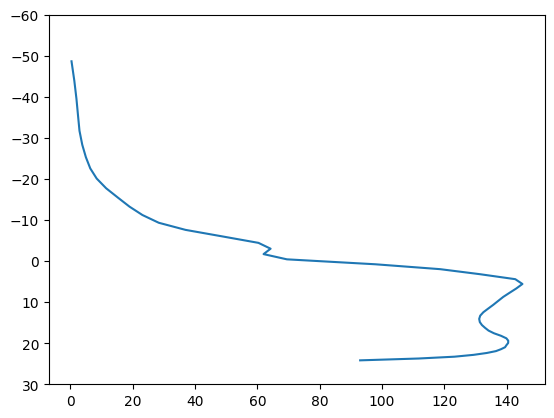

In [374]:

filt_qnc = xr.where((ds_sip.cdnc_percm3 > 0.) & (ds_sip.w_vel > 1.), ds_sip.cdnc_percm3, np.nan)

plt.plot(filt_qnc.mean(dim=('time','ncells')), ds_sip.tempc.mean(dim=('time','ncells')))
plt.ylim(30,-60)

In [352]:

cdnc_sip = ds_sip['cdnc_percm3'];
cdnc_sip_filt = xr.where(ds_sip.cdnc_percm3 > 0., ds_sip.cdnc_percm3, np.nan);

cdnc_sip_bins = np.linspace(ds_sip.cdnc_percm3.min().values, ds_sip.cdnc_percm3.max().values, 50);
cfad_cdnc_sip = np.zeros((len(cdnc_sip_bins) - 1, len(ht_avg)));
cdnc_sip_values = ds_sip.cdnc_percm3.values;

for i in range(len(cdnc_sip_bins) - 1):
    mask = (cdnc_sip_values >= cdnc_sip_bins[i]) & (cdnc_sip_values < cdnc_sip_bins[i + 1])    
    cfad_cdnc_sip[i, :] = np.sum(mask, axis=(0,2)) / len(ds_sip.time)
    

In [361]:

tinc_sip = ds_sip.inc_perl;
tinc_sip_filt = xr.where(ds_sip.inc_perl > 0., ds_sip.inc_perl, np.nan);
tinc_sip_bins = np.linspace(tinc_sip_filt.min().values, tinc_sip_filt.max().values, 40)

cfad_tinc_sip = np.zeros((len(tinc_sip_bins) - 1, len(ht_avg)))

tinc_sip_values = tinc_sip_filt.values  # shape (time, height, ncells)

# Loop through the tinc bins
for i in range(len(tinc_sip_bins) - 1):
    # Create a mask that selects the values within the current bin range
    mask = (tinc_sip_values >= tinc_sip_bins[i]) & (tinc_sip_values < tinc_sip_bins[i + 1])
    
    # Sum the mask along the 'time' (axis=0) and 'ncells' (axis=2) dimensions, keeping the height (axis=1)
    cfad_tinc_sip[i, :] = np.sum(mask, axis=(0, 2)) / len(ds_sip.time)

In [290]:

refl_sip = ds_sip['dbz'];
refl_sip_filt = xr.where(ds_sip.dbz > -50., ds_sip.dbz, np.nan);
refl_sip_filt_avg = refl_sip_filt.mean(dim='time');

refl_sip_bins = np.linspace(refl_sip_filt.min().values, refl_sip_filt.max().values, 50);
cfad_refl_sip = np.zeros((len(refl_sip_bins) - 1, len(ht_avg)));
refl_sip_values = refl_sip_filt.values;

for i in range(len(refl_sip_bins) - 1):
    mask = (refl_sip_values >= refl_sip_bins[i]) & (refl_sip_values < refl_sip_bins[i + 1])    
    cfad_refl_sip[i, :] = np.sum(mask, axis=(0, 2)) / len(ds_sip.time)



In [309]:

wvel_sip = ds_sip['w_vel'];
wvel_sip_filt = xr.where(np.abs(ds_sip.w_vel) < 60., ds_sip.w_vel, np.nan);

wvel_sip_bins = np.linspace(wvel_sip_filt.min().values, wvel_sip_filt.max().values, 10);
cfad_wvel_sip = np.zeros((len(wvel_sip_bins) - 1, len(ht_avg)));
wvel_sip_values = wvel_sip_filt.values;

for i in range(len(wvel_sip_bins) - 1):
    mask = (wvel_sip_values >= wvel_sip_bins[i]) & (wvel_sip_values <= wvel_sip_bins[i + 1])    
    cfad_wvel_sip[i, :] = np.sum(mask, axis=(0, 2)) / len(ds_sip.time)



In [305]:
print(wvel_sip_bins)

[-10.18049526  -5.0421185    0.09625827   5.23463504  10.3730118
  15.51138857  20.64976533  25.7881421   30.92651886  36.06489563]


In [302]:
print(wvel_sip_bins)

[-10.18049526  -5.55595617  -0.93141708   3.69312201   8.31766109
  12.94220018  17.56673927  22.19127836  26.81581745  31.44035654
  36.06489563]


In [379]:
print(ht_avg.values)

[2.0700926e+01 1.8707630e+01 1.7459837e+01 1.6432219e+01 1.5538088e+01
 1.4738070e+01 1.4009794e+01 1.3338899e+01 1.2715508e+01 1.2132399e+01
 1.1584106e+01 1.1066360e+01 1.0575746e+01 1.0109476e+01 9.6652365e+00
 9.2410746e+00 8.8353434e+00 8.4466105e+00 8.0736399e+00 7.7153478e+00
 7.3707871e+00 7.0391073e+00 6.7195578e+00 6.4114618e+00 6.1142201e+00
 5.8272796e+00 5.5501485e+00 5.2823749e+00 5.0235476e+00 4.7732930e+00
 4.5312686e+00 4.2971573e+00 4.0706716e+00 3.8515470e+00 3.6395345e+00
 3.4344137e+00 3.2359767e+00 3.0440290e+00 2.8583987e+00 2.6789262e+00
 2.5054605e+00 2.3378699e+00 2.1760328e+00 2.0198364e+00 1.8691847e+00
 1.7239914e+00 1.5841790e+00 1.4496853e+00 1.3204583e+00 1.1964580e+00
 1.0776585e+00 9.6404749e-01 8.5562992e-01 7.5242615e-01 6.5447932e-01
 5.6185573e-01 4.7465226e-01 3.9300293e-01 3.1709218e-01 2.4717167e-01
 1.8359199e-01 1.2685774e-01 7.7744730e-02 3.7606236e-02 1.0000001e-02]


In [384]:


cdnc_sip = ds_sip['cdnc_percm3'];
cdnc_sip_filt = xr.where(ds_sip.cdnc_percm3 > 0., ds_sip.cdnc_percm3, np.nan);

cdnc_sip_bins = np.linspace(cdnc_sip.min().values, cdnc_sip.max().values, 5);
cfad_cdnc_sip = np.zeros((len(cdnc_sip_bins) - 1, len(ht_avg)));
cdnc_sip_values = cdnc_sip.values;

for i in range(len(cdnc_sip_bins) - 1):
    mask = (cdnc_sip_values >= cdnc_sip_bins[i]) & (cdnc_sip_values < cdnc_sip_bins[i + 1])    
    cfad_cdnc_sip[i, :] = np.sum(mask, axis=(0,2)) / len(ds_sip.time)
    

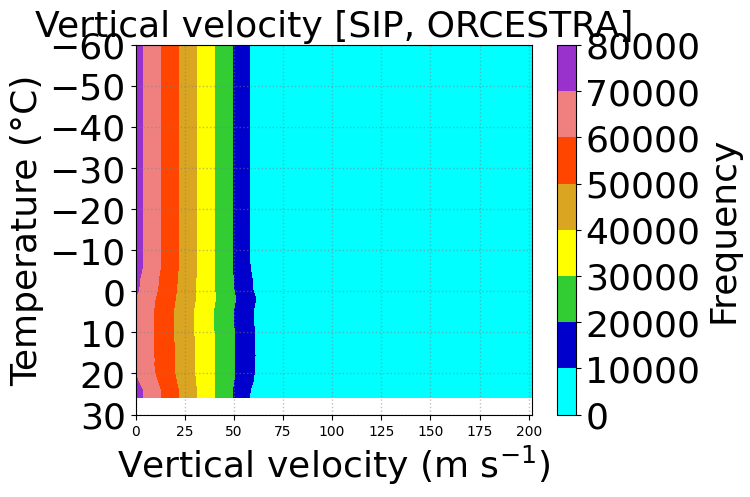

In [386]:

contour = plt.contourf(cdnc_sip_bins[:-1], tempc_avg, cfad_cdnc_sip.T,  cmap=cmap)  
#plt.xlim(-10, 5)
#plt.xticks([-3, -2, -1, 0., 1, 2, 3], rotation=rotation, fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Vertical velocity [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)


In [ ]:

plt.plot(ds_nosip.cdnc_percm3.mean(dim=('time','ncells')), ds_nosip.tempc.mean(dim=('time','ncells')))
plt.ylim(30,-60)

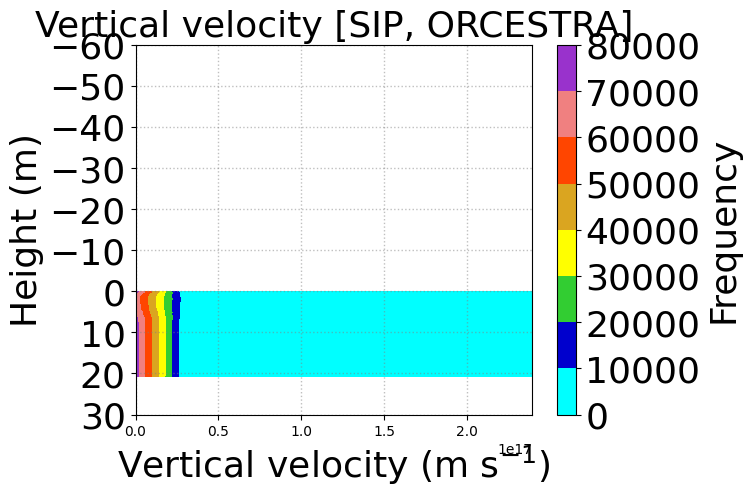

In [370]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr

cdnc_sip = ds_sip['cdnc_percm3']
cdnc_sip_filt = xr.where(ds_sip.cdnc_percm3 > 0., ds_sip.cdnc_percm3, np.nan)

# Create bins for cdnc_sip
cdnc_sip_bins = np.linspace(ds_sip.cdnc_percm3.min().values, ds_sip.cdnc_percm3.max().values, 10)
cfad_cdnc_sip = np.zeros((len(cdnc_sip_bins) - 1, len(ht_avg)))

# Convert to numpy for easier manipulation
cdnc_sip_values = ds_sip.cdnc_percm3.values

# Loop through each bin of CDNC
for i in range(len(cdnc_sip_bins) - 1):
    # Create a mask for CDNC values within the current bin
    mask = (cdnc_sip_values >= cdnc_sip_bins[i]) & (cdnc_sip_values < cdnc_sip_bins[i + 1])
    
    # Sum over the time and ncells axes for each height, and normalize by time length
    cfad_cdnc_sip[i, :] = np.sum(mask, axis=(0, 2)) / len(ds_sip.time)

# Create the plot
contour = plt.contourf(cdnc_sip_bins[:-1], ht_avg, cfad_cdnc_sip.T, cmap=cmap)
plt.ylim(30, -60.)  # adjust y-axis limits
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Height (m)', fontsize=fontsize)  # Assuming you want 'Height' on the y-axis
cbar = plt.colorbar(contour, label='Frequency', orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Vertical velocity [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)

# Show the plot
plt.show()


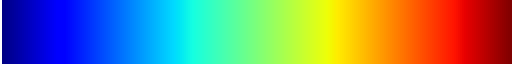

In [123]:
cmap_new

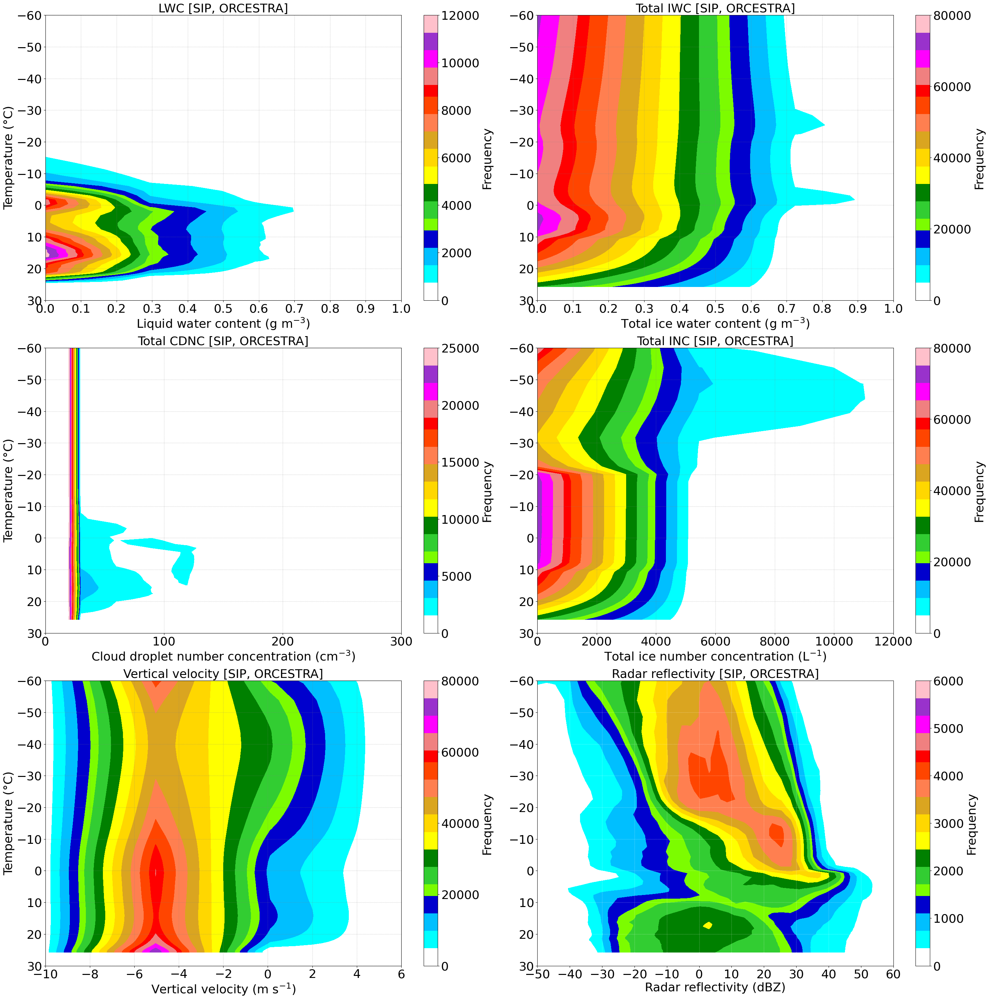

In [364]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

#cmap = plt.cm.jet
#cmap_new = mcolors.ListedColormap(['white'] + [cmap(i) for i in range(1, cmap.N)])

fontsize = 26.;
linewidth = 1.
rotation=0
#cmap = mcolors.ListedColormap(['white', 'blue', 'green', 'yellow', 'red', 'purple'])
lev_lwc = np.linspace(0., 12000, 50)
lev_tiwc = np.linspace(0., 80000, 50)
lev_cdnc = np.linspace(0., 25000, 50)
lev_tinc = np.linspace(0., 80000, 50)
lev_wvel = np.linspace(0., 80000, 50)
lev_refl = np.linspace(0., 6000, 50)

#cfad[cfad < 0.0005]=np.nan

colors = ['white', 'cyan', 'deepskyblue', 'mediumblue', 'lawngreen', 'limegreen', 'green', 'yellow', 'gold', 'goldenrod', 
          'coral', 'orangered', 'red', 'lightcoral', 'magenta', 'darkorchid', 'pink']

cmap = ListedColormap(colors)

plt.figure(figsize=(30, 30))
plt.subplot(3, 2, 1)
contour = plt.contourf(lwc_sip_bins[:-1], tempc_avg, cfad_lwc_sip.T, vmin=0, vmax=12000, levels=lev_lwc, cmap=cmap)  
#plt.xscale('log')
#plt.xlim(1.e-3, 1.e0)
#plt.xticks([1.e-3, 1.e-2, 1.e-1, 1.e0], fontsize=fontsize)
plt.xlim(0, 1.)
plt.xticks([0., 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0], fontsize=fontsize)

plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 2000, 4000, 6000, 8000, 10000, 12000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('LWC [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)

plt.subplot(3, 2, 2)
contour = plt.contourf(tiwc_sip_bins[:-1], tempc_avg, cfad_tiwc_sip.T, vmin=0, vmax=80000, levels=lev_tiwc, cmap=cmap)  
plt.xlim(0, 1.)
plt.xticks([0., 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0], fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Total ice water content (g m$^{-3}$)', fontsize=fontsize)
#plt.ylabel('Height (km)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 20000, 40000, 60000, 80000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Total IWC [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)

plt.subplot(3, 2, 3)
contour = plt.contourf(cdnc_sip_bins[:-1], tempc_avg, cfad_cdnc_sip.T, vmin=0, vmax=25000, levels=lev_cdnc, cmap=cmap)  
#plt.xscale('log')
plt.xlim(0., 300)
plt.xticks([0, 100, 200, 300], fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Cloud droplet number concentration (cm$^{-3}$)', fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 5000, 10000, 15000, 20000, 25000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Total CDNC [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)


plt.subplot(3, 2, 4)
contour = plt.contourf(tinc_sip_bins[:-1], tempc_avg, cfad_tinc_sip.T, vmin=0, vmax=80000, levels=lev_tinc, cmap=cmap)  
#plt.xscale('log')
#plt.xlim(1.e-12, 1.e4)
plt.xlim(0., 12000)
plt.xticks([0, 2.e3, 4.e3, 6.e3, 8.e3, 1.e4, 1.2e4], fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
#plt.ylabel('Height (km)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 20000, 40000, 60000, 80000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Total INC [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)


plt.subplot(3, 2, 5)
contour = plt.contourf(wvel_sip_bins[:-1], tempc_avg, cfad_wvel_sip.T, vmin=0., vmax=80000, levels=lev_wvel, cmap=cmap)  
plt.xlim(-10, 6)
plt.xticks([-10, -8, -6, -4, -2, 0., 2, 4, 6], rotation=rotation, fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 20000, 40000, 60000, 80000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Vertical velocity [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)

plt.subplot(3, 2, 6)
contour = plt.contourf(refl_sip_bins[:-1], tempc_avg, cfad_refl_sip.T, vmin=0, vmax=6000, levels=lev_refl, cmap=cmap)  
plt.xlim(-50, 60)
plt.xticks([-50, -40, -30, -20, -10, 0, 10, 20, 30, 40, 50, 60], rotation=rotation, fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Radar reflectivity (dBZ)', fontsize=fontsize)
#plt.ylabel('Height (km)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 1000, 2000, 3000, 4000, 5000, 6000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Radar reflectivity [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='white', linewidth=linewidth, alpha=0.5)
plt.tight_layout()
plt.show()

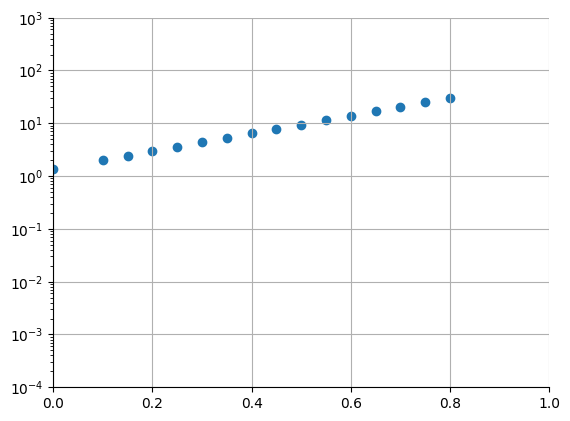

In [4]:
def inp_demott_2003(ss_i):
    inp_demott_2003 = (12.96*(ss_i-0.1))
    #inp_demott_2003 = (1.*2./0.76)* (np.exp(inp_demott_2003))**0.3
    inp_demott_2003 = (1.*2.)* (np.exp(inp_demott_2003))**0.3
    return inp_demott_2003

#ss_i = [-0.25, -0.2, -0.15, -0.1, -0.05, 0., 0.05, 0.1, 0.15, 0.2]
ss_i = [0., 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8]
#ss_i = [-25., -20., -15., -10., -5., 0., 5., 10., 15., 20.]
ss_i = np.array(ss_i)

plt.scatter(ss_i, inp_demott_2003(ss_i))
plt.yscale('log')
plt.ylim(0.0001, 1000)
plt.xlim(0.,1.0)
plt.grid(True)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)